# **Trabajo final Master Ciencia de Datos**

Autor: **Ricardo García Ruiz**

Universidad Alcalá de Henares
Fecha: 12/01/2020
---



# **Objetivo general del trabajo**

El reconocimiento de objetos en imágenes es un tema apasionante que se encuentra en primera línea de trabajo tanto desde el punto de vista de la investigación académica como desde el punto de vista de la innovación tecnológica. Dentro de este área, una de las más complejas técnicas de reconocimiento se encuentra en la restauración de imágenes dañadas.

Aplicando técnicas de Deep Learning, mediante redes neuronales, convolucionales, u otras técnicas se han desarrollado métodos de reconocimiento facial tan eficientes como los que podemos ver en algunos dispositivos móviles. 
En este trabajo se aplicarán estas novedosas técnicas dirigiéndolas al estudio y caracterización de imágenes de moda. Este campo resulta ser uno en el que no se ha desarrollado eficientemente estas técnicas de reconocimiento y restauración de objetos imágenes y creemos que puede ser un excelente campo de aplicación práctica desde el punto de vista de la innovación.

Se emplean técnicas de redes neuronales, modelos convolucionales, que se aplican en un piloto a un dataset de Fashion Week, un conjunto de datos de la moda más relevante y uno los eventos más importantes de la moda actual.
Los resultados nos permiten reconocer objetos determinados dentro de las imágenes y, en definitiva, clasificar las imágenes en función del reconocimiento de los objetos y de su nivel de daño antes de la restauración, sin necesidad de tener una referencia de clase preestablecida para cada imagen.
Entendemos que estos resultados van a ser muy importantes en los aspectos de innovación sostenible en procesos de tratamiento de imágenes en el ámbito de la moda. Estos procesos de innovación creemos que pueden desarrollarse novedosas aplicaciones comerciales derivadas de los resultados de esta investigación y tener un alto impacto en los resultados de comercialización.


# **Verificación de la máquina, código y datos**

Se va a utilizar un notebook de Jupyter subido a la plataforma Google Collab. De esta forma se independiza el resultado y tiempo de proceso de los condicionantes de la máquina instalada en un ordenardor personal o sobremesa.

El notebook tendrá las siguientes características:

*   Utilizará Python 3
*   El notebook utilizará un entorno de ejecución con GPU
*   Utilizará las librerías **Torch**

A continuación se verifican las instalaciones correctas de cada requerimiento.




## ***Verificación de contexto***

In [1]:
# Se verifica la instalación de CUDA y Python 3
! nvcc --version
! python --version


nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2018 NVIDIA Corporation
Built on Sat_Aug_25_21:08:01_CDT_2018
Cuda compilation tools, release 10.0, V10.0.130
Python 3.6.9


In [2]:
import torch
print(torch.cuda.get_device_name(0))
print(torch.__version__)

import warnings
warnings.filterwarnings("ignore")

Tesla P100-PCIE-16GB
1.3.1


## ***Lectura de código y datos desde GitHub para el procesado de Inpainting***

In [3]:
!pip install torchviz

# Se descargan los datos clonando desde 
! git clone https://github.com/rgarciarui/TFM_UAH_RGR.git

#from google.colab import files
#uploaded = files.upload()

     |████████████████████████████████| 51kB 3.6MB/s 
  Created wheel for torchviz: filename=torchviz-0.0.1-cp36-none-any.whl size=3520 sha256=eed5fdf2b80868db3eb59aca2ba0ea5f11abc0dd455040177b4d090f1c38af29
  Stored in directory: /root/.cache/pip/wheels/2a/c2/c5/b8b4d0f7992c735f6db5bfa3c5f354cf36502037ca2b585667
Successfully built torchviz
Cloning into 'TFM_UAH_RGR'...
remote: Enumerating objects: 154, done.
remote: Counting objects: 100% (154/154), done.
remote: Compressing objects: 100% (108/108), done.
remote: Total 154 (delta 84), reused 115 (delta 45), pack-reused 0
Receiving objects: 100% (154/154), 4.04 MiB | 8.78 MiB/s, done.
Resolving deltas: 100% (84/84), done.


# **Restauración**

## **Carga de las librerías de uso en la prueba**

In [0]:
from __future__ import print_function
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline

import os
import numpy as np
from TFM_UAH_RGR.models.resnet import ResNet
from TFM_UAH_RGR.models.unet import UNet
from TFM_UAH_RGR.models.skip import skip
from TFM_UAH_RGR.models import get_net

# Se importan las librerias de torch
import torch
import torch.optim
from skimage.measure import compare_psnr

# Librerias de utilizadas para inpainting
from TFM_UAH_RGR.utils.inpainting_utils import *

# Visualización de modelos
from TFM_UAH_RGR.utils.common_utils import torch_summarize

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = True

PLOT = True
imagesize = -1
dim_div_by = 64
dtype = torch.cuda.FloatTensor

inline_rc = dict(mpl.rcParams)

## ***Prueba con imágenes en color***

En este punto generamos una prueba con una imagen en colar.

Para ello generamos una mascara noise que fusionamos con la imagen original para distorsionarla.

En el resultado mostramos la imagen original, la mascara y la mezcla de imagen y mascara.

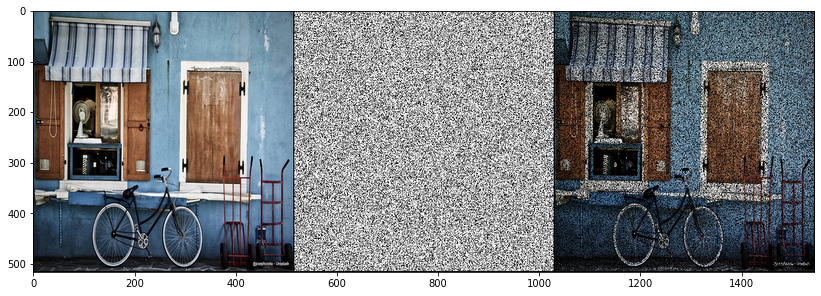

CPU times: user 4.02 s, sys: 919 ms, total: 4.94 s
Wall time: 11 s


In [5]:
%%time
# Cargamos imágenes del conjunto de dataset, en 'data' para trabajar
colourFiles = ['./TFM_UAH_RGR/data/restoration/10 - Bicycle.png',
               './TFM_UAH_RGR/data/restoration/11 - kate.png',
               './TFM_UAH_RGR/data/restoration/12 - Lion.png',
               './TFM_UAH_RGR/data/restoration/13 - tinajas.png',
               './TFM_UAH_RGR/data/restoration/14 - Peabody-library.png']

# selección de la imagen  [0-4]
image_number = 0

# leemos la imagen original deseada
image_pil, image_np = get_image(colourFiles[image_number], imagesize)

# creamos una mascara PIL
image_mask = get_bernoulli_mask(image_pil, 0.35)

# conversion de PIL a matriz numpy
image_mask_np = pil_to_np(image_mask)
image_mask_np[1] = image_mask_np[0]
image_mask_np[2] = image_mask_np[0]
   
# Imagen alterada con la mascara
image_masked = image_np * image_mask_np

# tensor cuda
mask_var = np_to_torch(image_mask_np).type(dtype)

# Mostramos la imagen original, la mascara de ruido y la imagen final con ruido
plot_image_grid([image_np, image_mask_np, image_masked], 3,11);

In [0]:
show_every=50
figsize=5
pad = 'reflection' # 'zero'
INPUT = 'noise'
input_depth = 32
OPTIMIZER = 'adam'
OPT_OVER =  'net'

# imagen en color
num_iter = 1000
LR = 0.01
reg_noise_std = 0.00

# devuelve un modelo        
net = skip(input_depth, 
               image_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128],
               num_channels_up   = [16, 32, 64, 128, 128],
               num_channels_skip =    [0, 0, 0, 0, 0],   
               filter_size_down = 3, filter_size_up = 3, filter_skip_size=1,
               upsample_mode='bilinear', 
               downsample_mode='avg',
               need_sigmoid=True, need_bias=True, pad=pad).type(dtype)

# Perdida
mse = torch.nn.MSELoss().type(dtype)
image_var = np_to_torch(image_np).type(dtype)  # tensor cuda

# tensor cuda
net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype).detach()

In [7]:
# Datos del modelo
print(torch_summarize(net))

# Datos del modelo 2
#print(net)  # modelo
#print("Parametros del modelo: ", sum([param.nelement() for param in net.parameters()]) )  # parametros del modelo

Sequential (
  (1): Sequential (
    (1): Sequential (
      (0): ReflectionPad2d((1, 1, 1, 1)), pesos=(), parametros=0
      (1): Conv2d(32, 16, kernel_size=(3, 3), stride=(1, 1)), pesos=((16, 32, 3, 3), (16,)), parametros=4624
      (2): AvgPool2d(kernel_size=2, stride=2, padding=0), pesos=(), parametros=0
    ), pesos=((16, 32, 3, 3), (16,)), parametros=4624
    (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), pesos=((16,), (16,)), parametros=32
    (3): LeakyReLU(negative_slope=0.2, inplace=True), pesos=(), parametros=0
    (4): Sequential (
      (0): ReflectionPad2d((1, 1, 1, 1)), pesos=(), parametros=0
      (1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1)), pesos=((16, 16, 3, 3), (16,)), parametros=2320
    ), pesos=((16, 16, 3, 3), (16,)), parametros=2320
    (5): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), pesos=((16,), (16,)), parametros=32
    (6): LeakyReLU(negative_slope=0.2, inplace=True), pes

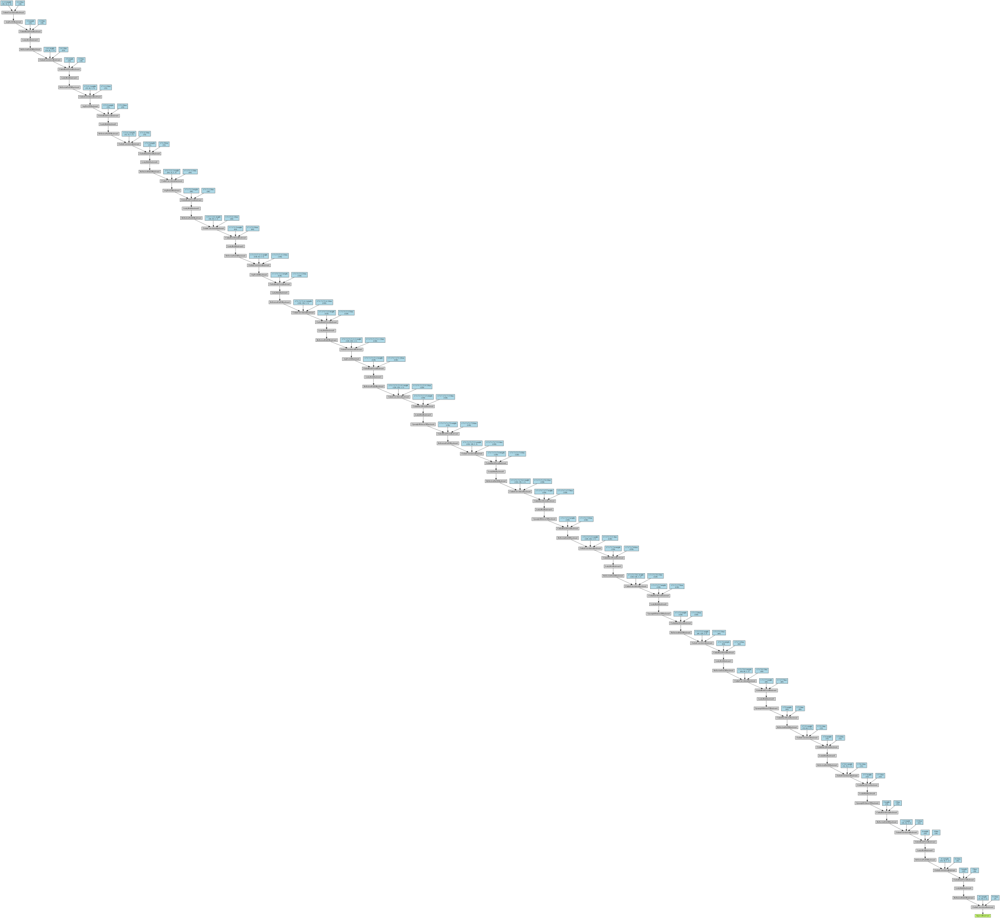

In [8]:
from torch import nn
from torchviz import make_dot, make_dot_from_trace

# Visualizacion grafica del modelo
make_dot(net(net_input), params=dict(net.named_parameters()))

In [0]:
def closure():

    global i, psrn_masked_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)

    total_loss = mse(out * mask_var, image_var * mask_var)
    total_loss.backward()
    
    psrn_masked = compare_psnr(image_masked, out.detach().cpu().numpy()[0] * image_mask_np) 
    psrn = compare_psnr(image_np, out.detach().cpu().numpy()[0]) 

    print ('Iteracion %05d    Perdida %f PSNR_masked %f PSNR %f' % (i, total_loss.item(), psrn_masked, psrn),'\r', end='')
    print('\n')
    #print(total_loss)
    
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        
        # Backtracking
        if psrn_masked - psrn_masked_last < -5: 
            print('Volviendo al punto de control anterior.\n')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.cpu() for x in net.parameters()]
            psrn_masked_last = psrn_masked



        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)

    i += 1

    #print("salida de función con perdida:", (total_loss.cpu()).detach().numpy())
    return total_loss, total_loss.item(), psrn, psrn_masked

relación pico señal / ruido (PSNR) = psrn

error cuadrático medio (MSE) = total_loss

Iniciando la optimización con ADAM Ricardo
Iteracion 00000    Perdida 0.044026 PSNR_masked 13.562949 PSNR 11.687335 



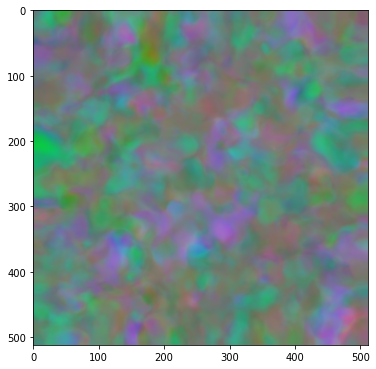

Iteracion 00001    Perdida 0.041344 PSNR_masked 13.835869 PSNR 11.963527 

Iteracion 00002    Perdida 0.041563 PSNR_masked 13.812956 PSNR 11.944585 

Iteracion 00003    Perdida 0.039631 PSNR_masked 14.019643 PSNR 12.146273 

Iteracion 00004    Perdida 0.037578 PSNR_masked 14.250670 PSNR 12.374307 

Iteracion 00005    Perdida 0.036576 PSNR_masked 14.368068 PSNR 12.491419 

Iteracion 00006    Perdida 0.035276 PSNR_masked 14.525227 PSNR 12.649150 

Iteracion 00007    Perdida 0.034079 PSNR_masked 14.675080 PSNR 12.799561 

Iteracion 00008    Perdida 0.032601 PSNR_masked 14.867650 PSNR 12.991744 

Iteracion 00009    Perdida 0.030986 PSNR_masked 15.088379 PSNR 13.211821 

Iteracion 00010    Perdida 0.028982 PSNR_masked 15.378754 PSNR 13.502006 

Iteracion 00011    Perdida 0.027353 PSNR_masked 15.629885 PSNR 13.754266 

Iteracion 00012    Perdida 0.025871 PSNR_masked 15.871948 PSNR 13.997233 

Iteracion 00013    Perdida 0.024668 PSNR_masked 16.078590 PSNR 14.201709 

Iteracion 00014    Perdid

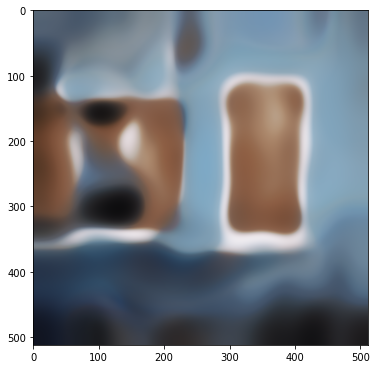

Iteracion 00051    Perdida 0.014445 PSNR_masked 18.402807 PSNR 16.528525 

Iteracion 00052    Perdida 0.014371 PSNR_masked 18.425241 PSNR 16.545954 

Iteracion 00053    Perdida 0.014565 PSNR_masked 18.366959 PSNR 16.489090 

Iteracion 00054    Perdida 0.014494 PSNR_masked 18.388081 PSNR 16.510348 

Iteracion 00055    Perdida 0.014358 PSNR_masked 18.429014 PSNR 16.550872 

Iteracion 00056    Perdida 0.014282 PSNR_masked 18.451975 PSNR 16.575060 

Iteracion 00057    Perdida 0.014104 PSNR_masked 18.506603 PSNR 16.631797 

Iteracion 00058    Perdida 0.014105 PSNR_masked 18.506158 PSNR 16.633391 

Iteracion 00059    Perdida 0.014316 PSNR_masked 18.441659 PSNR 16.560405 

Iteracion 00060    Perdida 0.014121 PSNR_masked 18.501321 PSNR 16.623112 

Iteracion 00061    Perdida 0.014061 PSNR_masked 18.519728 PSNR 16.639314 

Iteracion 00062    Perdida 0.013728 PSNR_masked 18.624015 PSNR 16.744868 

Iteracion 00063    Perdida 0.013599 PSNR_masked 18.665013 PSNR 16.787617 

Iteracion 00064    Perdid

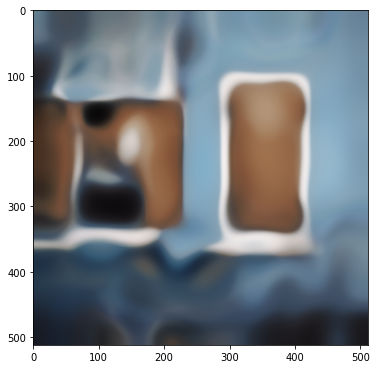

Iteracion 00101    Perdida 0.012753 PSNR_masked 18.944030 PSNR 17.065635 

Iteracion 00102    Perdida 0.012603 PSNR_masked 18.995116 PSNR 17.118643 

Iteracion 00103    Perdida 0.012595 PSNR_masked 18.998075 PSNR 17.109275 

Iteracion 00104    Perdida 0.012394 PSNR_masked 19.067756 PSNR 17.182452 

Iteracion 00105    Perdida 0.012369 PSNR_masked 19.076488 PSNR 17.198840 

Iteracion 00106    Perdida 0.012334 PSNR_masked 19.088926 PSNR 17.205770 

Iteracion 00107    Perdida 0.012387 PSNR_masked 19.070442 PSNR 17.191380 

Iteracion 00108    Perdida 0.013221 PSNR_masked 18.787476 PSNR 16.893614 

Iteracion 00109    Perdida 0.013459 PSNR_masked 18.709993 PSNR 16.833770 

Iteracion 00110    Perdida 0.012853 PSNR_masked 18.909874 PSNR 17.019978 

Iteracion 00111    Perdida 0.012605 PSNR_masked 18.994450 PSNR 17.108274 

Iteracion 00112    Perdida 0.012552 PSNR_masked 19.013030 PSNR 17.130911 

Iteracion 00113    Perdida 0.012419 PSNR_masked 19.059282 PSNR 17.173757 

Iteracion 00114    Perdid

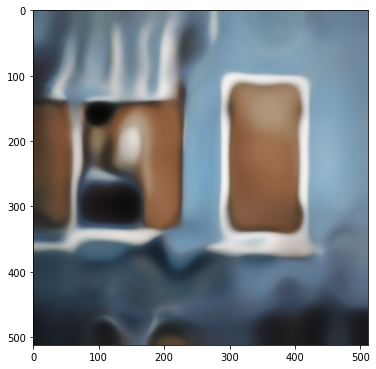

Iteracion 00151    Perdida 0.011342 PSNR_masked 19.453228 PSNR 17.565495 

Iteracion 00152    Perdida 0.011355 PSNR_masked 19.448260 PSNR 17.565409 

Iteracion 00153    Perdida 0.011069 PSNR_masked 19.558938 PSNR 17.675264 

Iteracion 00154    Perdida 0.011035 PSNR_masked 19.572239 PSNR 17.684574 

Iteracion 00155    Perdida 0.010951 PSNR_masked 19.605285 PSNR 17.715324 

Iteracion 00156    Perdida 0.010910 PSNR_masked 19.621825 PSNR 17.724734 

Iteracion 00157    Perdida 0.010887 PSNR_masked 19.630787 PSNR 17.743546 

Iteracion 00158    Perdida 0.010905 PSNR_masked 19.623762 PSNR 17.744659 

Iteracion 00159    Perdida 0.010856 PSNR_masked 19.643173 PSNR 17.752835 

Iteracion 00160    Perdida 0.010954 PSNR_masked 19.604147 PSNR 17.713031 

Iteracion 00161    Perdida 0.010725 PSNR_masked 19.696081 PSNR 17.803115 

Iteracion 00162    Perdida 0.010549 PSNR_masked 19.767957 PSNR 17.873981 

Iteracion 00163    Perdida 0.010413 PSNR_masked 19.824250 PSNR 17.926801 

Iteracion 00164    Perdid

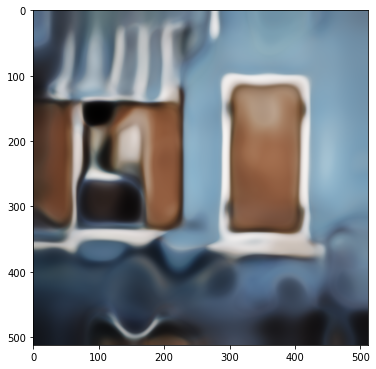

Iteracion 00201    Perdida 0.009838 PSNR_masked 20.070816 PSNR 18.171960 

Iteracion 00202    Perdida 0.010047 PSNR_masked 19.979476 PSNR 18.094191 

Iteracion 00203    Perdida 0.010128 PSNR_masked 19.944616 PSNR 18.053997 

Iteracion 00204    Perdida 0.011020 PSNR_masked 19.578274 PSNR 17.674062 

Iteracion 00205    Perdida 0.011307 PSNR_masked 19.466487 PSNR 17.568261 

Iteracion 00206    Perdida 0.011021 PSNR_masked 19.577919 PSNR 17.675392 

Iteracion 00207    Perdida 0.010142 PSNR_masked 19.938854 PSNR 18.040546 

Iteracion 00208    Perdida 0.011026 PSNR_masked 19.575649 PSNR 17.688369 

Iteracion 00209    Perdida 0.010414 PSNR_masked 19.823945 PSNR 17.928305 

Iteracion 00210    Perdida 0.010314 PSNR_masked 19.865709 PSNR 17.965606 

Iteracion 00211    Perdida 0.010393 PSNR_masked 19.832481 PSNR 17.944266 

Iteracion 00212    Perdida 0.010010 PSNR_masked 19.995541 PSNR 18.100038 

Iteracion 00213    Perdida 0.009888 PSNR_masked 20.049014 PSNR 18.152930 

Iteracion 00214    Perdid

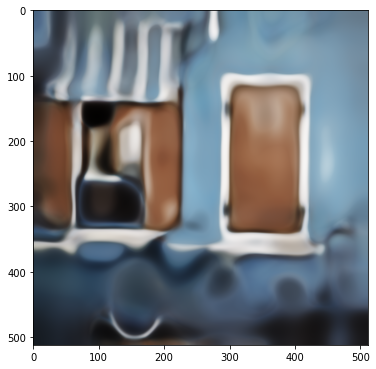

Iteracion 00251    Perdida 0.009620 PSNR_masked 20.168366 PSNR 18.272262 

Iteracion 00252    Perdida 0.009699 PSNR_masked 20.132890 PSNR 18.232684 

Iteracion 00253    Perdida 0.009442 PSNR_masked 20.249162 PSNR 18.345900 

Iteracion 00254    Perdida 0.009213 PSNR_masked 20.355981 PSNR 18.460840 

Iteracion 00255    Perdida 0.009102 PSNR_masked 20.408855 PSNR 18.516027 

Iteracion 00256    Perdida 0.009064 PSNR_masked 20.426816 PSNR 18.532983 

Iteracion 00257    Perdida 0.009139 PSNR_masked 20.391203 PSNR 18.489125 

Iteracion 00258    Perdida 0.009222 PSNR_masked 20.351567 PSNR 18.446739 

Iteracion 00259    Perdida 0.008821 PSNR_masked 20.544942 PSNR 18.644886 

Iteracion 00260    Perdida 0.008956 PSNR_masked 20.478738 PSNR 18.578219 

Iteracion 00261    Perdida 0.009135 PSNR_masked 20.392699 PSNR 18.490680 

Iteracion 00262    Perdida 0.008954 PSNR_masked 20.479961 PSNR 18.585470 

Iteracion 00263    Perdida 0.009074 PSNR_masked 20.421831 PSNR 18.518958 

Iteracion 00264    Perdid

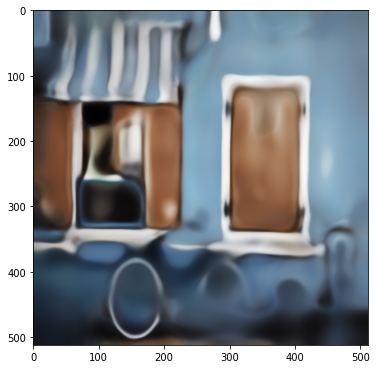

Iteracion 00301    Perdida 0.008770 PSNR_masked 20.569882 PSNR 18.674476 

Iteracion 00302    Perdida 0.009317 PSNR_masked 20.307103 PSNR 18.408432 

Iteracion 00303    Perdida 0.008867 PSNR_masked 20.522119 PSNR 18.625638 

Iteracion 00304    Perdida 0.008616 PSNR_masked 20.647160 PSNR 18.735871 

Iteracion 00305    Perdida 0.008514 PSNR_masked 20.698800 PSNR 18.791998 

Iteracion 00306    Perdida 0.008631 PSNR_masked 20.639329 PSNR 18.747984 

Iteracion 00307    Perdida 0.008454 PSNR_masked 20.729522 PSNR 18.828150 

Iteracion 00308    Perdida 0.008363 PSNR_masked 20.776191 PSNR 18.870956 

Iteracion 00309    Perdida 0.008152 PSNR_masked 20.887294 PSNR 18.991692 

Iteracion 00310    Perdida 0.008193 PSNR_masked 20.865611 PSNR 18.967426 

Iteracion 00311    Perdida 0.008150 PSNR_masked 20.888646 PSNR 18.985316 

Iteracion 00312    Perdida 0.008207 PSNR_masked 20.857897 PSNR 18.964765 

Iteracion 00313    Perdida 0.008028 PSNR_masked 20.953939 PSNR 19.046941 

Iteracion 00314    Perdid

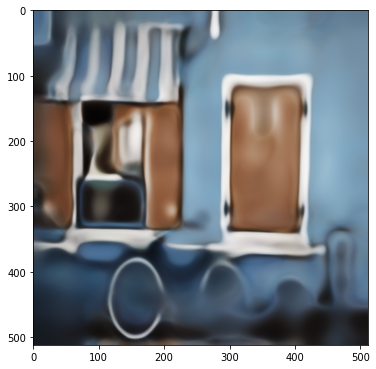

Iteracion 00351    Perdida 0.007888 PSNR_masked 21.030339 PSNR 19.121676 

Iteracion 00352    Perdida 0.007760 PSNR_masked 21.101360 PSNR 19.195830 

Iteracion 00353    Perdida 0.007833 PSNR_masked 21.060942 PSNR 19.153365 

Iteracion 00354    Perdida 0.008076 PSNR_masked 20.927940 PSNR 19.020705 

Iteracion 00355    Perdida 0.007844 PSNR_masked 21.054670 PSNR 19.152946 

Iteracion 00356    Perdida 0.007865 PSNR_masked 21.042813 PSNR 19.138480 

Iteracion 00357    Perdida 0.007842 PSNR_masked 21.055971 PSNR 19.146178 

Iteracion 00358    Perdida 0.007814 PSNR_masked 21.071437 PSNR 19.170755 

Iteracion 00359    Perdida 0.007824 PSNR_masked 21.065899 PSNR 19.158955 

Iteracion 00360    Perdida 0.008100 PSNR_masked 20.914926 PSNR 19.009151 

Iteracion 00361    Perdida 0.008473 PSNR_masked 20.719733 PSNR 18.819330 

Iteracion 00362    Perdida 0.007834 PSNR_masked 21.060343 PSNR 19.154246 

Iteracion 00363    Perdida 0.008062 PSNR_masked 20.935308 PSNR 19.035740 

Iteracion 00364    Perdid

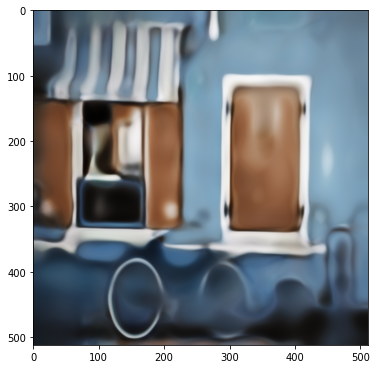

Iteracion 00401    Perdida 0.007168 PSNR_masked 21.445907 PSNR 19.528665 

Iteracion 00402    Perdida 0.007453 PSNR_masked 21.276657 PSNR 19.360719 

Iteracion 00403    Perdida 0.007791 PSNR_masked 21.084193 PSNR 19.182283 

Iteracion 00404    Perdida 0.007531 PSNR_masked 21.231249 PSNR 19.323577 

Iteracion 00405    Perdida 0.007299 PSNR_masked 21.367336 PSNR 19.447138 

Iteracion 00406    Perdida 0.007417 PSNR_masked 21.297606 PSNR 19.387120 

Iteracion 00407    Perdida 0.007449 PSNR_masked 21.278867 PSNR 19.383924 

Iteracion 00408    Perdida 0.007167 PSNR_masked 21.446705 PSNR 19.528086 

Iteracion 00409    Perdida 0.007271 PSNR_masked 21.383762 PSNR 19.453901 

Iteracion 00410    Perdida 0.007398 PSNR_masked 21.308584 PSNR 19.396156 

Iteracion 00411    Perdida 0.007588 PSNR_masked 21.198909 PSNR 19.289871 

Iteracion 00412    Perdida 0.007635 PSNR_masked 21.171801 PSNR 19.259578 

Iteracion 00413    Perdida 0.007054 PSNR_masked 21.515596 PSNR 19.591361 

Iteracion 00414    Perdid

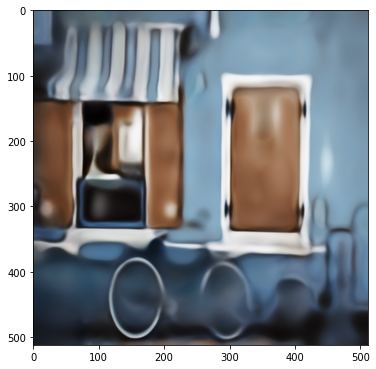

Iteracion 00451    Perdida 0.006715 PSNR_masked 21.729560 PSNR 19.809282 

Iteracion 00452    Perdida 0.006604 PSNR_masked 21.801838 PSNR 19.883381 

Iteracion 00453    Perdida 0.006683 PSNR_masked 21.750587 PSNR 19.842500 

Iteracion 00454    Perdida 0.006933 PSNR_masked 21.590630 PSNR 19.664575 

Iteracion 00455    Perdida 0.006884 PSNR_masked 21.621481 PSNR 19.694347 

Iteracion 00456    Perdida 0.007036 PSNR_masked 21.526576 PSNR 19.607031 

Iteracion 00457    Perdida 0.007073 PSNR_masked 21.503969 PSNR 19.584491 

Iteracion 00458    Perdida 0.006555 PSNR_masked 21.834431 PSNR 19.914039 

Iteracion 00459    Perdida 0.006733 PSNR_masked 21.718023 PSNR 19.812951 

Iteracion 00460    Perdida 0.006763 PSNR_masked 21.698844 PSNR 19.782849 

Iteracion 00461    Perdida 0.006668 PSNR_masked 21.760251 PSNR 19.828032 

Iteracion 00462    Perdida 0.006695 PSNR_masked 21.742307 PSNR 19.830801 

Iteracion 00463    Perdida 0.006704 PSNR_masked 21.736602 PSNR 19.816433 

Iteracion 00464    Perdid

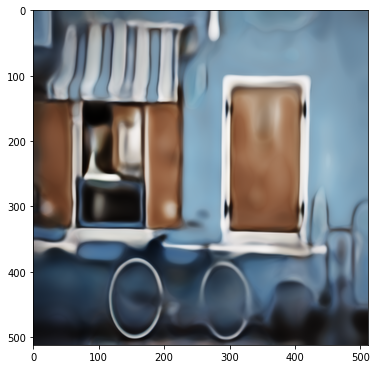

Iteracion 00501    Perdida 0.006306 PSNR_masked 22.002393 PSNR 20.075192 

Iteracion 00502    Perdida 0.006209 PSNR_masked 22.069936 PSNR 20.131967 

Iteracion 00503    Perdida 0.006328 PSNR_masked 21.987398 PSNR 20.069940 

Iteracion 00504    Perdida 0.006254 PSNR_masked 22.038370 PSNR 20.112490 

Iteracion 00505    Perdida 0.006667 PSNR_masked 21.760398 PSNR 19.827525 

Iteracion 00506    Perdida 0.006673 PSNR_masked 21.756931 PSNR 19.853463 

Iteracion 00507    Perdida 0.006438 PSNR_masked 21.912537 PSNR 20.000353 

Iteracion 00508    Perdida 0.006672 PSNR_masked 21.757598 PSNR 19.836129 

Iteracion 00509    Perdida 0.006875 PSNR_masked 21.627073 PSNR 19.711279 

Iteracion 00510    Perdida 0.006327 PSNR_masked 21.988115 PSNR 20.056671 

Iteracion 00511    Perdida 0.006184 PSNR_masked 22.087043 PSNR 20.164756 

Iteracion 00512    Perdida 0.006414 PSNR_masked 21.928608 PSNR 20.011482 

Iteracion 00513    Perdida 0.006175 PSNR_masked 22.093454 PSNR 20.167328 

Iteracion 00514    Perdid

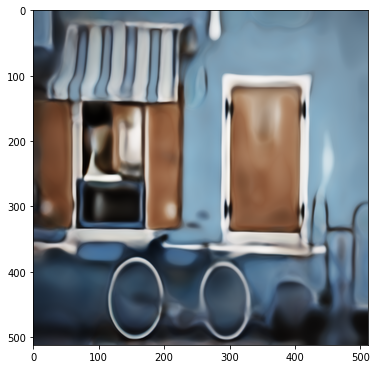

Iteracion 00551    Perdida 0.005684 PSNR_masked 22.453307 PSNR 20.502994 

Iteracion 00552    Perdida 0.005866 PSNR_masked 22.316530 PSNR 20.378964 

Iteracion 00553    Perdida 0.005716 PSNR_masked 22.428934 PSNR 20.486010 

Iteracion 00554    Perdida 0.005629 PSNR_masked 22.496021 PSNR 20.562879 

Iteracion 00555    Perdida 0.005490 PSNR_masked 22.604643 PSNR 20.648891 

Iteracion 00556    Perdida 0.005663 PSNR_masked 22.469677 PSNR 20.525668 

Iteracion 00557    Perdida 0.005964 PSNR_masked 22.244968 PSNR 20.314748 

Iteracion 00558    Perdida 0.006180 PSNR_masked 22.089819 PSNR 20.159461 

Iteracion 00559    Perdida 0.006511 PSNR_masked 21.863463 PSNR 19.930918 

Iteracion 00560    Perdida 0.005997 PSNR_masked 22.220793 PSNR 20.310656 

Iteracion 00561    Perdida 0.005957 PSNR_masked 22.249561 PSNR 20.319812 

Iteracion 00562    Perdida 0.005943 PSNR_masked 22.260059 PSNR 20.325673 

Iteracion 00563    Perdida 0.005716 PSNR_masked 22.429418 PSNR 20.496075 

Iteracion 00564    Perdid

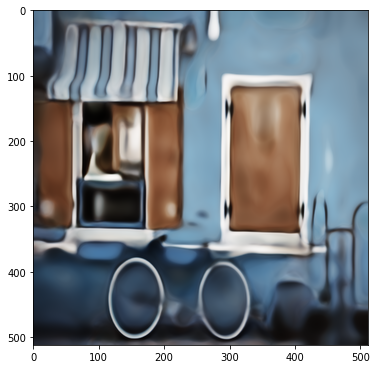

Iteracion 00601    Perdida 0.005662 PSNR_masked 22.470453 PSNR 20.502222 

Iteracion 00602    Perdida 0.005638 PSNR_masked 22.488619 PSNR 20.540464 

Iteracion 00603    Perdida 0.005737 PSNR_masked 22.413413 PSNR 20.469801 

Iteracion 00604    Perdida 0.005536 PSNR_masked 22.568236 PSNR 20.624473 

Iteracion 00605    Perdida 0.005228 PSNR_masked 22.816441 PSNR 20.859754 

Iteracion 00606    Perdida 0.005358 PSNR_masked 22.710287 PSNR 20.762887 

Iteracion 00607    Perdida 0.005282 PSNR_masked 22.772285 PSNR 20.831843 

Iteracion 00608    Perdida 0.005174 PSNR_masked 22.861362 PSNR 20.899184 

Iteracion 00609    Perdida 0.005123 PSNR_masked 22.905156 PSNR 20.953099 

Iteracion 00610    Perdida 0.005049 PSNR_masked 22.968129 PSNR 21.016408 

Iteracion 00611    Perdida 0.005100 PSNR_masked 22.924022 PSNR 20.972965 

Iteracion 00612    Perdida 0.005214 PSNR_masked 22.828701 PSNR 20.878605 

Iteracion 00613    Perdida 0.005413 PSNR_masked 22.665568 PSNR 20.700586 

Iteracion 00614    Perdid

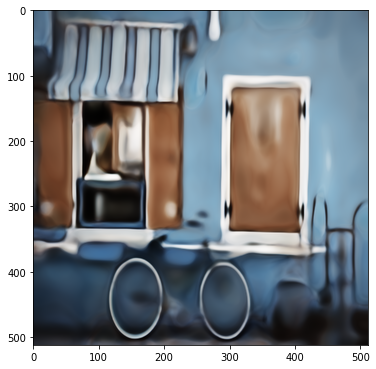

Iteracion 00651    Perdida 0.004907 PSNR_masked 23.091981 PSNR 21.144966 

Iteracion 00652    Perdida 0.005114 PSNR_masked 22.912506 PSNR 20.962634 

Iteracion 00653    Perdida 0.005141 PSNR_masked 22.889231 PSNR 20.928913 

Iteracion 00654    Perdida 0.005098 PSNR_masked 22.925898 PSNR 20.971311 

Iteracion 00655    Perdida 0.004910 PSNR_masked 23.089384 PSNR 21.131355 

Iteracion 00656    Perdida 0.005067 PSNR_masked 22.952242 PSNR 20.995380 

Iteracion 00657    Perdida 0.004979 PSNR_masked 23.028404 PSNR 21.066216 

Iteracion 00658    Perdida 0.004658 PSNR_masked 23.318127 PSNR 21.351330 

Iteracion 00659    Perdida 0.004840 PSNR_masked 23.151468 PSNR 21.184286 

Iteracion 00660    Perdida 0.005095 PSNR_masked 22.928147 PSNR 20.966183 

Iteracion 00661    Perdida 0.005289 PSNR_masked 22.766662 PSNR 20.798795 

Iteracion 00662    Perdida 0.005362 PSNR_masked 22.706805 PSNR 20.758968 

Iteracion 00663    Perdida 0.005698 PSNR_masked 22.442640 PSNR 20.491350 

Iteracion 00664    Perdid

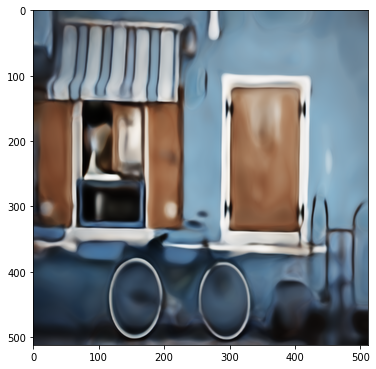

Iteracion 00701    Perdida 0.004766 PSNR_masked 23.218526 PSNR 21.262015 

Iteracion 00702    Perdida 0.004543 PSNR_masked 23.426894 PSNR 21.454501 

Iteracion 00703    Perdida 0.004731 PSNR_masked 23.250190 PSNR 21.285306 

Iteracion 00704    Perdida 0.004754 PSNR_masked 23.229595 PSNR 21.252894 

Iteracion 00705    Perdida 0.004627 PSNR_masked 23.347241 PSNR 21.382200 

Iteracion 00706    Perdida 0.004736 PSNR_masked 23.245833 PSNR 21.277092 

Iteracion 00707    Perdida 0.004529 PSNR_masked 23.439703 PSNR 21.456287 

Iteracion 00708    Perdida 0.004606 PSNR_masked 23.366743 PSNR 21.391188 

Iteracion 00709    Perdida 0.004693 PSNR_masked 23.285758 PSNR 21.324164 

Iteracion 00710    Perdida 0.004476 PSNR_masked 23.491109 PSNR 21.508289 

Iteracion 00711    Perdida 0.004452 PSNR_masked 23.513969 PSNR 21.546467 

Iteracion 00712    Perdida 0.004636 PSNR_masked 23.338567 PSNR 21.371325 

Iteracion 00713    Perdida 0.004440 PSNR_masked 23.526618 PSNR 21.552594 

Iteracion 00714    Perdid

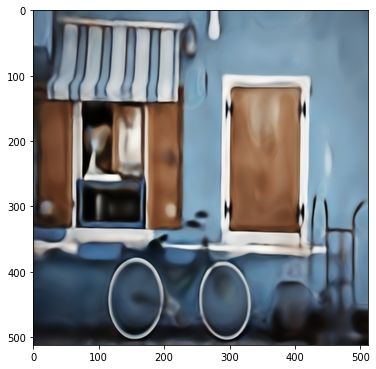

Iteracion 00751    Perdida 0.005190 PSNR_masked 22.848623 PSNR 20.887600 

Iteracion 00752    Perdida 0.005288 PSNR_masked 22.767009 PSNR 20.808828 

Iteracion 00753    Perdida 0.004823 PSNR_masked 23.167151 PSNR 21.201881 

Iteracion 00754    Perdida 0.004770 PSNR_masked 23.215030 PSNR 21.250213 

Iteracion 00755    Perdida 0.004812 PSNR_masked 23.177095 PSNR 21.229613 

Iteracion 00756    Perdida 0.004498 PSNR_masked 23.470107 PSNR 21.494203 

Iteracion 00757    Perdida 0.004645 PSNR_masked 23.329960 PSNR 21.352352 

Iteracion 00758    Perdida 0.004633 PSNR_masked 23.341764 PSNR 21.380432 

Iteracion 00759    Perdida 0.004239 PSNR_masked 23.727219 PSNR 21.747512 

Iteracion 00760    Perdida 0.004466 PSNR_masked 23.500868 PSNR 21.524869 

Iteracion 00761    Perdida 0.004537 PSNR_masked 23.432024 PSNR 21.472122 

Iteracion 00762    Perdida 0.004240 PSNR_masked 23.726600 PSNR 21.743103 

Iteracion 00763    Perdida 0.004460 PSNR_masked 23.506705 PSNR 21.528187 

Iteracion 00764    Perdid

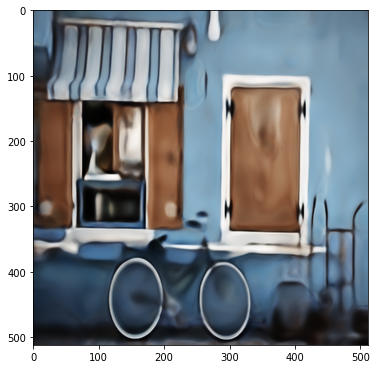

Iteracion 00801    Perdida 0.004159 PSNR_masked 23.810272 PSNR 21.827031 

Iteracion 00802    Perdida 0.003961 PSNR_masked 24.022105 PSNR 22.029726 

Iteracion 00803    Perdida 0.004215 PSNR_masked 23.751948 PSNR 21.760624 

Iteracion 00804    Perdida 0.004154 PSNR_masked 23.815679 PSNR 21.833837 

Iteracion 00805    Perdida 0.004122 PSNR_masked 23.848851 PSNR 21.853623 

Iteracion 00806    Perdida 0.004231 PSNR_masked 23.735893 PSNR 21.746395 

Iteracion 00807    Perdida 0.004369 PSNR_masked 23.596235 PSNR 21.620899 

Iteracion 00808    Perdida 0.004572 PSNR_masked 23.399025 PSNR 21.426508 

Iteracion 00809    Perdida 0.004784 PSNR_masked 23.201784 PSNR 21.227392 

Iteracion 00810    Perdida 0.004387 PSNR_masked 23.578181 PSNR 21.600871 

Iteracion 00811    Perdida 0.004383 PSNR_masked 23.582419 PSNR 21.609015 

Iteracion 00812    Perdida 0.004549 PSNR_masked 23.421177 PSNR 21.446082 

Iteracion 00813    Perdida 0.004397 PSNR_masked 23.568802 PSNR 21.589544 

Iteracion 00814    Perdid

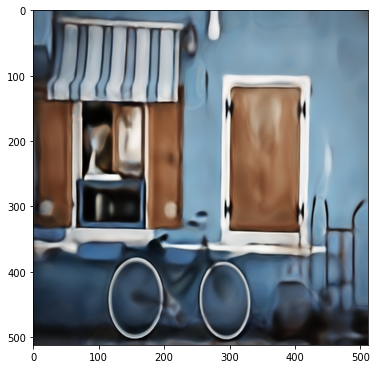

Iteracion 00851    Perdida 0.003814 PSNR_masked 24.185708 PSNR 22.171309 

Iteracion 00852    Perdida 0.003683 PSNR_masked 24.337465 PSNR 22.329373 

Iteracion 00853    Perdida 0.003778 PSNR_masked 24.227431 PSNR 22.237713 

Iteracion 00854    Perdida 0.003725 PSNR_masked 24.288386 PSNR 22.286524 

Iteracion 00855    Perdida 0.003801 PSNR_masked 24.201036 PSNR 22.207519 

Iteracion 00856    Perdida 0.003928 PSNR_masked 24.058139 PSNR 22.065613 

Iteracion 00857    Perdida 0.004290 PSNR_masked 23.675765 PSNR 21.707203 

Iteracion 00858    Perdida 0.004128 PSNR_masked 23.842311 PSNR 21.845228 

Iteracion 00859    Perdida 0.004041 PSNR_masked 23.935250 PSNR 21.952037 

Iteracion 00860    Perdida 0.003916 PSNR_masked 24.071745 PSNR 22.081324 

Iteracion 00861    Perdida 0.004257 PSNR_masked 23.709344 PSNR 21.726258 

Iteracion 00862    Perdida 0.004045 PSNR_masked 23.930703 PSNR 21.940077 

Iteracion 00863    Perdida 0.003847 PSNR_masked 24.148624 PSNR 22.162456 

Iteracion 00864    Perdid

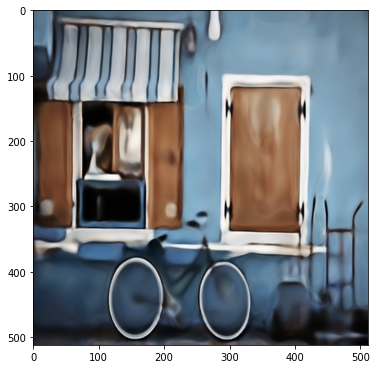

Iteracion 00901    Perdida 0.003980 PSNR_masked 24.001399 PSNR 22.003176 

Iteracion 00902    Perdida 0.004175 PSNR_masked 23.793501 PSNR 21.799892 

Iteracion 00903    Perdida 0.003964 PSNR_masked 24.018753 PSNR 22.025244 

Iteracion 00904    Perdida 0.003931 PSNR_masked 24.054440 PSNR 22.062853 

Iteracion 00905    Perdida 0.003979 PSNR_masked 24.002345 PSNR 22.009276 

Iteracion 00906    Perdida 0.004002 PSNR_masked 23.976973 PSNR 21.991287 

Iteracion 00907    Perdida 0.003983 PSNR_masked 23.998401 PSNR 22.003109 

Iteracion 00908    Perdida 0.003838 PSNR_masked 24.158775 PSNR 22.168826 

Iteracion 00909    Perdida 0.003929 PSNR_masked 24.057334 PSNR 22.072610 

Iteracion 00910    Perdida 0.003931 PSNR_masked 24.054700 PSNR 22.066310 

Iteracion 00911    Perdida 0.003800 PSNR_masked 24.202066 PSNR 22.200848 

Iteracion 00912    Perdida 0.003854 PSNR_masked 24.140484 PSNR 22.140535 

Iteracion 00913    Perdida 0.003891 PSNR_masked 24.099910 PSNR 22.106643 

Iteracion 00914    Perdid

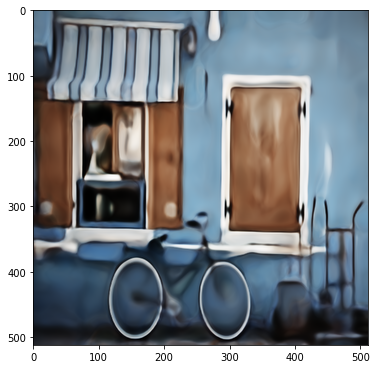

Iteracion 00951    Perdida 0.003536 PSNR_masked 24.514952 PSNR 22.511417 

Iteracion 00952    Perdida 0.003446 PSNR_masked 24.626946 PSNR 22.616561 

Iteracion 00953    Perdida 0.003408 PSNR_masked 24.674413 PSNR 22.661178 

Iteracion 00954    Perdida 0.003437 PSNR_masked 24.637943 PSNR 22.636695 

Iteracion 00955    Perdida 0.003409 PSNR_masked 24.673681 PSNR 22.671320 

Iteracion 00956    Perdida 0.003565 PSNR_masked 24.479740 PSNR 22.471917 

Iteracion 00957    Perdida 0.003527 PSNR_masked 24.526338 PSNR 22.520252 

Iteracion 00958    Perdida 0.003673 PSNR_masked 24.349205 PSNR 22.370355 

Iteracion 00959    Perdida 0.003702 PSNR_masked 24.315518 PSNR 22.317053 

Iteracion 00960    Perdida 0.003659 PSNR_masked 24.366140 PSNR 22.372890 

Iteracion 00961    Perdida 0.003437 PSNR_masked 24.638516 PSNR 22.635705 

Iteracion 00962    Perdida 0.003445 PSNR_masked 24.628619 PSNR 22.618474 

Iteracion 00963    Perdida 0.003691 PSNR_masked 24.329015 PSNR 22.329348 

Iteracion 00964    Perdid

In [10]:
%%time
# Inicialización de variables globales 
last_net = None
psrn_masked_last = 0
i = 0

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

# Run
p = get_params(OPT_OVER, net, net_input)
#total_loss_item_acum, psrn_acum, total_loss_acum = optimize(OPTIMIZER, p, closure, LR=LR, num_iter=num_iter)
total_loss_final, total_loss_item_final, psrn_final, psrn_masked_final = optimize(OPTIMIZER, p, closure, LR=LR, num_iter=num_iter)

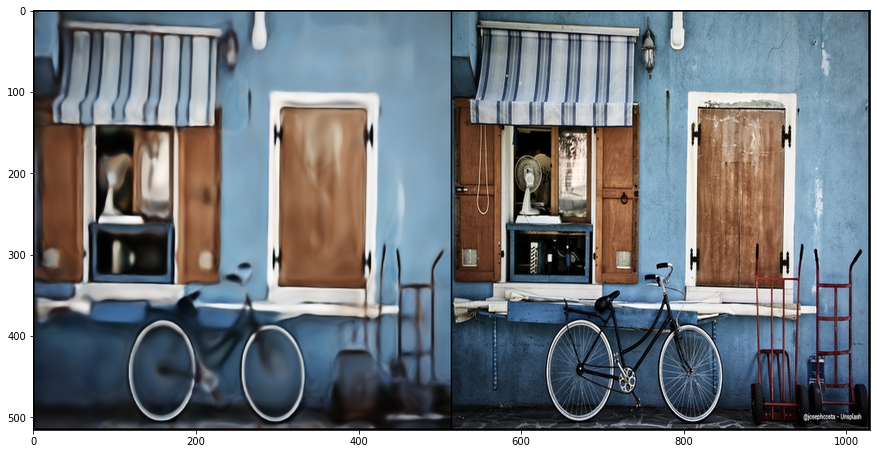

In [11]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), image_np], factor=13);

total_loss_item_final:  0.0035
Relación pico señal / ruido (PSNR):  22.5382
Relación pico señal / ruido (PSNR) [masked]:  24.5510
Error cuadrático medio (MSE):  0.0035 



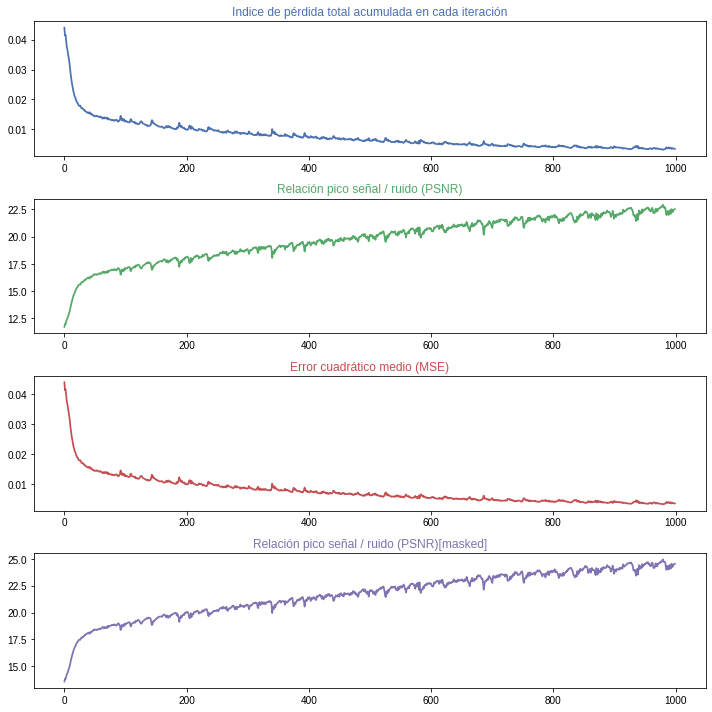

In [13]:

#total_loss_item_final, psrn_final, total_loss_final, psrn_masked_final
print("total_loss_item_final: ", "{0:.4f}".format(total_loss_item_final[len(total_loss_item_final)-1]))
print("Relación pico señal / ruido (PSNR): ", "{0:.4f}".format(psrn_final[len(psrn_final)-1]))
print("Relación pico señal / ruido (PSNR) [masked]: ", "{0:.4f}".format(psrn_masked_final[len(psrn_masked_final)-1]))
print("Error cuadrático medio (MSE): ", "{0:.4f}".format(total_loss_final[len(total_loss_final)-1]), "\n")

fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=4, figsize=(10,10))
mpl.style.use('seaborn')

ax1.set_title('Indice de pérdida total acumulada en cada iteración'.format('seaborn'), color='C0')
ax1.plot(total_loss_item_final, color='C0')

ax2.set_title('Relación pico señal / ruido (PSNR)'.format('seaborn'), color='C1')
ax2.plot(psrn_final, color='C1')

ax3.plot(total_loss_final, color='C2')
ax3.set_title('Error cuadrático medio (MSE)'.format('seaborn'), color='C2')

ax4.set_title('Relación pico señal / ruido (PSNR)[masked]'.format('seaborn'), color='C3')
ax4.plot(psrn_masked_final, color='C3')

plt.tight_layout()
plt.show()
plt.close()

mpl.rcParams.update(inline_rc)

#print(total_loss_final[4900])

## ***Prueba con imágenes en blanco y negro***

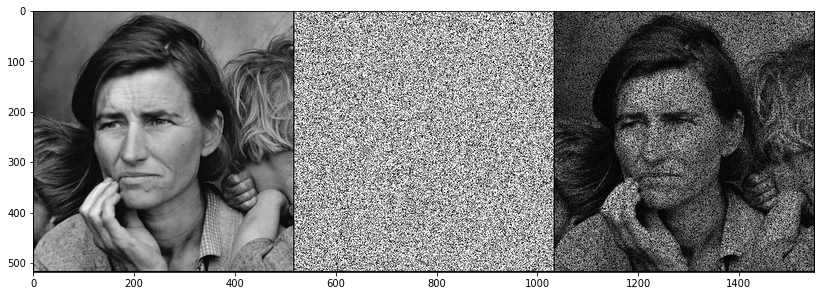

In [14]:
# Cargamos una imagen del conjunto de dataset, en 'data' para trabajar
blackWhiteFiles = ['./TFM_UAH_RGR/data/restoration/00 - barbara.png',
                   './TFM_UAH_RGR/data/restoration/01 - indian.png',
                   './TFM_UAH_RGR/data/restoration/02 - babak.png',
                   './TFM_UAH_RGR/data/restoration/03 - spooky-mansion.png',
                   './TFM_UAH_RGR/data/restoration/04 - madre-migrante.png']

# selección de la imagen  [0-4]
image_number = 4

# leemos la imagen original deseada
image_pil, image_np = get_image(blackWhiteFiles[image_number], imagesize)

# creamos una mascara PIL
image_np = nn.ReflectionPad2d(1)(np_to_torch(image_np))[0].numpy()
image_pil = np_to_pil(image_np)
    
image_mask = get_bernoulli_mask(image_pil, 0.35)
image_mask_np = pil_to_np(image_mask) 

# Imagen alterada con la mascara
image_masked = image_np * image_mask_np

# tensor cuda
mask_var = np_to_torch(image_mask_np).type(dtype)

# Mostramos la imagen original, la mascara de ruido y la imagen final con ruido
plot_image_grid([image_np, image_mask_np, image_masked], 3,11);


In [0]:
show_every=50
figsize=5
pad = 'reflection' # 'zero'
INPUT = 'noise'
input_depth = 32
OPTIMIZER = 'adam'
OPT_OVER =  'net'

# imagen en B/N 
LR = 0.001
num_iter = 1000 # valor original 11000, 6601
reg_noise_std = 0.03

# devuelve un modelo     
NET_TYPE = 'skip'
net = get_net(input_depth, 'skip', pad, n_channels=1,
                  skip_n33d=128, 
                  skip_n33u=128, 
                  skip_n11=4, 
                  num_scales=5,
                  upsample_mode='bilinear').type(dtype)

    
# Perdida
mse = torch.nn.MSELoss().type(dtype)
image_var = np_to_torch(image_np).type(dtype)

# tensor cuda
net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype).detach()


In [16]:
# Datos del modelo
print(torch_summarize(net))

Sequential (
  (1): Concat(
    (0): Sequential(
      (1): Sequential(
        (0): ReflectionPad2d((0, 0, 0, 0))
        (1): Conv2d(32, 4, kernel_size=(1, 1), stride=(1, 1))
      )
      (2): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (1): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(32, 128, kernel_size=(3, 3), stride=(2, 2))
      )
      (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): LeakyReLU(negative_slope=0.2, inplace=True)
      (4): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
      )
      (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (6): LeakyReLU(negative_slope=0.2, inplace=True)
      (7): Sequential(
        (1): Concat(
          (0): Sequential(
 

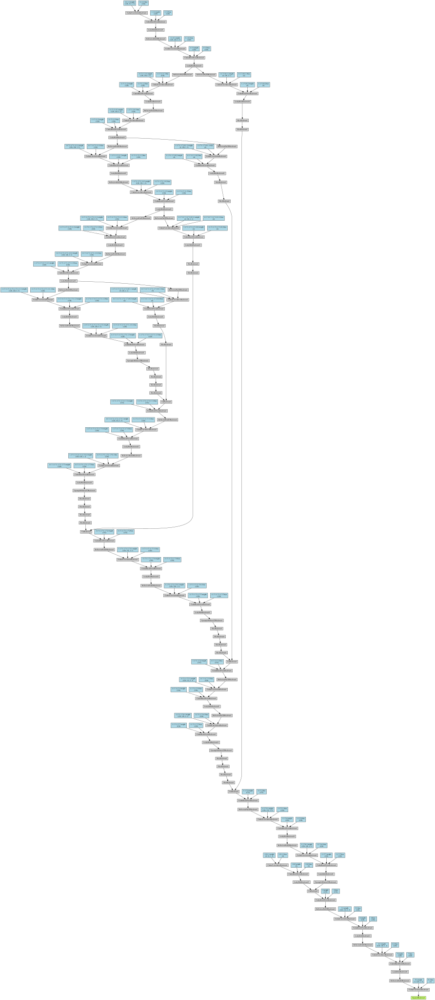

In [17]:
from torch import nn
from torchviz import make_dot, make_dot_from_trace

# Visualizacion grafica del modelo
make_dot(net(net_input), params=dict(net.named_parameters()))

In [0]:
def closure():

    global i, psrn_masked_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)

    total_loss = mse(out * mask_var, image_var * mask_var)
    total_loss.backward()
    
    psrn_masked = compare_psnr(image_masked, out.detach().cpu().numpy()[0] * image_mask_np) 
    psrn = compare_psnr(image_np, out.detach().cpu().numpy()[0]) 

    print ('Iteracion %05d    Perdida %f PSNR_masked %f PSNR %f' % (i, total_loss.item(), psrn_masked, psrn),'\r', end='')
    print('\n')
    #print(total_loss)
    
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        
        # Backtracking
        if psrn_masked - psrn_masked_last < -5: 
            print('Volviendo al punto de control anterior.\n')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.cpu() for x in net.parameters()]
            psrn_masked_last = psrn_masked



        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)

    i += 1

    #print("salida de función con perdida:", (total_loss.cpu()).detach().numpy())
    return total_loss, total_loss.item(), psrn, psrn_masked

Iniciando la optimización con ADAM Ricardo
Iteracion 00000    Perdida 0.036654 PSNR_masked 14.358791 PSNR 12.485151 



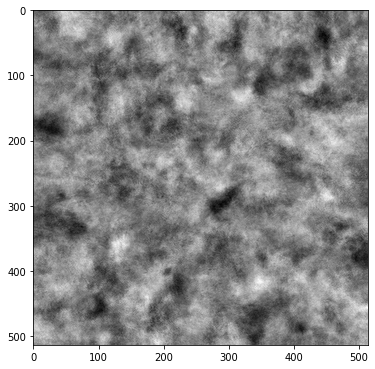

Iteracion 00001    Perdida 0.044204 PSNR_masked 13.545404 PSNR 11.664299 

Iteracion 00002    Perdida 0.042482 PSNR_masked 13.717949 PSNR 11.841817 

Iteracion 00003    Perdida 0.027561 PSNR_masked 15.597109 PSNR 13.729200 

Iteracion 00004    Perdida 0.022613 PSNR_masked 16.456483 PSNR 14.577759 

Iteracion 00005    Perdida 0.017858 PSNR_masked 17.481770 PSNR 15.598999 

Iteracion 00006    Perdida 0.015475 PSNR_masked 18.103725 PSNR 16.232070 

Iteracion 00007    Perdida 0.012957 PSNR_masked 18.874882 PSNR 16.996564 

Iteracion 00008    Perdida 0.011659 PSNR_masked 19.333330 PSNR 17.455534 

Iteracion 00009    Perdida 0.010348 PSNR_masked 19.851627 PSNR 17.964195 

Iteracion 00010    Perdida 0.010694 PSNR_masked 19.708700 PSNR 17.830087 

Iteracion 00011    Perdida 0.009495 PSNR_masked 20.224955 PSNR 18.331032 

Iteracion 00012    Perdida 0.009964 PSNR_masked 20.015777 PSNR 18.117859 

Iteracion 00013    Perdida 0.009091 PSNR_masked 20.414067 PSNR 18.527239 

Iteracion 00014    Perdid

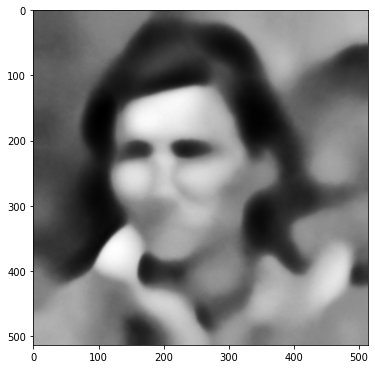

Iteracion 00051    Perdida 0.004519 PSNR_masked 23.449307 PSNR 21.558433 

Iteracion 00052    Perdida 0.004548 PSNR_masked 23.421498 PSNR 21.536854 

Iteracion 00053    Perdida 0.004460 PSNR_masked 23.506716 PSNR 21.616738 

Iteracion 00054    Perdida 0.004506 PSNR_masked 23.461634 PSNR 21.572246 

Iteracion 00055    Perdida 0.004523 PSNR_masked 23.445981 PSNR 21.562418 

Iteracion 00056    Perdida 0.004782 PSNR_masked 23.204115 PSNR 21.326493 

Iteracion 00057    Perdida 0.004424 PSNR_masked 23.542263 PSNR 21.658949 

Iteracion 00058    Perdida 0.004425 PSNR_masked 23.540576 PSNR 21.660309 

Iteracion 00059    Perdida 0.004474 PSNR_masked 23.492776 PSNR 21.604613 

Iteracion 00060    Perdida 0.004754 PSNR_masked 23.229636 PSNR 21.339007 

Iteracion 00061    Perdida 0.004515 PSNR_masked 23.453025 PSNR 21.556034 

Iteracion 00062    Perdida 0.004378 PSNR_masked 23.587047 PSNR 21.682853 

Iteracion 00063    Perdida 0.004375 PSNR_masked 23.590099 PSNR 21.679742 

Iteracion 00064    Perdid

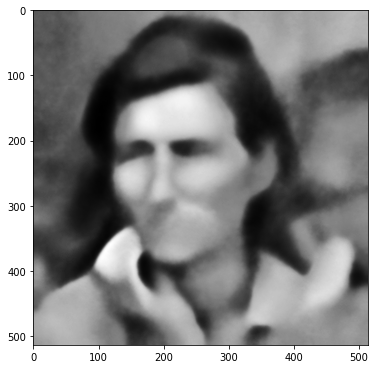

Iteracion 00101    Perdida 0.003371 PSNR_masked 24.721859 PSNR 22.822461 

Iteracion 00102    Perdida 0.003437 PSNR_masked 24.637854 PSNR 22.739054 

Iteracion 00103    Perdida 0.003378 PSNR_masked 24.713217 PSNR 22.807334 

Iteracion 00104    Perdida 0.003377 PSNR_masked 24.715187 PSNR 22.825399 

Iteracion 00105    Perdida 0.003252 PSNR_masked 24.878183 PSNR 22.964975 

Iteracion 00106    Perdida 0.003299 PSNR_masked 24.816289 PSNR 22.904473 

Iteracion 00107    Perdida 0.003213 PSNR_masked 24.930919 PSNR 23.021302 

Iteracion 00108    Perdida 0.003398 PSNR_masked 24.688314 PSNR 22.786315 

Iteracion 00109    Perdida 0.003097 PSNR_masked 25.090184 PSNR 23.171853 

Iteracion 00110    Perdida 0.003260 PSNR_masked 24.867905 PSNR 22.951628 

Iteracion 00111    Perdida 0.003243 PSNR_masked 24.889944 PSNR 22.983249 

Iteracion 00112    Perdida 0.003273 PSNR_masked 24.850868 PSNR 22.946531 

Iteracion 00113    Perdida 0.003062 PSNR_masked 25.140053 PSNR 23.236574 

Iteracion 00114    Perdid

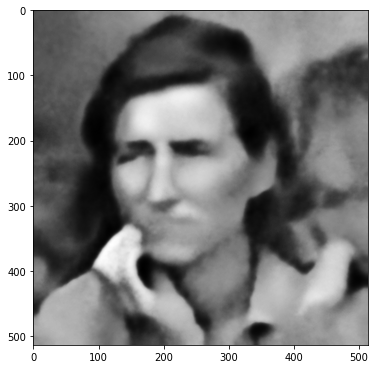

Iteracion 00151    Perdida 0.002692 PSNR_masked 25.699711 PSNR 23.778596 

Iteracion 00152    Perdida 0.002612 PSNR_masked 25.830482 PSNR 23.903739 

Iteracion 00153    Perdida 0.002733 PSNR_masked 25.633475 PSNR 23.712014 

Iteracion 00154    Perdida 0.002744 PSNR_masked 25.615918 PSNR 23.685148 

Iteracion 00155    Perdida 0.002603 PSNR_masked 25.845015 PSNR 23.901820 

Iteracion 00156    Perdida 0.002637 PSNR_masked 25.789245 PSNR 23.861393 

Iteracion 00157    Perdida 0.002636 PSNR_masked 25.791265 PSNR 23.853378 

Iteracion 00158    Perdida 0.002689 PSNR_masked 25.703911 PSNR 23.783001 

Iteracion 00159    Perdida 0.002824 PSNR_masked 25.491865 PSNR 23.599599 

Iteracion 00160    Perdida 0.002527 PSNR_masked 25.973132 PSNR 24.041645 

Iteracion 00161    Perdida 0.002666 PSNR_masked 25.740830 PSNR 23.831899 

Iteracion 00162    Perdida 0.002682 PSNR_masked 25.715574 PSNR 23.797146 

Iteracion 00163    Perdida 0.002511 PSNR_masked 26.000986 PSNR 24.065218 

Iteracion 00164    Perdid

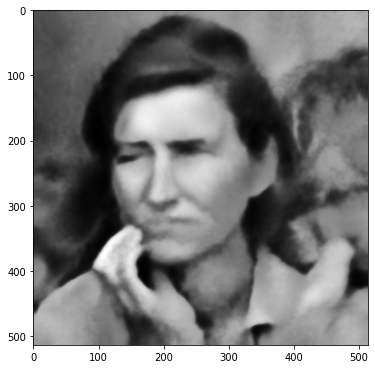

Iteracion 00201    Perdida 0.002215 PSNR_masked 26.546447 PSNR 24.602797 

Iteracion 00202    Perdida 0.002199 PSNR_masked 26.576931 PSNR 24.634687 

Iteracion 00203    Perdida 0.002229 PSNR_masked 26.519444 PSNR 24.571875 

Iteracion 00204    Perdida 0.002150 PSNR_masked 26.675412 PSNR 24.728314 

Iteracion 00205    Perdida 0.002191 PSNR_masked 26.593689 PSNR 24.660651 

Iteracion 00206    Perdida 0.002234 PSNR_masked 26.508273 PSNR 24.560877 

Iteracion 00207    Perdida 0.002199 PSNR_masked 26.578461 PSNR 24.639807 

Iteracion 00208    Perdida 0.002135 PSNR_masked 26.705249 PSNR 24.755546 

Iteracion 00209    Perdida 0.002194 PSNR_masked 26.587383 PSNR 24.627249 

Iteracion 00210    Perdida 0.002220 PSNR_masked 26.536714 PSNR 24.603071 

Iteracion 00211    Perdida 0.002133 PSNR_masked 26.710968 PSNR 24.763856 

Iteracion 00212    Perdida 0.002108 PSNR_masked 26.760329 PSNR 24.812146 

Iteracion 00213    Perdida 0.002172 PSNR_masked 26.630730 PSNR 24.689178 

Iteracion 00214    Perdid

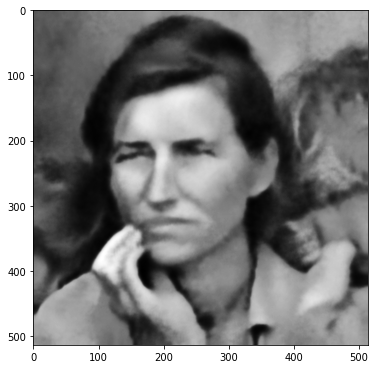

Iteracion 00251    Perdida 0.001868 PSNR_masked 27.286953 PSNR 25.334309 

Iteracion 00252    Perdida 0.001948 PSNR_masked 27.103278 PSNR 25.160742 

Iteracion 00253    Perdida 0.001881 PSNR_masked 27.255628 PSNR 25.311426 

Iteracion 00254    Perdida 0.001852 PSNR_masked 27.323419 PSNR 25.374538 

Iteracion 00255    Perdida 0.001820 PSNR_masked 27.399775 PSNR 25.440563 

Iteracion 00256    Perdida 0.001841 PSNR_masked 27.349764 PSNR 25.399457 

Iteracion 00257    Perdida 0.001919 PSNR_masked 27.169354 PSNR 25.224759 

Iteracion 00258    Perdida 0.001793 PSNR_masked 27.463703 PSNR 25.511367 

Iteracion 00259    Perdida 0.001775 PSNR_masked 27.507458 PSNR 25.554282 

Iteracion 00260    Perdida 0.001768 PSNR_masked 27.525708 PSNR 25.571234 

Iteracion 00261    Perdida 0.001815 PSNR_masked 27.411794 PSNR 25.433878 

Iteracion 00262    Perdida 0.001850 PSNR_masked 27.328839 PSNR 25.373224 

Iteracion 00263    Perdida 0.001810 PSNR_masked 27.422453 PSNR 25.483256 

Iteracion 00264    Perdid

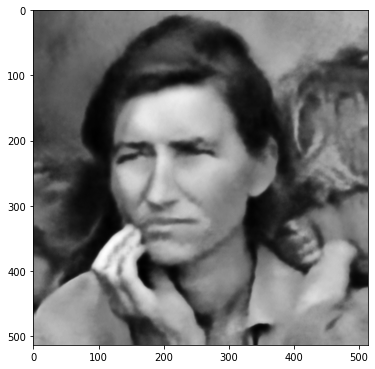

Iteracion 00301    Perdida 0.001681 PSNR_masked 27.743183 PSNR 25.786551 

Iteracion 00302    Perdida 0.001647 PSNR_masked 27.833681 PSNR 25.875106 

Iteracion 00303    Perdida 0.001575 PSNR_masked 28.026146 PSNR 26.069763 

Iteracion 00304    Perdida 0.001623 PSNR_masked 27.895950 PSNR 25.924818 

Iteracion 00305    Perdida 0.001594 PSNR_masked 27.975850 PSNR 26.015706 

Iteracion 00306    Perdida 0.001599 PSNR_masked 27.961119 PSNR 26.004770 

Iteracion 00307    Perdida 0.001622 PSNR_masked 27.899420 PSNR 25.931757 

Iteracion 00308    Perdida 0.001565 PSNR_masked 28.053783 PSNR 26.086908 

Iteracion 00309    Perdida 0.001558 PSNR_masked 28.074297 PSNR 26.098726 

Iteracion 00310    Perdida 0.001610 PSNR_masked 27.932857 PSNR 25.971309 

Iteracion 00311    Perdida 0.001554 PSNR_masked 28.086856 PSNR 26.127348 

Iteracion 00312    Perdida 0.001555 PSNR_masked 28.082798 PSNR 26.125780 

Iteracion 00313    Perdida 0.001557 PSNR_masked 28.075816 PSNR 26.115737 

Iteracion 00314    Perdid

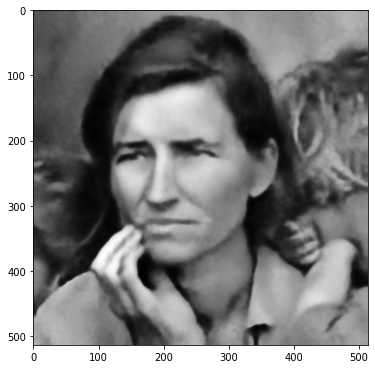

Iteracion 00351    Perdida 0.001429 PSNR_masked 28.449157 PSNR 26.485577 

Iteracion 00352    Perdida 0.001385 PSNR_masked 28.584821 PSNR 26.611939 

Iteracion 00353    Perdida 0.001443 PSNR_masked 28.407633 PSNR 26.463493 

Iteracion 00354    Perdida 0.001446 PSNR_masked 28.397158 PSNR 26.436580 

Iteracion 00355    Perdida 0.001422 PSNR_masked 28.469484 PSNR 26.503005 

Iteracion 00356    Perdida 0.001443 PSNR_masked 28.408487 PSNR 26.461644 

Iteracion 00357    Perdida 0.001401 PSNR_masked 28.534985 PSNR 26.565987 

Iteracion 00358    Perdida 0.001386 PSNR_masked 28.583455 PSNR 26.613859 

Iteracion 00359    Perdida 0.001421 PSNR_masked 28.475584 PSNR 26.504726 

Iteracion 00360    Perdida 0.001409 PSNR_masked 28.510528 PSNR 26.545494 

Iteracion 00361    Perdida 0.001389 PSNR_masked 28.573109 PSNR 26.615816 

Iteracion 00362    Perdida 0.001436 PSNR_masked 28.427720 PSNR 26.470702 

Iteracion 00363    Perdida 0.001437 PSNR_masked 28.424827 PSNR 26.466324 

Iteracion 00364    Perdid

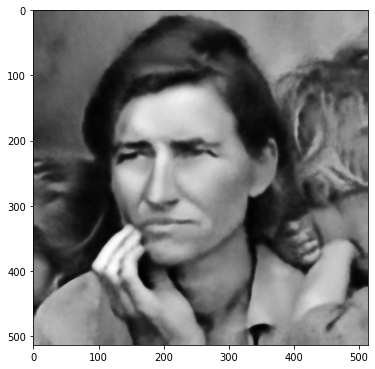

Iteracion 00401    Perdida 0.001303 PSNR_masked 28.851975 PSNR 26.879210 

Iteracion 00402    Perdida 0.001304 PSNR_masked 28.848044 PSNR 26.884589 

Iteracion 00403    Perdida 0.001275 PSNR_masked 28.946090 PSNR 26.971348 

Iteracion 00404    Perdida 0.001278 PSNR_masked 28.935934 PSNR 26.963979 

Iteracion 00405    Perdida 0.001286 PSNR_masked 28.907202 PSNR 26.945357 

Iteracion 00406    Perdida 0.001277 PSNR_masked 28.938223 PSNR 26.964551 

Iteracion 00407    Perdida 0.001306 PSNR_masked 28.841564 PSNR 26.876770 

Iteracion 00408    Perdida 0.001259 PSNR_masked 29.001120 PSNR 27.025088 

Iteracion 00409    Perdida 0.001264 PSNR_masked 28.981386 PSNR 27.022271 

Iteracion 00410    Perdida 0.001307 PSNR_masked 28.837370 PSNR 26.863921 

Iteracion 00411    Perdida 0.001268 PSNR_masked 28.967884 PSNR 27.008587 

Iteracion 00412    Perdida 0.001252 PSNR_masked 29.022238 PSNR 27.036557 

Iteracion 00413    Perdida 0.001288 PSNR_masked 28.901418 PSNR 26.928570 

Iteracion 00414    Perdid

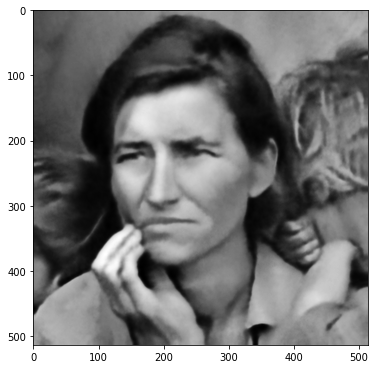

Iteracion 00451    Perdida 0.001231 PSNR_masked 29.096845 PSNR 27.117356 

Iteracion 00452    Perdida 0.001202 PSNR_masked 29.202189 PSNR 27.232904 

Iteracion 00453    Perdida 0.001207 PSNR_masked 29.184231 PSNR 27.201706 

Iteracion 00454    Perdida 0.001175 PSNR_masked 29.299266 PSNR 27.319230 

Iteracion 00455    Perdida 0.001212 PSNR_masked 29.164066 PSNR 27.196168 

Iteracion 00456    Perdida 0.001187 PSNR_masked 29.256983 PSNR 27.290110 

Iteracion 00457    Perdida 0.001214 PSNR_masked 29.158089 PSNR 27.187688 

Iteracion 00458    Perdida 0.001156 PSNR_masked 29.371960 PSNR 27.394396 

Iteracion 00459    Perdida 0.001189 PSNR_masked 29.247278 PSNR 27.274271 

Iteracion 00460    Perdida 0.001169 PSNR_masked 29.322844 PSNR 27.346899 

Iteracion 00461    Perdida 0.001208 PSNR_masked 29.179381 PSNR 27.195198 

Iteracion 00462    Perdida 0.001157 PSNR_masked 29.366996 PSNR 27.391775 

Iteracion 00463    Perdida 0.001214 PSNR_masked 29.158119 PSNR 27.176725 

Iteracion 00464    Perdid

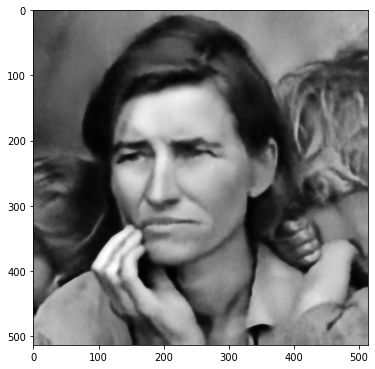

Iteracion 00501    Perdida 0.001092 PSNR_masked 29.616356 PSNR 27.627175 

Iteracion 00502    Perdida 0.001120 PSNR_masked 29.508013 PSNR 27.527425 

Iteracion 00503    Perdida 0.001105 PSNR_masked 29.566561 PSNR 27.585523 

Iteracion 00504    Perdida 0.001099 PSNR_masked 29.589330 PSNR 27.609910 

Iteracion 00505    Perdida 0.001138 PSNR_masked 29.437036 PSNR 27.453675 

Iteracion 00506    Perdida 0.001121 PSNR_masked 29.503877 PSNR 27.527070 

Iteracion 00507    Perdida 0.001131 PSNR_masked 29.466675 PSNR 27.497259 

Iteracion 00508    Perdida 0.001104 PSNR_masked 29.569851 PSNR 27.574485 

Iteracion 00509    Perdida 0.001117 PSNR_masked 29.520189 PSNR 27.542928 

Iteracion 00510    Perdida 0.001112 PSNR_masked 29.539511 PSNR 27.567020 

Iteracion 00511    Perdida 0.001091 PSNR_masked 29.622051 PSNR 27.645954 

Iteracion 00512    Perdida 0.001099 PSNR_masked 29.589755 PSNR 27.613625 

Iteracion 00513    Perdida 0.001108 PSNR_masked 29.556537 PSNR 27.562855 

Iteracion 00514    Perdid

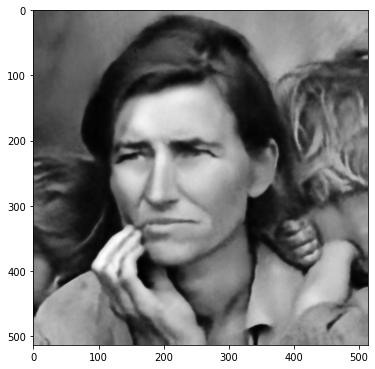

Iteracion 00551    Perdida 0.001054 PSNR_masked 29.773138 PSNR 27.784354 

Iteracion 00552    Perdida 0.001047 PSNR_masked 29.798799 PSNR 27.814945 

Iteracion 00553    Perdida 0.001049 PSNR_masked 29.794084 PSNR 27.804583 

Iteracion 00554    Perdida 0.001028 PSNR_masked 29.881063 PSNR 27.896078 

Iteracion 00555    Perdida 0.001012 PSNR_masked 29.947058 PSNR 27.956097 

Iteracion 00556    Perdida 0.001054 PSNR_masked 29.773073 PSNR 27.767387 

Iteracion 00557    Perdida 0.001038 PSNR_masked 29.836297 PSNR 27.838638 

Iteracion 00558    Perdida 0.001026 PSNR_masked 29.888331 PSNR 27.888624 

Iteracion 00559    Perdida 0.001048 PSNR_masked 29.796443 PSNR 27.793286 

Iteracion 00560    Perdida 0.001023 PSNR_masked 29.901479 PSNR 27.906590 

Iteracion 00561    Perdida 0.001067 PSNR_masked 29.719222 PSNR 27.735819 

Iteracion 00562    Perdida 0.001034 PSNR_masked 29.854148 PSNR 27.854161 

Iteracion 00563    Perdida 0.001047 PSNR_masked 29.801732 PSNR 27.810196 

Iteracion 00564    Perdid

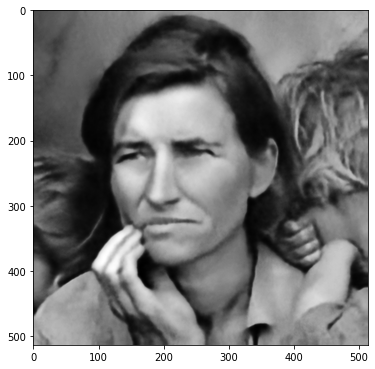

Iteracion 00601    Perdida 0.000966 PSNR_masked 30.148103 PSNR 28.139733 

Iteracion 00602    Perdida 0.000964 PSNR_masked 30.159965 PSNR 28.157579 

Iteracion 00603    Perdida 0.000959 PSNR_masked 30.182494 PSNR 28.189521 

Iteracion 00604    Perdida 0.000998 PSNR_masked 30.006964 PSNR 28.014900 

Iteracion 00605    Perdida 0.000960 PSNR_masked 30.177973 PSNR 28.189758 

Iteracion 00606    Perdida 0.000975 PSNR_masked 30.110120 PSNR 28.120161 

Iteracion 00607    Perdida 0.000991 PSNR_masked 30.038975 PSNR 28.052543 

Iteracion 00608    Perdida 0.000957 PSNR_masked 30.189776 PSNR 28.194228 

Iteracion 00609    Perdida 0.000984 PSNR_masked 30.069836 PSNR 28.069148 

Iteracion 00610    Perdida 0.000974 PSNR_masked 30.116151 PSNR 28.120010 

Iteracion 00611    Perdida 0.001010 PSNR_masked 29.955961 PSNR 27.955867 

Iteracion 00612    Perdida 0.000954 PSNR_masked 30.204372 PSNR 28.199565 

Iteracion 00613    Perdida 0.000981 PSNR_masked 30.081274 PSNR 28.084467 

Iteracion 00614    Perdid

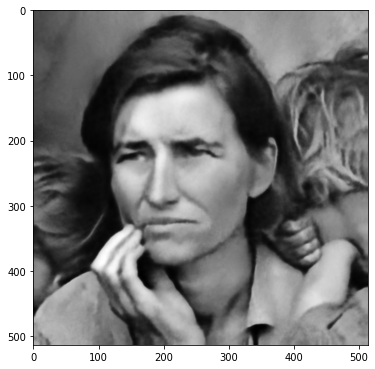

Iteracion 00651    Perdida 0.000922 PSNR_masked 30.352565 PSNR 28.340833 

Iteracion 00652    Perdida 0.000948 PSNR_masked 30.232408 PSNR 28.233840 

Iteracion 00653    Perdida 0.000958 PSNR_masked 30.186910 PSNR 28.174180 

Iteracion 00654    Perdida 0.000929 PSNR_masked 30.321705 PSNR 28.315265 

Iteracion 00655    Perdida 0.000921 PSNR_masked 30.358816 PSNR 28.359724 

Iteracion 00656    Perdida 0.000968 PSNR_masked 30.139544 PSNR 28.140980 

Iteracion 00657    Perdida 0.000945 PSNR_masked 30.244852 PSNR 28.250207 

Iteracion 00658    Perdida 0.000917 PSNR_masked 30.377677 PSNR 28.372918 

Iteracion 00659    Perdida 0.000937 PSNR_masked 30.283587 PSNR 28.291510 

Iteracion 00660    Perdida 0.000938 PSNR_masked 30.277654 PSNR 28.264109 

Iteracion 00661    Perdida 0.000932 PSNR_masked 30.304405 PSNR 28.300090 

Iteracion 00662    Perdida 0.000924 PSNR_masked 30.341379 PSNR 28.350173 

Iteracion 00663    Perdida 0.000915 PSNR_masked 30.387852 PSNR 28.373454 

Iteracion 00664    Perdid

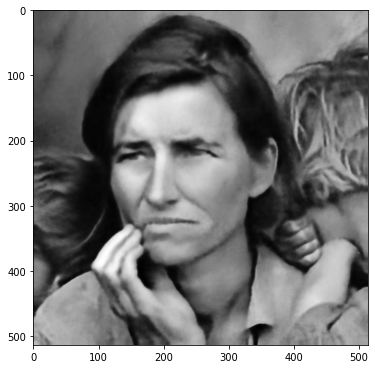

Iteracion 00701    Perdida 0.000880 PSNR_masked 30.554189 PSNR 28.545388 

Iteracion 00702    Perdida 0.000870 PSNR_masked 30.603717 PSNR 28.588385 

Iteracion 00703    Perdida 0.000858 PSNR_masked 30.663847 PSNR 28.648300 

Iteracion 00704    Perdida 0.000866 PSNR_masked 30.622738 PSNR 28.608960 

Iteracion 00705    Perdida 0.000883 PSNR_masked 30.541934 PSNR 28.513941 

Iteracion 00706    Perdida 0.000870 PSNR_masked 30.606615 PSNR 28.583229 

Iteracion 00707    Perdida 0.000852 PSNR_masked 30.695459 PSNR 28.681049 

Iteracion 00708    Perdida 0.000868 PSNR_masked 30.614387 PSNR 28.593016 

Iteracion 00709    Perdida 0.000850 PSNR_masked 30.707860 PSNR 28.695042 

Iteracion 00710    Perdida 0.000847 PSNR_masked 30.721408 PSNR 28.706966 

Iteracion 00711    Perdida 0.000865 PSNR_masked 30.628661 PSNR 28.612281 

Iteracion 00712    Perdida 0.000855 PSNR_masked 30.678982 PSNR 28.656074 

Iteracion 00713    Perdida 0.000881 PSNR_masked 30.551262 PSNR 28.535091 

Iteracion 00714    Perdid

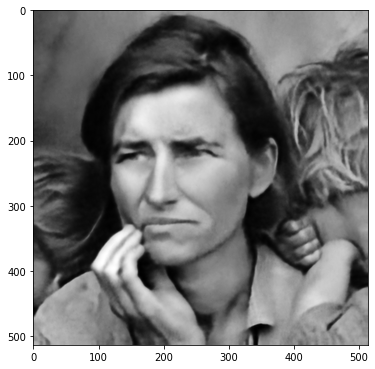

Iteracion 00751    Perdida 0.000855 PSNR_masked 30.679749 PSNR 28.664136 

Iteracion 00752    Perdida 0.000847 PSNR_masked 30.721887 PSNR 28.707392 

Iteracion 00753    Perdida 0.000839 PSNR_masked 30.760340 PSNR 28.738263 

Iteracion 00754    Perdida 0.000843 PSNR_masked 30.743351 PSNR 28.718821 

Iteracion 00755    Perdida 0.000835 PSNR_masked 30.785729 PSNR 28.760817 

Iteracion 00756    Perdida 0.000834 PSNR_masked 30.786995 PSNR 28.760944 

Iteracion 00757    Perdida 0.000828 PSNR_masked 30.819816 PSNR 28.791080 

Iteracion 00758    Perdida 0.000826 PSNR_masked 30.829935 PSNR 28.810769 

Iteracion 00759    Perdida 0.000842 PSNR_masked 30.747558 PSNR 28.730196 

Iteracion 00760    Perdida 0.000840 PSNR_masked 30.757219 PSNR 28.731162 

Iteracion 00761    Perdida 0.000821 PSNR_masked 30.854093 PSNR 28.810502 

Iteracion 00762    Perdida 0.000859 PSNR_masked 30.660222 PSNR 28.638963 

Iteracion 00763    Perdida 0.000823 PSNR_masked 30.843943 PSNR 28.803442 

Iteracion 00764    Perdid

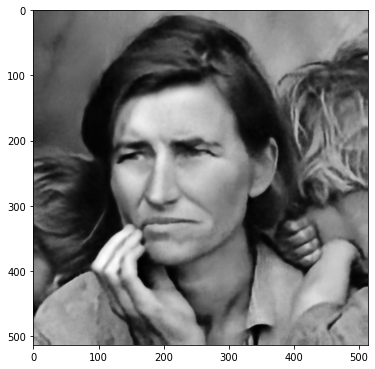

Iteracion 00801    Perdida 0.000789 PSNR_masked 31.031402 PSNR 29.006255 

Iteracion 00802    Perdida 0.000779 PSNR_masked 31.083029 PSNR 29.057106 

Iteracion 00803    Perdida 0.000792 PSNR_masked 31.012203 PSNR 28.986193 

Iteracion 00804    Perdida 0.000783 PSNR_masked 31.059929 PSNR 29.019990 

Iteracion 00805    Perdida 0.000788 PSNR_masked 31.035053 PSNR 28.997314 

Iteracion 00806    Perdida 0.000786 PSNR_masked 31.045997 PSNR 29.011854 

Iteracion 00807    Perdida 0.000779 PSNR_masked 31.085550 PSNR 29.049060 

Iteracion 00808    Perdida 0.000791 PSNR_masked 31.019987 PSNR 28.996299 

Iteracion 00809    Perdida 0.000800 PSNR_masked 30.967362 PSNR 28.940710 

Iteracion 00810    Perdida 0.000783 PSNR_masked 31.060512 PSNR 29.022535 

Iteracion 00811    Perdida 0.000777 PSNR_masked 31.094777 PSNR 29.056416 

Iteracion 00812    Perdida 0.000779 PSNR_masked 31.082259 PSNR 29.041733 

Iteracion 00813    Perdida 0.000785 PSNR_masked 31.050222 PSNR 29.024488 

Iteracion 00814    Perdid

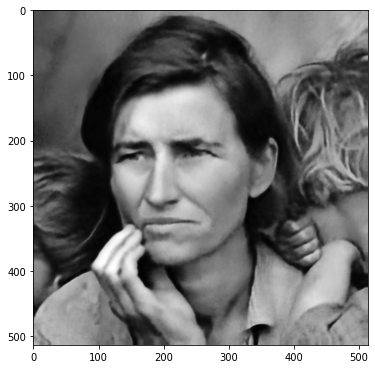

Iteracion 00851    Perdida 0.000760 PSNR_masked 31.189684 PSNR 29.148093 

Iteracion 00852    Perdida 0.000758 PSNR_masked 31.205830 PSNR 29.176433 

Iteracion 00853    Perdida 0.000744 PSNR_masked 31.285703 PSNR 29.253542 

Iteracion 00854    Perdida 0.000736 PSNR_masked 31.329779 PSNR 29.284721 

Iteracion 00855    Perdida 0.000761 PSNR_masked 31.184772 PSNR 29.140764 

Iteracion 00856    Perdida 0.000738 PSNR_masked 31.317928 PSNR 29.269751 

Iteracion 00857    Perdida 0.000735 PSNR_masked 31.338659 PSNR 29.277365 

Iteracion 00858    Perdida 0.000745 PSNR_masked 31.279757 PSNR 29.234616 

Iteracion 00859    Perdida 0.000768 PSNR_masked 31.144267 PSNR 29.105198 

Iteracion 00860    Perdida 0.000739 PSNR_masked 31.316447 PSNR 29.248790 

Iteracion 00861    Perdida 0.000746 PSNR_masked 31.271214 PSNR 29.228266 

Iteracion 00862    Perdida 0.000729 PSNR_masked 31.371537 PSNR 29.337567 

Iteracion 00863    Perdida 0.000736 PSNR_masked 31.329659 PSNR 29.282576 

Iteracion 00864    Perdid

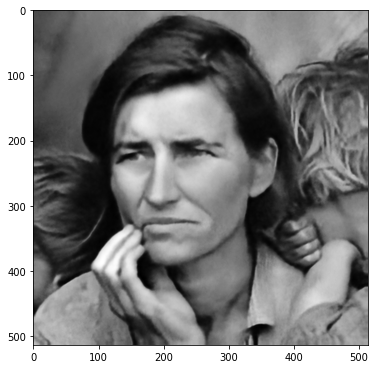

Iteracion 00901    Perdida 0.000729 PSNR_masked 31.372829 PSNR 29.326018 

Iteracion 00902    Perdida 0.000718 PSNR_masked 31.437769 PSNR 29.366819 

Iteracion 00903    Perdida 0.000708 PSNR_masked 31.500321 PSNR 29.445937 

Iteracion 00904    Perdida 0.000698 PSNR_masked 31.562029 PSNR 29.501929 

Iteracion 00905    Perdida 0.000729 PSNR_masked 31.373837 PSNR 29.335767 

Iteracion 00906    Perdida 0.000721 PSNR_masked 31.422695 PSNR 29.389580 

Iteracion 00907    Perdida 0.000732 PSNR_masked 31.354562 PSNR 29.314671 

Iteracion 00908    Perdida 0.000706 PSNR_masked 31.511355 PSNR 29.459496 

Iteracion 00909    Perdida 0.000753 PSNR_masked 31.230229 PSNR 29.209523 

Iteracion 00910    Perdida 0.000720 PSNR_masked 31.425787 PSNR 29.383182 

Iteracion 00911    Perdida 0.000714 PSNR_masked 31.461557 PSNR 29.399501 

Iteracion 00912    Perdida 0.000723 PSNR_masked 31.410890 PSNR 29.352368 

Iteracion 00913    Perdida 0.000709 PSNR_masked 31.495016 PSNR 29.437876 

Iteracion 00914    Perdid

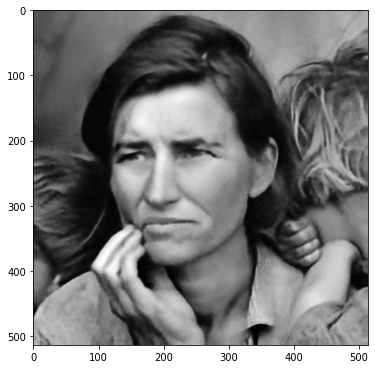

Iteracion 00951    Perdida 0.000692 PSNR_masked 31.599291 PSNR 29.538455 

Iteracion 00952    Perdida 0.000713 PSNR_masked 31.471651 PSNR 29.408572 

Iteracion 00953    Perdida 0.000696 PSNR_masked 31.576685 PSNR 29.514554 

Iteracion 00954    Perdida 0.000696 PSNR_masked 31.573651 PSNR 29.530220 

Iteracion 00955    Perdida 0.000697 PSNR_masked 31.569483 PSNR 29.504793 

Iteracion 00956    Perdida 0.000730 PSNR_masked 31.367954 PSNR 29.318374 

Iteracion 00957    Perdida 0.000685 PSNR_masked 31.640797 PSNR 29.573191 

Iteracion 00958    Perdida 0.000712 PSNR_masked 31.473380 PSNR 29.411541 

Iteracion 00959    Perdida 0.000692 PSNR_masked 31.600463 PSNR 29.535184 

Iteracion 00960    Perdida 0.000683 PSNR_masked 31.653055 PSNR 29.609096 

Iteracion 00961    Perdida 0.000712 PSNR_masked 31.475657 PSNR 29.405179 

Iteracion 00962    Perdida 0.000698 PSNR_masked 31.563710 PSNR 29.504987 

Iteracion 00963    Perdida 0.000692 PSNR_masked 31.601910 PSNR 29.533942 

Iteracion 00964    Perdid

In [19]:
%%time
# Inicialización de variables globales 
last_net = None
psrn_masked_last = 0
i = 0

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

# Run
p = get_params(OPT_OVER, net, net_input)
#total_loss_item_acum, psrn_acum, total_loss_acum = optimize(OPTIMIZER, p, closure, LR=LR, num_iter=num_iter)
total_loss_final, total_loss_item_final, psrn_final, psrn_masked_final = optimize(OPTIMIZER, p, closure, LR=LR, num_iter=num_iter)

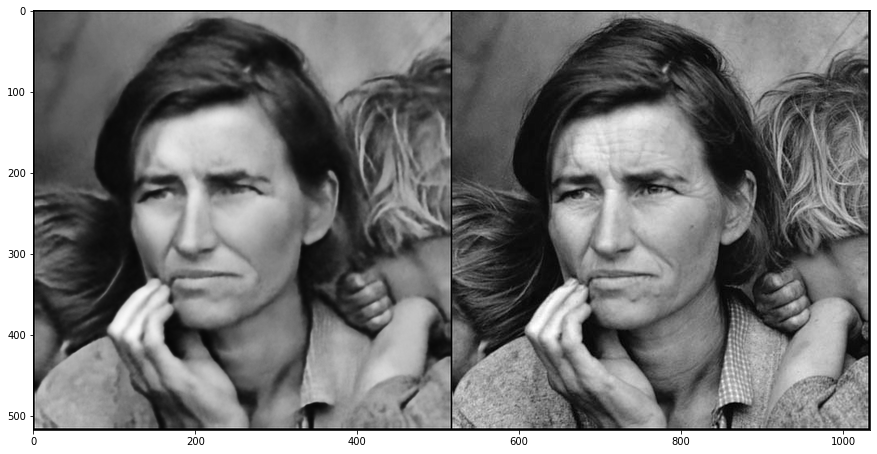

In [20]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), image_np], factor=13);

total_loss_item_final:  0.0007
Relación pico señal / ruido (PSNR):  29.7107
Relación pico señal / ruido (PSNR) [masked]:  31.7761
Error cuadrático medio (MSE):  0.0007 



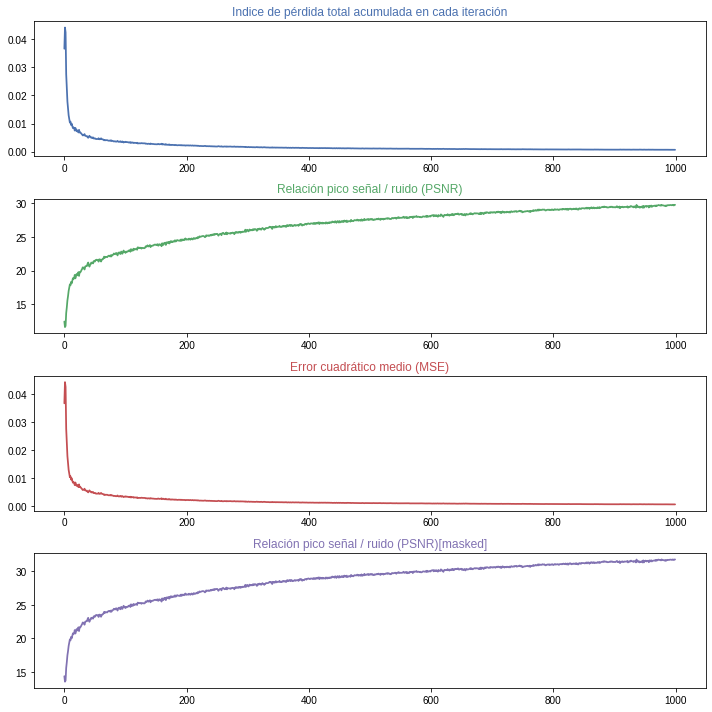

In [21]:
#total_loss_item_final, psrn_final, total_loss_final, psrn_masked_final
print("total_loss_item_final: ", "{0:.4f}".format(total_loss_item_final[len(total_loss_item_final)-1]))
print("Relación pico señal / ruido (PSNR): ", "{0:.4f}".format(psrn_final[len(psrn_final)-1]))
print("Relación pico señal / ruido (PSNR) [masked]: ", "{0:.4f}".format(psrn_masked_final[len(psrn_masked_final)-1]))
print("Error cuadrático medio (MSE): ", "{0:.4f}".format(total_loss_final[len(total_loss_final)-1]), "\n")

fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=4, figsize=(10,10))
mpl.style.use('seaborn')

ax1.set_title('Indice de pérdida total acumulada en cada iteración'.format('seaborn'), color='C0')
ax1.plot(total_loss_item_final, color='C0')

ax2.set_title('Relación pico señal / ruido (PSNR)'.format('seaborn'), color='C1')
ax2.plot(psrn_final, color='C1')

ax3.plot(total_loss_final, color='C2')
ax3.set_title('Error cuadrático medio (MSE)'.format('seaborn'), color='C2')

ax4.set_title('Relación pico señal / ruido (PSNR)[masked]'.format('seaborn'), color='C3')
ax4.plot(psrn_masked_final, color='C3')

plt.tight_layout()
plt.show()
plt.close()

mpl.rcParams.update(inline_rc)

# **Inpainting**

## ***Escogiendo la imagen a procesar***

In [0]:
# Cargamos imágenes del conjunto de dataset, en 'data' para trabajar
inpaintingFiles = ['./TFM_UAH_RGR/data/inpainting/indian.png',
                   './TFM_UAH_RGR/data/inpainting/kate.png',
                   './TFM_UAH_RGR/data/inpainting/library.png',
                   './TFM_UAH_RGR/data/inpainting/tinajas.png',
                   './TFM_UAH_RGR/data/inpainting/vase.png']

maskFiles = ['./TFM_UAH_RGR/data/inpainting/indian_mask.png',
             './TFM_UAH_RGR/data/inpainting/kate_mask.png',
             './TFM_UAH_RGR/data/inpainting/library_mask.png',
             './TFM_UAH_RGR/data/inpainting/tinajas_mask.png',
             './TFM_UAH_RGR/data/inpainting/vase_mask.png']

# selección de la imagen  [0-4]
image_number = 4
image_path  = inpaintingFiles[image_number]
mask_path = maskFiles[image_number]

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

## ***Cargando la mascara***

In [0]:
image_pil, image_np = get_image(image_path, imagesize)
image_mask_pil, image_mask_np = get_image(mask_path, imagesize)

### ***Centrando el corte objetivo***

In [0]:
image_mask_pil = crop_image(image_mask_pil, dim_div_by)
image_pil      = crop_image(image_pil,      dim_div_by)

image_np      = pil_to_np(image_pil)
image_mask_np = pil_to_np(image_mask_pil)

# Imagen alterada con la mascara
image_masked = image_mask_np*image_np


### ***Visualizando***

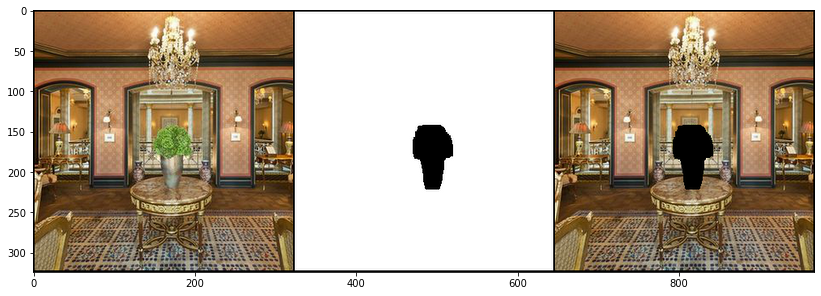

In [89]:
image_mask_var = np_to_torch(image_mask_np).type(dtype)

plot_image_grid([image_np, image_mask_np, image_masked], 3,11);

## **Inicialización**

In [0]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

Ahora vamos a crear funciones especializadas para trabajar con cada una de las 5 imágenes que estamos comprobando:

1.   'indian.png', se aplica la función imageOne()
2.   'kate.png', se aplica la función imageTwo()
3.   'library.png', se aplica la función imageTree()
4.   'tinajas.png', se aplica la función imageFour()
5.   'vase.png', se aplica la función imageFive()



In [0]:
def imageOne():
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 5501
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, image_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype)
    
    return net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize

In [0]:
def imageTwo():
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, image_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype)
    
    return net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize

In [0]:
def imageThree():
    INPUT = 'noise'
    input_depth = 1
    
    num_iter = 3001
    show_every = 50
    figsize = 8
    reg_noise_std = 0.00
    param_noise = True
    
    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, image_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
               num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
               num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
               filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
               upsample_mode='nearest', # downsample_mode='avg',
               need1x1_up=False,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                   feature_scale=8, more_layers=1, 
                   concat_x=False, upsample_mode='deconv', 
                   pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, image_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False

    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype)
    
    return net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize

In [0]:
def imageFour():
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001 # numero iteraciones original 6001, 7501
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, image_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype)
    
    return net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize

In [0]:
def imageFive():
    INPUT = 'meshgrid'
    input_depth = 2
    LR = 0.01 
    num_iter = 5001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, image_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up   = [128] * 5,
               num_channels_skip = [0] * 5,  
               upsample_mode='nearest', filter_skip_size=1, filter_size_up=3, filter_size_down=3,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
    net = net.type(dtype)
    net_input = get_noise(input_depth, INPUT, image_np.shape[1:]).type(dtype)
    
    return net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize

In [92]:
# Definición de la función de selección
switcher = {
        1: imageOne,
        2: imageTwo,
        3: imageThree,
        4: imageFour,
        5: imageFive
}
def imageSelection(argument):
    # Obtenemos la función en función del diccionario del switcher
    func = switcher.get(argument+1, lambda: "Error de seleccion")
    # ejecutamos la funcion
    return func()

# ejecucion de la funcion
net_input, net, LR, num_iter, param_noise, reg_noise_std, show_every, figsize = imageSelection(image_number)

# Calcular numero de parametros
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Numero de parámetros: %d' % s)

# Perdida
mse = torch.nn.MSELoss().type(dtype)

image_var = np_to_torch(image_np).type(dtype)
mask_var = np_to_torch(image_mask_np).type(dtype)

Numero de parámetros: 2157955


## **Procesamiento principal**

In [0]:
i = 0
def closureInpainting():
    
    global i #, psrn_masked_last, last_net, net_input
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, image_var * mask_var)
    total_loss.backward()

    psrn_masked = compare_psnr(image_masked, out.detach().cpu().numpy()[0] * image_mask_np) 
    psrn = compare_psnr(image_np, out.detach().cpu().numpy()[0])     
        
    print ('Iteracion %05d    Perdida %f' % (i, total_loss.item()), '\r', end='')
    print('\n')

    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    #return total_loss, total_loss.item(), psrn, psrn_masked
    return total_loss, total_loss.item(), psrn, psrn_masked


In [94]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

# Datos del modelo
print(torch_summarize(net))

Sequential (
  (1): Sequential (
    (1): Sequential (
      (0): ReflectionPad2d((1, 1, 1, 1)), pesos=(), parametros=0
      (1): Conv2d(2, 128, kernel_size=(3, 3), stride=(2, 2)), pesos=((128, 2, 3, 3), (128,)), parametros=2432
    ), pesos=((128, 2, 3, 3), (128,)), parametros=2432
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), pesos=((128,), (128,)), parametros=256
    (3): LeakyReLU(negative_slope=0.2, inplace=True), pesos=(), parametros=0
    (4): Sequential (
      (0): ReflectionPad2d((1, 1, 1, 1)), pesos=(), parametros=0
      (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1)), pesos=((128, 128, 3, 3), (128,)), parametros=147584
    ), pesos=((128, 128, 3, 3), (128,)), parametros=147584
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), pesos=((128,), (128,)), parametros=256
    (6): LeakyReLU(negative_slope=0.2, inplace=True), pesos=(), parametros=0
    (7): Sequential (
      (1): Sequen

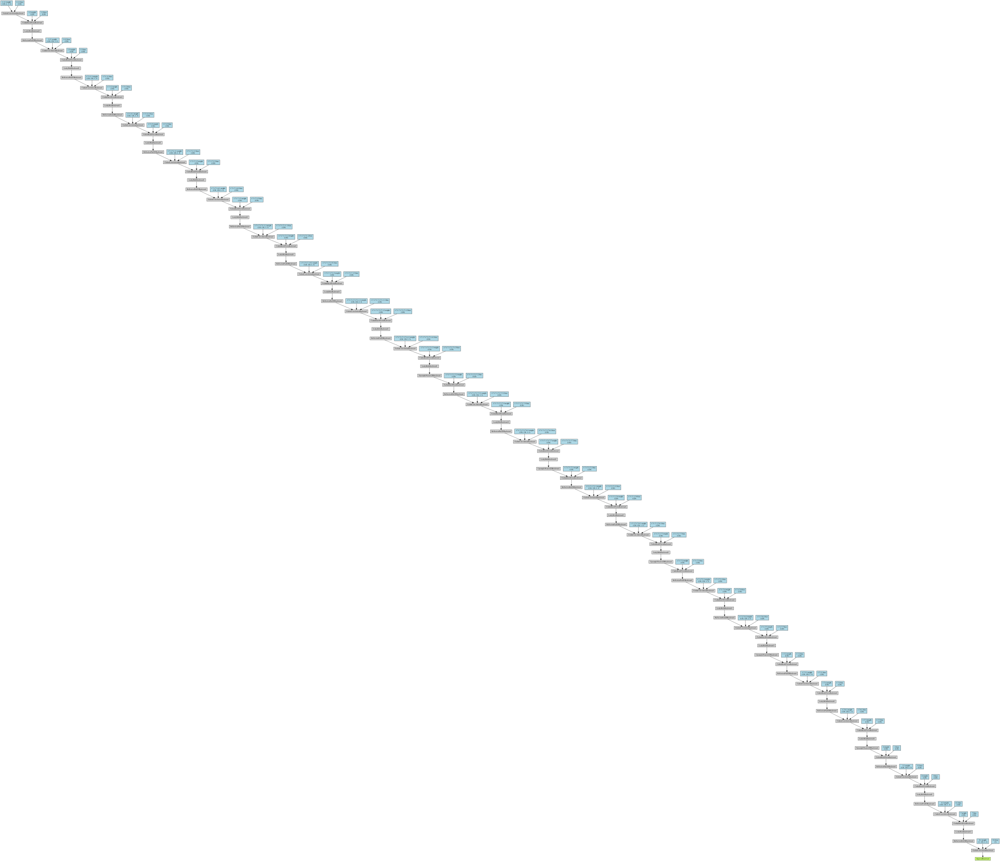

In [95]:
from torch import nn
from torchviz import make_dot, make_dot_from_trace

# Visualizacion grafica del modelo
make_dot(net(net_input), params=dict(net.named_parameters()))



Iniciando la optimización con ADAM Ricardo
Iteracion 00000    Perdida 0.059964 



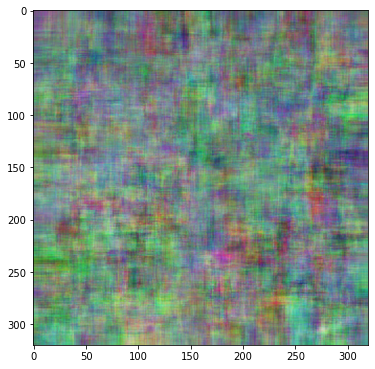

Iteracion 00001    Perdida 0.068049 

Iteracion 00002    Perdida 0.058894 

Iteracion 00003    Perdida 0.052900 

Iteracion 00004    Perdida 0.042837 

Iteracion 00005    Perdida 0.039138 

Iteracion 00006    Perdida 0.036579 

Iteracion 00007    Perdida 0.032149 

Iteracion 00008    Perdida 0.029412 

Iteracion 00009    Perdida 0.028233 

Iteracion 00010    Perdida 0.027728 

Iteracion 00011    Perdida 0.027482 

Iteracion 00012    Perdida 0.026968 

Iteracion 00013    Perdida 0.026045 

Iteracion 00014    Perdida 0.025155 

Iteracion 00015    Perdida 0.024786 

Iteracion 00016    Perdida 0.024555 

Iteracion 00017    Perdida 0.024268 

Iteracion 00018    Perdida 0.024072 

Iteracion 00019    Perdida 0.023797 

Iteracion 00020    Perdida 0.023435 

Iteracion 00021    Perdida 0.022999 

Iteracion 00022    Perdida 0.022694 

Iteracion 00023    Perdida 0.022392 

Iteracion 00024    Perdida 0.022258 

Iteracion 00025    Perdida 0.022106 

Iteracion 00026    Perdida 0.021876 

Iteracion 00

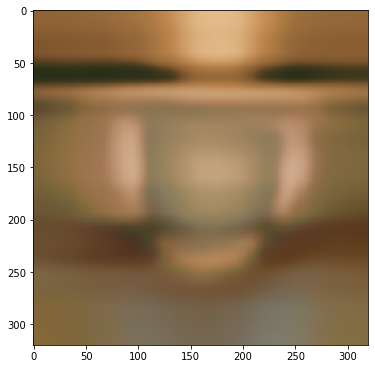

Iteracion 00051    Perdida 0.018107 

Iteracion 00052    Perdida 0.018090 

Iteracion 00053    Perdida 0.017807 

Iteracion 00054    Perdida 0.017603 

Iteracion 00055    Perdida 0.017519 

Iteracion 00056    Perdida 0.017422 

Iteracion 00057    Perdida 0.017266 

Iteracion 00058    Perdida 0.017132 

Iteracion 00059    Perdida 0.017089 

Iteracion 00060    Perdida 0.016910 

Iteracion 00061    Perdida 0.016763 

Iteracion 00062    Perdida 0.016672 

Iteracion 00063    Perdida 0.016536 

Iteracion 00064    Perdida 0.016433 

Iteracion 00065    Perdida 0.016257 

Iteracion 00066    Perdida 0.016314 

Iteracion 00067    Perdida 0.016158 

Iteracion 00068    Perdida 0.016009 

Iteracion 00069    Perdida 0.015913 

Iteracion 00070    Perdida 0.016032 

Iteracion 00071    Perdida 0.016902 

Iteracion 00072    Perdida 0.018148 

Iteracion 00073    Perdida 0.016546 

Iteracion 00074    Perdida 0.017171 

Iteracion 00075    Perdida 0.016216 

Iteracion 00076    Perdida 0.016692 

Iteracion 00

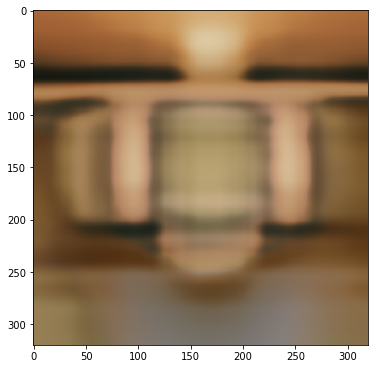

Iteracion 00101    Perdida 0.014717 

Iteracion 00102    Perdida 0.015087 

Iteracion 00103    Perdida 0.014838 

Iteracion 00104    Perdida 0.014614 

Iteracion 00105    Perdida 0.014675 

Iteracion 00106    Perdida 0.014635 

Iteracion 00107    Perdida 0.014432 

Iteracion 00108    Perdida 0.014761 

Iteracion 00109    Perdida 0.014429 

Iteracion 00110    Perdida 0.014278 

Iteracion 00111    Perdida 0.014373 

Iteracion 00112    Perdida 0.014128 

Iteracion 00113    Perdida 0.014218 

Iteracion 00114    Perdida 0.014206 

Iteracion 00115    Perdida 0.013985 

Iteracion 00116    Perdida 0.013954 

Iteracion 00117    Perdida 0.013874 

Iteracion 00118    Perdida 0.013782 

Iteracion 00119    Perdida 0.013820 

Iteracion 00120    Perdida 0.013790 

Iteracion 00121    Perdida 0.013780 

Iteracion 00122    Perdida 0.013947 

Iteracion 00123    Perdida 0.013796 

Iteracion 00124    Perdida 0.013671 

Iteracion 00125    Perdida 0.013488 

Iteracion 00126    Perdida 0.013615 

Iteracion 00

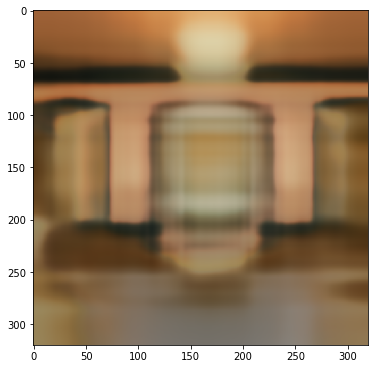

Iteracion 00151    Perdida 0.013955 

Iteracion 00152    Perdida 0.013519 

Iteracion 00153    Perdida 0.013464 

Iteracion 00154    Perdida 0.013428 

Iteracion 00155    Perdida 0.013335 

Iteracion 00156    Perdida 0.013317 

Iteracion 00157    Perdida 0.013141 

Iteracion 00158    Perdida 0.013158 

Iteracion 00159    Perdida 0.012980 

Iteracion 00160    Perdida 0.012959 

Iteracion 00161    Perdida 0.012961 

Iteracion 00162    Perdida 0.012810 

Iteracion 00163    Perdida 0.012815 

Iteracion 00164    Perdida 0.012702 

Iteracion 00165    Perdida 0.012846 

Iteracion 00166    Perdida 0.012932 

Iteracion 00167    Perdida 0.013025 

Iteracion 00168    Perdida 0.013176 

Iteracion 00169    Perdida 0.012852 

Iteracion 00170    Perdida 0.013229 

Iteracion 00171    Perdida 0.013706 

Iteracion 00172    Perdida 0.012813 

Iteracion 00173    Perdida 0.013343 

Iteracion 00174    Perdida 0.012813 

Iteracion 00175    Perdida 0.012764 

Iteracion 00176    Perdida 0.012827 

Iteracion 00

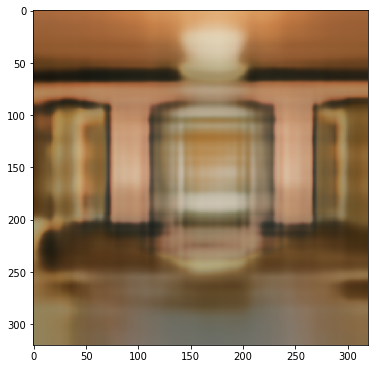

Iteracion 00201    Perdida 0.012180 

Iteracion 00202    Perdida 0.012068 

Iteracion 00203    Perdida 0.012149 

Iteracion 00204    Perdida 0.011995 

Iteracion 00205    Perdida 0.011767 

Iteracion 00206    Perdida 0.011877 

Iteracion 00207    Perdida 0.011832 

Iteracion 00208    Perdida 0.011851 

Iteracion 00209    Perdida 0.011953 

Iteracion 00210    Perdida 0.011983 

Iteracion 00211    Perdida 0.011911 

Iteracion 00212    Perdida 0.011931 

Iteracion 00213    Perdida 0.011811 

Iteracion 00214    Perdida 0.011636 

Iteracion 00215    Perdida 0.011586 

Iteracion 00216    Perdida 0.011631 

Iteracion 00217    Perdida 0.011602 

Iteracion 00218    Perdida 0.011619 

Iteracion 00219    Perdida 0.011707 

Iteracion 00220    Perdida 0.012216 

Iteracion 00221    Perdida 0.011860 

Iteracion 00222    Perdida 0.011669 

Iteracion 00223    Perdida 0.011874 

Iteracion 00224    Perdida 0.011840 

Iteracion 00225    Perdida 0.011623 

Iteracion 00226    Perdida 0.011633 

Iteracion 00

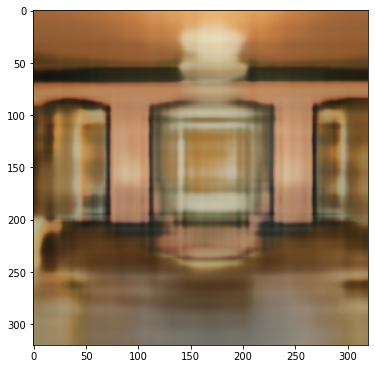

Iteracion 00251    Perdida 0.012854 

Iteracion 00252    Perdida 0.014119 

Iteracion 00253    Perdida 0.012673 

Iteracion 00254    Perdida 0.012747 

Iteracion 00255    Perdida 0.012829 

Iteracion 00256    Perdida 0.012396 

Iteracion 00257    Perdida 0.012352 

Iteracion 00258    Perdida 0.012352 

Iteracion 00259    Perdida 0.011982 

Iteracion 00260    Perdida 0.011969 

Iteracion 00261    Perdida 0.012005 

Iteracion 00262    Perdida 0.011695 

Iteracion 00263    Perdida 0.011694 

Iteracion 00264    Perdida 0.011570 

Iteracion 00265    Perdida 0.011392 

Iteracion 00266    Perdida 0.011531 

Iteracion 00267    Perdida 0.011534 

Iteracion 00268    Perdida 0.011375 

Iteracion 00269    Perdida 0.011220 

Iteracion 00270    Perdida 0.011297 

Iteracion 00271    Perdida 0.011188 

Iteracion 00272    Perdida 0.010981 

Iteracion 00273    Perdida 0.011062 

Iteracion 00274    Perdida 0.011107 

Iteracion 00275    Perdida 0.010935 

Iteracion 00276    Perdida 0.010754 

Iteracion 00

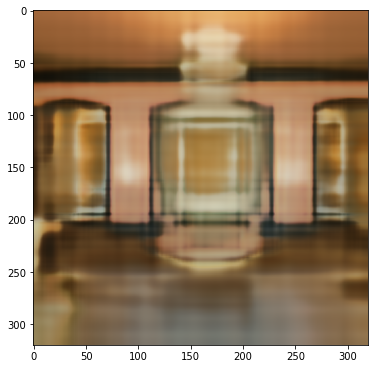

Iteracion 00301    Perdida 0.010231 

Iteracion 00302    Perdida 0.010300 

Iteracion 00303    Perdida 0.010246 

Iteracion 00304    Perdida 0.010063 

Iteracion 00305    Perdida 0.010245 

Iteracion 00306    Perdida 0.010165 

Iteracion 00307    Perdida 0.010277 

Iteracion 00308    Perdida 0.010208 

Iteracion 00309    Perdida 0.010214 

Iteracion 00310    Perdida 0.010272 

Iteracion 00311    Perdida 0.010258 

Iteracion 00312    Perdida 0.010891 

Iteracion 00313    Perdida 0.010546 

Iteracion 00314    Perdida 0.010070 

Iteracion 00315    Perdida 0.010338 

Iteracion 00316    Perdida 0.010086 

Iteracion 00317    Perdida 0.010152 

Iteracion 00318    Perdida 0.010141 

Iteracion 00319    Perdida 0.009993 

Iteracion 00320    Perdida 0.009989 

Iteracion 00321    Perdida 0.009917 

Iteracion 00322    Perdida 0.010106 

Iteracion 00323    Perdida 0.010092 

Iteracion 00324    Perdida 0.010483 

Iteracion 00325    Perdida 0.010944 

Iteracion 00326    Perdida 0.010319 

Iteracion 00

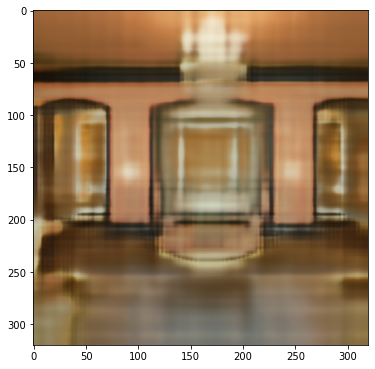

Iteracion 00351    Perdida 0.009933 

Iteracion 00352    Perdida 0.009868 

Iteracion 00353    Perdida 0.009700 

Iteracion 00354    Perdida 0.009533 

Iteracion 00355    Perdida 0.009597 

Iteracion 00356    Perdida 0.009521 

Iteracion 00357    Perdida 0.009356 

Iteracion 00358    Perdida 0.009354 

Iteracion 00359    Perdida 0.009314 

Iteracion 00360    Perdida 0.009373 

Iteracion 00361    Perdida 0.009216 

Iteracion 00362    Perdida 0.009283 

Iteracion 00363    Perdida 0.009205 

Iteracion 00364    Perdida 0.009227 

Iteracion 00365    Perdida 0.009247 

Iteracion 00366    Perdida 0.009197 

Iteracion 00367    Perdida 0.009264 

Iteracion 00368    Perdida 0.009514 

Iteracion 00369    Perdida 0.009211 

Iteracion 00370    Perdida 0.009731 

Iteracion 00371    Perdida 0.009413 

Iteracion 00372    Perdida 0.009366 

Iteracion 00373    Perdida 0.009371 

Iteracion 00374    Perdida 0.009144 

Iteracion 00375    Perdida 0.009111 

Iteracion 00376    Perdida 0.009200 

Iteracion 00

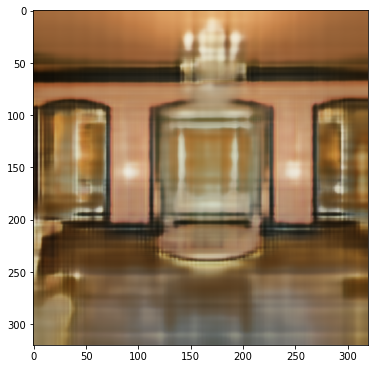

Iteracion 00401    Perdida 0.008457 

Iteracion 00402    Perdida 0.008665 

Iteracion 00403    Perdida 0.008522 

Iteracion 00404    Perdida 0.008484 

Iteracion 00405    Perdida 0.008491 

Iteracion 00406    Perdida 0.008443 

Iteracion 00407    Perdida 0.008485 

Iteracion 00408    Perdida 0.008455 

Iteracion 00409    Perdida 0.008552 

Iteracion 00410    Perdida 0.008971 

Iteracion 00411    Perdida 0.008496 

Iteracion 00412    Perdida 0.008558 

Iteracion 00413    Perdida 0.008697 

Iteracion 00414    Perdida 0.008552 

Iteracion 00415    Perdida 0.008351 

Iteracion 00416    Perdida 0.008564 

Iteracion 00417    Perdida 0.008546 

Iteracion 00418    Perdida 0.008471 

Iteracion 00419    Perdida 0.008514 

Iteracion 00420    Perdida 0.008519 

Iteracion 00421    Perdida 0.008758 

Iteracion 00422    Perdida 0.008788 

Iteracion 00423    Perdida 0.008583 

Iteracion 00424    Perdida 0.008495 

Iteracion 00425    Perdida 0.008725 

Iteracion 00426    Perdida 0.008779 

Iteracion 00

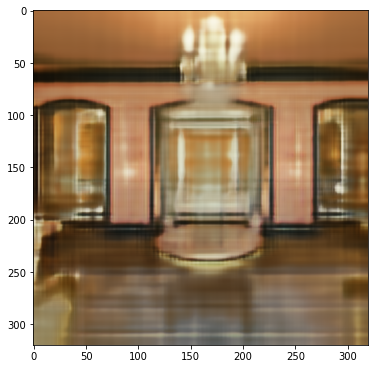

Iteracion 00451    Perdida 0.007942 

Iteracion 00452    Perdida 0.007831 

Iteracion 00453    Perdida 0.008006 

Iteracion 00454    Perdida 0.007733 

Iteracion 00455    Perdida 0.007788 

Iteracion 00456    Perdida 0.007736 

Iteracion 00457    Perdida 0.007678 

Iteracion 00458    Perdida 0.007672 

Iteracion 00459    Perdida 0.007993 

Iteracion 00460    Perdida 0.008616 

Iteracion 00461    Perdida 0.008646 

Iteracion 00462    Perdida 0.008527 

Iteracion 00463    Perdida 0.008002 

Iteracion 00464    Perdida 0.008292 

Iteracion 00465    Perdida 0.007754 

Iteracion 00466    Perdida 0.007881 

Iteracion 00467    Perdida 0.007755 

Iteracion 00468    Perdida 0.007609 

Iteracion 00469    Perdida 0.007774 

Iteracion 00470    Perdida 0.007530 

Iteracion 00471    Perdida 0.007621 

Iteracion 00472    Perdida 0.007368 

Iteracion 00473    Perdida 0.007451 

Iteracion 00474    Perdida 0.007455 

Iteracion 00475    Perdida 0.007463 

Iteracion 00476    Perdida 0.007762 

Iteracion 00

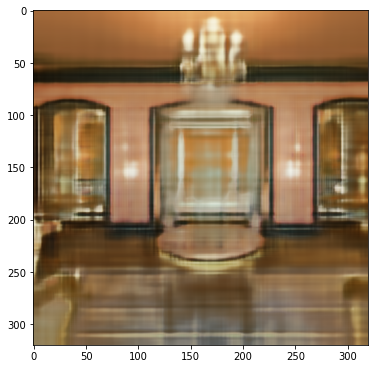

Iteracion 00501    Perdida 0.007461 

Iteracion 00502    Perdida 0.007548 

Iteracion 00503    Perdida 0.007161 

Iteracion 00504    Perdida 0.007232 

Iteracion 00505    Perdida 0.007137 

Iteracion 00506    Perdida 0.007106 

Iteracion 00507    Perdida 0.007009 

Iteracion 00508    Perdida 0.006957 

Iteracion 00509    Perdida 0.006957 

Iteracion 00510    Perdida 0.006891 

Iteracion 00511    Perdida 0.006879 

Iteracion 00512    Perdida 0.006784 

Iteracion 00513    Perdida 0.006673 

Iteracion 00514    Perdida 0.006689 

Iteracion 00515    Perdida 0.006737 

Iteracion 00516    Perdida 0.006773 

Iteracion 00517    Perdida 0.006763 

Iteracion 00518    Perdida 0.006991 

Iteracion 00519    Perdida 0.007191 

Iteracion 00520    Perdida 0.007312 

Iteracion 00521    Perdida 0.007177 

Iteracion 00522    Perdida 0.007160 

Iteracion 00523    Perdida 0.007003 

Iteracion 00524    Perdida 0.006725 

Iteracion 00525    Perdida 0.006819 

Iteracion 00526    Perdida 0.006704 

Iteracion 00

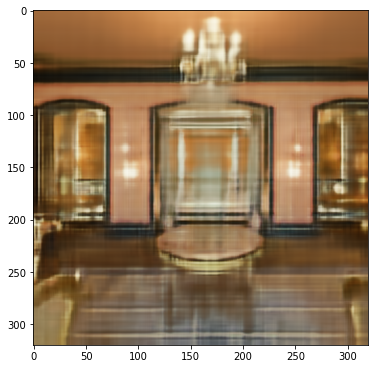

Iteracion 00551    Perdida 0.006581 

Iteracion 00552    Perdida 0.006412 

Iteracion 00553    Perdida 0.006414 

Iteracion 00554    Perdida 0.006334 

Iteracion 00555    Perdida 0.006237 

Iteracion 00556    Perdida 0.006183 

Iteracion 00557    Perdida 0.006140 

Iteracion 00558    Perdida 0.006124 

Iteracion 00559    Perdida 0.006112 

Iteracion 00560    Perdida 0.006047 

Iteracion 00561    Perdida 0.006163 

Iteracion 00562    Perdida 0.006437 

Iteracion 00563    Perdida 0.006672 

Iteracion 00564    Perdida 0.006589 

Iteracion 00565    Perdida 0.006214 

Iteracion 00566    Perdida 0.006306 

Iteracion 00567    Perdida 0.006317 

Iteracion 00568    Perdida 0.006212 

Iteracion 00569    Perdida 0.006073 

Iteracion 00570    Perdida 0.006146 

Iteracion 00571    Perdida 0.005982 

Iteracion 00572    Perdida 0.005952 

Iteracion 00573    Perdida 0.005826 

Iteracion 00574    Perdida 0.005926 

Iteracion 00575    Perdida 0.005813 

Iteracion 00576    Perdida 0.005811 

Iteracion 00

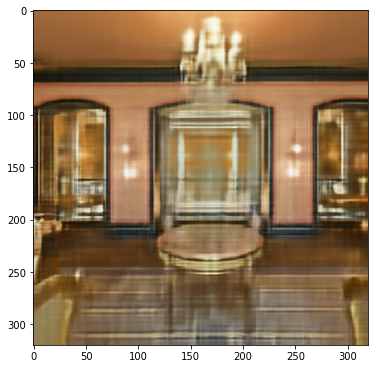

Iteracion 00601    Perdida 0.005759 

Iteracion 00602    Perdida 0.005785 

Iteracion 00603    Perdida 0.005667 

Iteracion 00604    Perdida 0.005591 

Iteracion 00605    Perdida 0.005575 

Iteracion 00606    Perdida 0.005500 

Iteracion 00607    Perdida 0.005502 

Iteracion 00608    Perdida 0.005428 

Iteracion 00609    Perdida 0.005434 

Iteracion 00610    Perdida 0.005393 

Iteracion 00611    Perdida 0.005457 

Iteracion 00612    Perdida 0.005456 

Iteracion 00613    Perdida 0.005466 

Iteracion 00614    Perdida 0.005427 

Iteracion 00615    Perdida 0.005371 

Iteracion 00616    Perdida 0.005308 

Iteracion 00617    Perdida 0.005270 

Iteracion 00618    Perdida 0.005276 

Iteracion 00619    Perdida 0.005274 

Iteracion 00620    Perdida 0.005282 

Iteracion 00621    Perdida 0.005340 

Iteracion 00622    Perdida 0.005248 

Iteracion 00623    Perdida 0.005370 

Iteracion 00624    Perdida 0.005435 

Iteracion 00625    Perdida 0.005447 

Iteracion 00626    Perdida 0.005628 

Iteracion 00

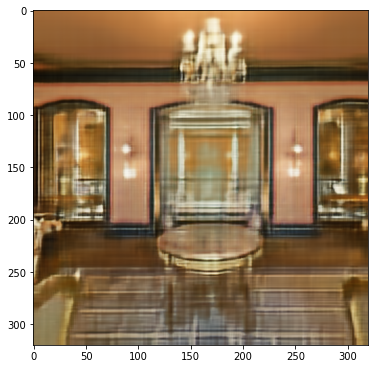

Iteracion 00651    Perdida 0.005141 

Iteracion 00652    Perdida 0.005067 

Iteracion 00653    Perdida 0.005052 

Iteracion 00654    Perdida 0.004990 

Iteracion 00655    Perdida 0.004953 

Iteracion 00656    Perdida 0.004931 

Iteracion 00657    Perdida 0.004935 

Iteracion 00658    Perdida 0.004915 

Iteracion 00659    Perdida 0.004885 

Iteracion 00660    Perdida 0.004783 

Iteracion 00661    Perdida 0.004768 

Iteracion 00662    Perdida 0.004752 

Iteracion 00663    Perdida 0.004722 

Iteracion 00664    Perdida 0.004764 

Iteracion 00665    Perdida 0.004789 

Iteracion 00666    Perdida 0.004784 

Iteracion 00667    Perdida 0.005068 

Iteracion 00668    Perdida 0.005626 

Iteracion 00669    Perdida 0.006022 

Iteracion 00670    Perdida 0.005833 

Iteracion 00671    Perdida 0.005481 

Iteracion 00672    Perdida 0.005553 

Iteracion 00673    Perdida 0.005384 

Iteracion 00674    Perdida 0.005294 

Iteracion 00675    Perdida 0.005336 

Iteracion 00676    Perdida 0.005257 

Iteracion 00

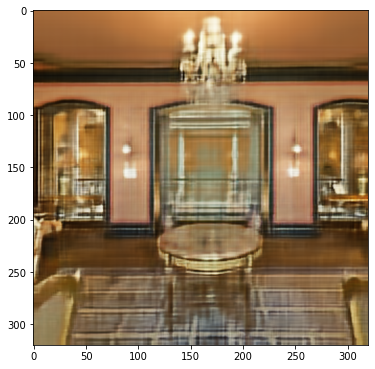

Iteracion 00701    Perdida 0.004564 

Iteracion 00702    Perdida 0.004431 

Iteracion 00703    Perdida 0.004473 

Iteracion 00704    Perdida 0.004610 

Iteracion 00705    Perdida 0.004420 

Iteracion 00706    Perdida 0.004409 

Iteracion 00707    Perdida 0.004546 

Iteracion 00708    Perdida 0.004391 

Iteracion 00709    Perdida 0.004385 

Iteracion 00710    Perdida 0.004406 

Iteracion 00711    Perdida 0.004352 

Iteracion 00712    Perdida 0.004384 

Iteracion 00713    Perdida 0.004487 

Iteracion 00714    Perdida 0.004680 

Iteracion 00715    Perdida 0.004941 

Iteracion 00716    Perdida 0.005081 

Iteracion 00717    Perdida 0.005069 

Iteracion 00718    Perdida 0.004838 

Iteracion 00719    Perdida 0.004900 

Iteracion 00720    Perdida 0.004888 

Iteracion 00721    Perdida 0.004710 

Iteracion 00722    Perdida 0.004663 

Iteracion 00723    Perdida 0.004571 

Iteracion 00724    Perdida 0.004563 

Iteracion 00725    Perdida 0.004412 

Iteracion 00726    Perdida 0.004429 

Iteracion 00

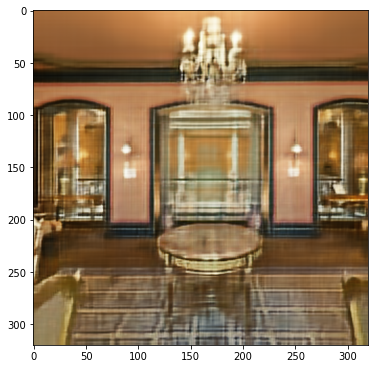

Iteracion 00751    Perdida 0.004155 

Iteracion 00752    Perdida 0.004134 

Iteracion 00753    Perdida 0.004076 

Iteracion 00754    Perdida 0.004091 

Iteracion 00755    Perdida 0.004019 

Iteracion 00756    Perdida 0.003992 

Iteracion 00757    Perdida 0.003960 

Iteracion 00758    Perdida 0.003904 

Iteracion 00759    Perdida 0.003875 

Iteracion 00760    Perdida 0.003836 

Iteracion 00761    Perdida 0.003837 

Iteracion 00762    Perdida 0.003910 

Iteracion 00763    Perdida 0.003913 

Iteracion 00764    Perdida 0.003922 

Iteracion 00765    Perdida 0.003915 

Iteracion 00766    Perdida 0.003855 

Iteracion 00767    Perdida 0.003828 

Iteracion 00768    Perdida 0.003797 

Iteracion 00769    Perdida 0.003920 

Iteracion 00770    Perdida 0.003976 

Iteracion 00771    Perdida 0.003893 

Iteracion 00772    Perdida 0.004011 

Iteracion 00773    Perdida 0.004181 

Iteracion 00774    Perdida 0.004275 

Iteracion 00775    Perdida 0.004815 

Iteracion 00776    Perdida 0.005079 

Iteracion 00

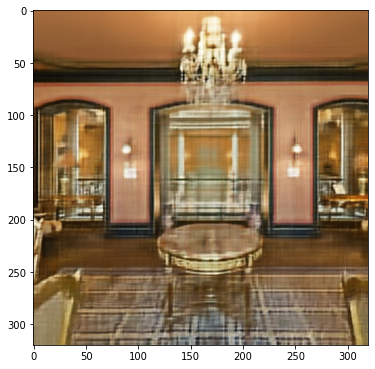

Iteracion 00801    Perdida 0.003683 

Iteracion 00802    Perdida 0.003637 

Iteracion 00803    Perdida 0.003759 

Iteracion 00804    Perdida 0.003645 

Iteracion 00805    Perdida 0.003672 

Iteracion 00806    Perdida 0.003843 

Iteracion 00807    Perdida 0.003739 

Iteracion 00808    Perdida 0.003753 

Iteracion 00809    Perdida 0.003693 

Iteracion 00810    Perdida 0.003553 

Iteracion 00811    Perdida 0.003604 

Iteracion 00812    Perdida 0.003629 

Iteracion 00813    Perdida 0.003621 

Iteracion 00814    Perdida 0.003569 

Iteracion 00815    Perdida 0.003472 

Iteracion 00816    Perdida 0.003489 

Iteracion 00817    Perdida 0.003503 

Iteracion 00818    Perdida 0.003496 

Iteracion 00819    Perdida 0.003550 

Iteracion 00820    Perdida 0.003578 

Iteracion 00821    Perdida 0.003661 

Iteracion 00822    Perdida 0.003799 

Iteracion 00823    Perdida 0.003889 

Iteracion 00824    Perdida 0.003635 

Iteracion 00825    Perdida 0.003787 

Iteracion 00826    Perdida 0.003719 

Iteracion 00

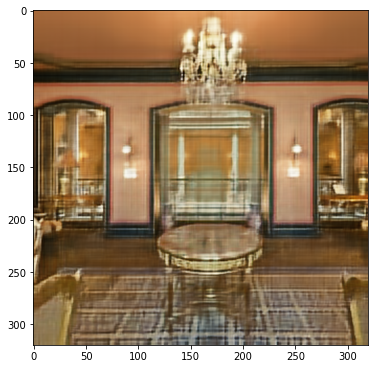

Iteracion 00851    Perdida 0.003959 

Iteracion 00852    Perdida 0.003768 

Iteracion 00853    Perdida 0.003696 

Iteracion 00854    Perdida 0.003655 

Iteracion 00855    Perdida 0.003551 

Iteracion 00856    Perdida 0.003520 

Iteracion 00857    Perdida 0.003423 

Iteracion 00858    Perdida 0.003391 

Iteracion 00859    Perdida 0.003335 

Iteracion 00860    Perdida 0.003285 

Iteracion 00861    Perdida 0.003289 

Iteracion 00862    Perdida 0.003160 

Iteracion 00863    Perdida 0.003171 

Iteracion 00864    Perdida 0.003127 

Iteracion 00865    Perdida 0.003069 

Iteracion 00866    Perdida 0.003094 

Iteracion 00867    Perdida 0.003031 

Iteracion 00868    Perdida 0.003003 

Iteracion 00869    Perdida 0.002974 

Iteracion 00870    Perdida 0.002952 

Iteracion 00871    Perdida 0.002910 

Iteracion 00872    Perdida 0.002932 

Iteracion 00873    Perdida 0.002936 

Iteracion 00874    Perdida 0.002935 

Iteracion 00875    Perdida 0.002936 

Iteracion 00876    Perdida 0.002959 

Iteracion 00

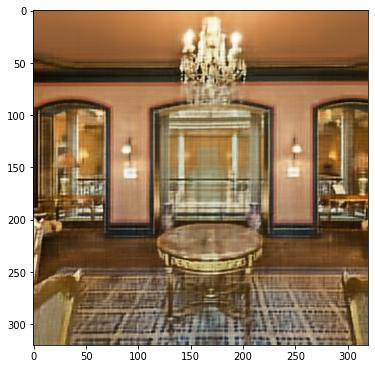

Iteracion 00901    Perdida 0.002815 

Iteracion 00902    Perdida 0.002965 

Iteracion 00903    Perdida 0.003055 

Iteracion 00904    Perdida 0.003209 

Iteracion 00905    Perdida 0.003292 

Iteracion 00906    Perdida 0.003320 

Iteracion 00907    Perdida 0.003196 

Iteracion 00908    Perdida 0.003044 

Iteracion 00909    Perdida 0.003097 

Iteracion 00910    Perdida 0.002924 

Iteracion 00911    Perdida 0.002948 

Iteracion 00912    Perdida 0.002934 

Iteracion 00913    Perdida 0.002832 

Iteracion 00914    Perdida 0.002833 

Iteracion 00915    Perdida 0.002810 

Iteracion 00916    Perdida 0.002729 

Iteracion 00917    Perdida 0.002774 

Iteracion 00918    Perdida 0.002746 

Iteracion 00919    Perdida 0.002683 

Iteracion 00920    Perdida 0.002702 

Iteracion 00921    Perdida 0.002650 

Iteracion 00922    Perdida 0.002706 

Iteracion 00923    Perdida 0.002713 

Iteracion 00924    Perdida 0.002783 

Iteracion 00925    Perdida 0.002709 

Iteracion 00926    Perdida 0.002715 

Iteracion 00

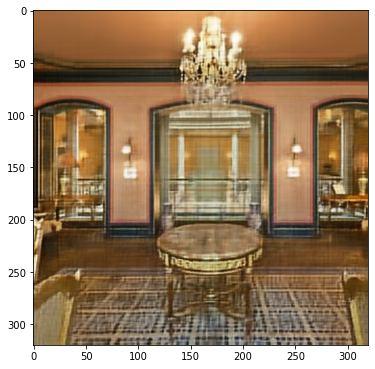

Iteracion 00951    Perdida 0.002693 

Iteracion 00952    Perdida 0.002633 

Iteracion 00953    Perdida 0.002640 

Iteracion 00954    Perdida 0.002581 

Iteracion 00955    Perdida 0.002544 

Iteracion 00956    Perdida 0.002476 

Iteracion 00957    Perdida 0.002473 

Iteracion 00958    Perdida 0.002460 

Iteracion 00959    Perdida 0.002406 

Iteracion 00960    Perdida 0.002403 

Iteracion 00961    Perdida 0.002402 

Iteracion 00962    Perdida 0.002469 

Iteracion 00963    Perdida 0.002610 

Iteracion 00964    Perdida 0.002668 

Iteracion 00965    Perdida 0.002579 

Iteracion 00966    Perdida 0.002523 

Iteracion 00967    Perdida 0.002627 

Iteracion 00968    Perdida 0.002528 

Iteracion 00969    Perdida 0.002424 

Iteracion 00970    Perdida 0.002424 

Iteracion 00971    Perdida 0.002456 

Iteracion 00972    Perdida 0.002367 

Iteracion 00973    Perdida 0.002374 

Iteracion 00974    Perdida 0.002362 

Iteracion 00975    Perdida 0.002374 

Iteracion 00976    Perdida 0.002312 

Iteracion 00

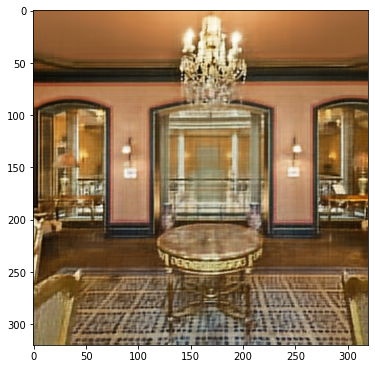

Iteracion 01001    Perdida 0.002165 

Iteracion 01002    Perdida 0.002156 

Iteracion 01003    Perdida 0.002175 

Iteracion 01004    Perdida 0.002143 

Iteracion 01005    Perdida 0.002228 

Iteracion 01006    Perdida 0.002226 

Iteracion 01007    Perdida 0.002277 

Iteracion 01008    Perdida 0.002239 

Iteracion 01009    Perdida 0.002353 

Iteracion 01010    Perdida 0.002467 

Iteracion 01011    Perdida 0.002599 

Iteracion 01012    Perdida 0.002453 

Iteracion 01013    Perdida 0.002279 

Iteracion 01014    Perdida 0.002295 

Iteracion 01015    Perdida 0.002280 

Iteracion 01016    Perdida 0.002242 

Iteracion 01017    Perdida 0.002183 

Iteracion 01018    Perdida 0.002222 

Iteracion 01019    Perdida 0.002197 

Iteracion 01020    Perdida 0.002191 

Iteracion 01021    Perdida 0.002199 

Iteracion 01022    Perdida 0.002177 

Iteracion 01023    Perdida 0.002175 

Iteracion 01024    Perdida 0.002187 

Iteracion 01025    Perdida 0.002207 

Iteracion 01026    Perdida 0.002091 

Iteracion 01

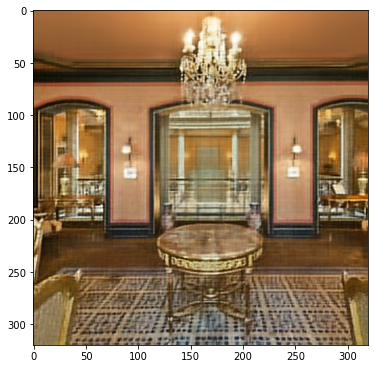

Iteracion 01051    Perdida 0.002013 

Iteracion 01052    Perdida 0.001972 

Iteracion 01053    Perdida 0.001957 

Iteracion 01054    Perdida 0.001905 

Iteracion 01055    Perdida 0.001908 

Iteracion 01056    Perdida 0.001896 

Iteracion 01057    Perdida 0.001959 

Iteracion 01058    Perdida 0.001942 

Iteracion 01059    Perdida 0.001984 

Iteracion 01060    Perdida 0.002054 

Iteracion 01061    Perdida 0.001969 

Iteracion 01062    Perdida 0.002025 

Iteracion 01063    Perdida 0.002155 

Iteracion 01064    Perdida 0.002225 

Iteracion 01065    Perdida 0.002184 

Iteracion 01066    Perdida 0.002242 

Iteracion 01067    Perdida 0.002221 

Iteracion 01068    Perdida 0.002228 

Iteracion 01069    Perdida 0.002163 

Iteracion 01070    Perdida 0.002118 

Iteracion 01071    Perdida 0.002100 

Iteracion 01072    Perdida 0.002065 

Iteracion 01073    Perdida 0.002039 

Iteracion 01074    Perdida 0.001946 

Iteracion 01075    Perdida 0.001958 

Iteracion 01076    Perdida 0.001969 

Iteracion 01

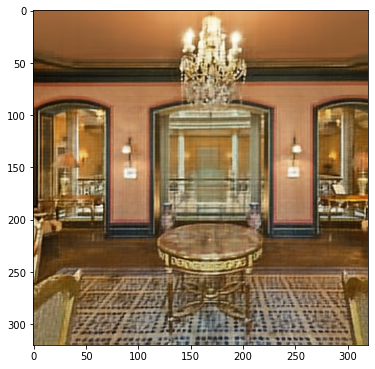

Iteracion 01101    Perdida 0.002126 

Iteracion 01102    Perdida 0.002102 

Iteracion 01103    Perdida 0.002039 

Iteracion 01104    Perdida 0.001885 

Iteracion 01105    Perdida 0.001908 

Iteracion 01106    Perdida 0.001973 

Iteracion 01107    Perdida 0.001808 

Iteracion 01108    Perdida 0.001846 

Iteracion 01109    Perdida 0.001834 

Iteracion 01110    Perdida 0.001770 

Iteracion 01111    Perdida 0.001810 

Iteracion 01112    Perdida 0.001771 

Iteracion 01113    Perdida 0.001752 

Iteracion 01114    Perdida 0.001733 

Iteracion 01115    Perdida 0.001704 

Iteracion 01116    Perdida 0.001680 

Iteracion 01117    Perdida 0.001654 

Iteracion 01118    Perdida 0.001614 

Iteracion 01119    Perdida 0.001625 

Iteracion 01120    Perdida 0.001624 

Iteracion 01121    Perdida 0.001606 

Iteracion 01122    Perdida 0.001617 

Iteracion 01123    Perdida 0.001635 

Iteracion 01124    Perdida 0.001652 

Iteracion 01125    Perdida 0.001776 

Iteracion 01126    Perdida 0.001909 

Iteracion 01

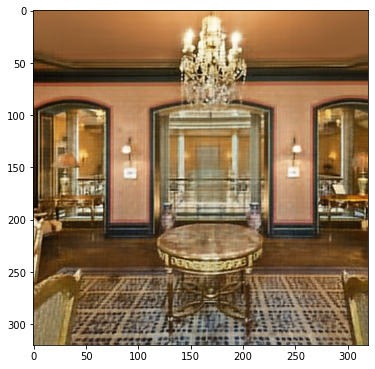

Iteracion 01151    Perdida 0.001847 

Iteracion 01152    Perdida 0.001909 

Iteracion 01153    Perdida 0.001863 

Iteracion 01154    Perdida 0.001889 

Iteracion 01155    Perdida 0.001946 

Iteracion 01156    Perdida 0.001843 

Iteracion 01157    Perdida 0.001918 

Iteracion 01158    Perdida 0.001863 

Iteracion 01159    Perdida 0.001690 

Iteracion 01160    Perdida 0.001736 

Iteracion 01161    Perdida 0.001727 

Iteracion 01162    Perdida 0.001651 

Iteracion 01163    Perdida 0.001593 

Iteracion 01164    Perdida 0.001614 

Iteracion 01165    Perdida 0.001557 

Iteracion 01166    Perdida 0.001560 

Iteracion 01167    Perdida 0.001557 

Iteracion 01168    Perdida 0.001540 

Iteracion 01169    Perdida 0.001590 

Iteracion 01170    Perdida 0.001640 

Iteracion 01171    Perdida 0.001665 

Iteracion 01172    Perdida 0.001672 

Iteracion 01173    Perdida 0.001644 

Iteracion 01174    Perdida 0.001750 

Iteracion 01175    Perdida 0.001744 

Iteracion 01176    Perdida 0.001735 

Iteracion 01

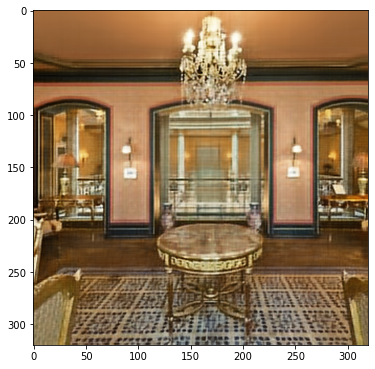

Iteracion 01201    Perdida 0.001482 

Iteracion 01202    Perdida 0.001587 

Iteracion 01203    Perdida 0.001666 

Iteracion 01204    Perdida 0.001730 

Iteracion 01205    Perdida 0.001580 

Iteracion 01206    Perdida 0.001491 

Iteracion 01207    Perdida 0.001639 

Iteracion 01208    Perdida 0.001602 

Iteracion 01209    Perdida 0.001529 

Iteracion 01210    Perdida 0.001542 

Iteracion 01211    Perdida 0.001613 

Iteracion 01212    Perdida 0.001604 

Iteracion 01213    Perdida 0.001567 

Iteracion 01214    Perdida 0.001595 

Iteracion 01215    Perdida 0.001524 

Iteracion 01216    Perdida 0.001408 

Iteracion 01217    Perdida 0.001479 

Iteracion 01218    Perdida 0.001479 

Iteracion 01219    Perdida 0.001388 

Iteracion 01220    Perdida 0.001397 

Iteracion 01221    Perdida 0.001433 

Iteracion 01222    Perdida 0.001345 

Iteracion 01223    Perdida 0.001360 

Iteracion 01224    Perdida 0.001361 

Iteracion 01225    Perdida 0.001334 

Iteracion 01226    Perdida 0.001326 

Iteracion 01

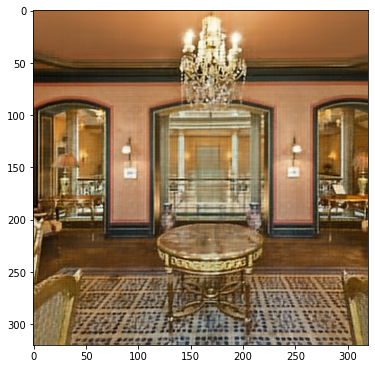

Iteracion 01251    Perdida 0.001486 

Iteracion 01252    Perdida 0.001462 

Iteracion 01253    Perdida 0.001434 

Iteracion 01254    Perdida 0.001424 

Iteracion 01255    Perdida 0.001306 

Iteracion 01256    Perdida 0.001349 

Iteracion 01257    Perdida 0.001323 

Iteracion 01258    Perdida 0.001321 

Iteracion 01259    Perdida 0.001294 

Iteracion 01260    Perdida 0.001271 

Iteracion 01261    Perdida 0.001262 

Iteracion 01262    Perdida 0.001274 

Iteracion 01263    Perdida 0.001249 

Iteracion 01264    Perdida 0.001280 

Iteracion 01265    Perdida 0.001264 

Iteracion 01266    Perdida 0.001254 

Iteracion 01267    Perdida 0.001236 

Iteracion 01268    Perdida 0.001234 

Iteracion 01269    Perdida 0.001226 

Iteracion 01270    Perdida 0.001237 

Iteracion 01271    Perdida 0.001274 

Iteracion 01272    Perdida 0.001342 

Iteracion 01273    Perdida 0.001383 

Iteracion 01274    Perdida 0.001449 

Iteracion 01275    Perdida 0.001453 

Iteracion 01276    Perdida 0.001510 

Iteracion 01

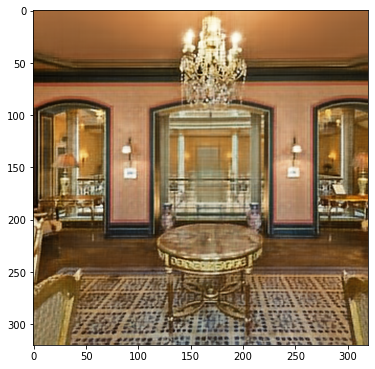

Iteracion 01301    Perdida 0.001195 

Iteracion 01302    Perdida 0.001153 

Iteracion 01303    Perdida 0.001193 

Iteracion 01304    Perdida 0.001167 

Iteracion 01305    Perdida 0.001144 

Iteracion 01306    Perdida 0.001155 

Iteracion 01307    Perdida 0.001134 

Iteracion 01308    Perdida 0.001123 

Iteracion 01309    Perdida 0.001094 

Iteracion 01310    Perdida 0.001129 

Iteracion 01311    Perdida 0.001129 

Iteracion 01312    Perdida 0.001136 

Iteracion 01313    Perdida 0.001157 

Iteracion 01314    Perdida 0.001165 

Iteracion 01315    Perdida 0.001169 

Iteracion 01316    Perdida 0.001191 

Iteracion 01317    Perdida 0.001155 

Iteracion 01318    Perdida 0.001167 

Iteracion 01319    Perdida 0.001162 

Iteracion 01320    Perdida 0.001183 

Iteracion 01321    Perdida 0.001176 

Iteracion 01322    Perdida 0.001178 

Iteracion 01323    Perdida 0.001278 

Iteracion 01324    Perdida 0.001473 

Iteracion 01325    Perdida 0.001508 

Iteracion 01326    Perdida 0.001541 

Iteracion 01

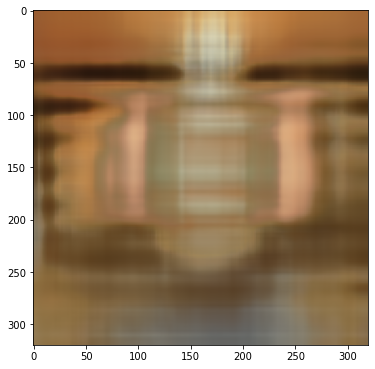

Iteracion 01351    Perdida 0.016710 

Iteracion 01352    Perdida 0.016439 

Iteracion 01353    Perdida 0.016223 

Iteracion 01354    Perdida 0.015576 

Iteracion 01355    Perdida 0.015287 

Iteracion 01356    Perdida 0.015098 

Iteracion 01357    Perdida 0.014597 

Iteracion 01358    Perdida 0.014499 

Iteracion 01359    Perdida 0.014299 

Iteracion 01360    Perdida 0.013964 

Iteracion 01361    Perdida 0.013731 

Iteracion 01362    Perdida 0.013492 

Iteracion 01363    Perdida 0.013214 

Iteracion 01364    Perdida 0.013134 

Iteracion 01365    Perdida 0.012846 

Iteracion 01366    Perdida 0.012704 

Iteracion 01367    Perdida 0.012433 

Iteracion 01368    Perdida 0.012321 

Iteracion 01369    Perdida 0.012206 

Iteracion 01370    Perdida 0.012023 

Iteracion 01371    Perdida 0.012094 

Iteracion 01372    Perdida 0.012594 

Iteracion 01373    Perdida 0.013551 

Iteracion 01374    Perdida 0.012012 

Iteracion 01375    Perdida 0.012519 

Iteracion 01376    Perdida 0.011894 

Iteracion 01

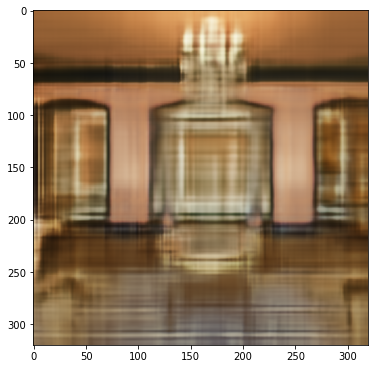

Iteracion 01401    Perdida 0.009041 

Iteracion 01402    Perdida 0.008925 

Iteracion 01403    Perdida 0.008915 

Iteracion 01404    Perdida 0.008798 

Iteracion 01405    Perdida 0.009134 

Iteracion 01406    Perdida 0.009172 

Iteracion 01407    Perdida 0.009365 

Iteracion 01408    Perdida 0.009302 

Iteracion 01409    Perdida 0.008844 

Iteracion 01410    Perdida 0.008897 

Iteracion 01411    Perdida 0.008717 

Iteracion 01412    Perdida 0.008617 

Iteracion 01413    Perdida 0.008542 

Iteracion 01414    Perdida 0.008363 

Iteracion 01415    Perdida 0.008330 

Iteracion 01416    Perdida 0.008243 

Iteracion 01417    Perdida 0.008141 

Iteracion 01418    Perdida 0.008129 

Iteracion 01419    Perdida 0.008016 

Iteracion 01420    Perdida 0.007901 

Iteracion 01421    Perdida 0.007812 

Iteracion 01422    Perdida 0.007789 

Iteracion 01423    Perdida 0.007704 

Iteracion 01424    Perdida 0.007716 

Iteracion 01425    Perdida 0.007625 

Iteracion 01426    Perdida 0.007507 

Iteracion 01

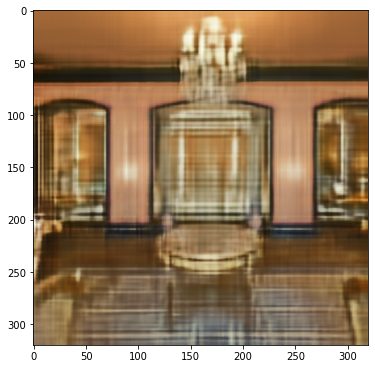

Iteracion 01451    Perdida 0.006646 

Iteracion 01452    Perdida 0.006893 

Iteracion 01453    Perdida 0.007144 

Iteracion 01454    Perdida 0.007051 

Iteracion 01455    Perdida 0.006941 

Iteracion 01456    Perdida 0.006610 

Iteracion 01457    Perdida 0.006641 

Iteracion 01458    Perdida 0.006615 

Iteracion 01459    Perdida 0.006671 

Iteracion 01460    Perdida 0.006407 

Iteracion 01461    Perdida 0.006476 

Iteracion 01462    Perdida 0.006353 

Iteracion 01463    Perdida 0.006353 

Iteracion 01464    Perdida 0.006284 

Iteracion 01465    Perdida 0.006125 

Iteracion 01466    Perdida 0.006192 

Iteracion 01467    Perdida 0.006091 

Iteracion 01468    Perdida 0.006112 

Iteracion 01469    Perdida 0.006084 

Iteracion 01470    Perdida 0.005990 

Iteracion 01471    Perdida 0.005927 

Iteracion 01472    Perdida 0.005886 

Iteracion 01473    Perdida 0.005759 

Iteracion 01474    Perdida 0.005784 

Iteracion 01475    Perdida 0.005681 

Iteracion 01476    Perdida 0.005745 

Iteracion 01

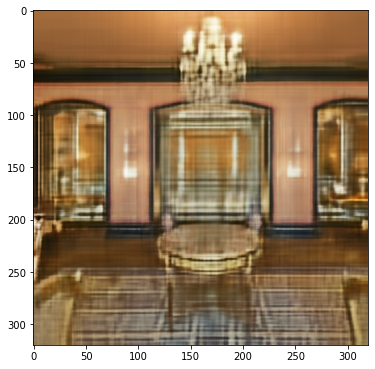

Iteracion 01501    Perdida 0.005242 

Iteracion 01502    Perdida 0.005131 

Iteracion 01503    Perdida 0.005057 

Iteracion 01504    Perdida 0.005032 

Iteracion 01505    Perdida 0.005083 

Iteracion 01506    Perdida 0.005068 

Iteracion 01507    Perdida 0.005178 

Iteracion 01508    Perdida 0.005342 

Iteracion 01509    Perdida 0.005400 

Iteracion 01510    Perdida 0.005125 

Iteracion 01511    Perdida 0.005049 

Iteracion 01512    Perdida 0.005175 

Iteracion 01513    Perdida 0.005104 

Iteracion 01514    Perdida 0.005194 

Iteracion 01515    Perdida 0.005039 

Iteracion 01516    Perdida 0.004983 

Iteracion 01517    Perdida 0.004892 

Iteracion 01518    Perdida 0.004864 

Iteracion 01519    Perdida 0.004853 

Iteracion 01520    Perdida 0.004827 

Iteracion 01521    Perdida 0.004688 

Iteracion 01522    Perdida 0.004643 

Iteracion 01523    Perdida 0.004609 

Iteracion 01524    Perdida 0.004617 

Iteracion 01525    Perdida 0.004677 

Iteracion 01526    Perdida 0.004810 

Iteracion 01

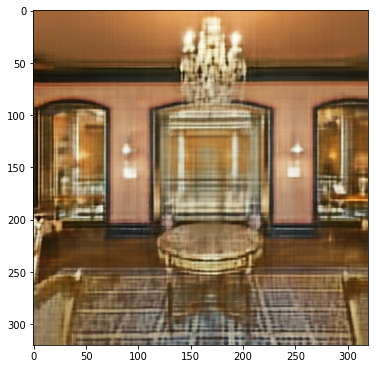

Iteracion 01551    Perdida 0.004195 

Iteracion 01552    Perdida 0.004209 

Iteracion 01553    Perdida 0.004225 

Iteracion 01554    Perdida 0.004271 

Iteracion 01555    Perdida 0.004191 

Iteracion 01556    Perdida 0.004137 

Iteracion 01557    Perdida 0.004197 

Iteracion 01558    Perdida 0.004197 

Iteracion 01559    Perdida 0.004261 

Iteracion 01560    Perdida 0.004126 

Iteracion 01561    Perdida 0.004227 

Iteracion 01562    Perdida 0.004122 

Iteracion 01563    Perdida 0.004177 

Iteracion 01564    Perdida 0.004119 

Iteracion 01565    Perdida 0.004014 

Iteracion 01566    Perdida 0.004010 

Iteracion 01567    Perdida 0.003985 

Iteracion 01568    Perdida 0.003918 

Iteracion 01569    Perdida 0.003916 

Iteracion 01570    Perdida 0.003923 

Iteracion 01571    Perdida 0.003860 

Iteracion 01572    Perdida 0.003857 

Iteracion 01573    Perdida 0.003715 

Iteracion 01574    Perdida 0.003722 

Iteracion 01575    Perdida 0.003768 

Iteracion 01576    Perdida 0.003731 

Iteracion 01

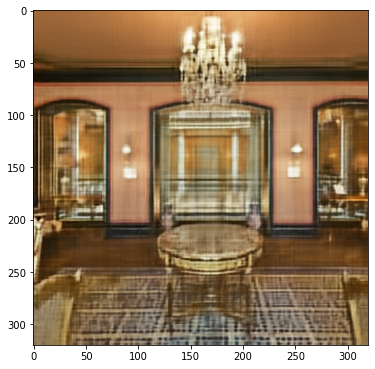

Iteracion 01601    Perdida 0.003674 

Iteracion 01602    Perdida 0.003615 

Iteracion 01603    Perdida 0.003567 

Iteracion 01604    Perdida 0.003504 

Iteracion 01605    Perdida 0.003496 

Iteracion 01606    Perdida 0.003402 

Iteracion 01607    Perdida 0.003396 

Iteracion 01608    Perdida 0.003359 

Iteracion 01609    Perdida 0.003296 

Iteracion 01610    Perdida 0.003227 

Iteracion 01611    Perdida 0.003220 

Iteracion 01612    Perdida 0.003183 

Iteracion 01613    Perdida 0.003147 

Iteracion 01614    Perdida 0.003130 

Iteracion 01615    Perdida 0.003115 

Iteracion 01616    Perdida 0.003075 

Iteracion 01617    Perdida 0.003073 

Iteracion 01618    Perdida 0.003140 

Iteracion 01619    Perdida 0.003235 

Iteracion 01620    Perdida 0.003351 

Iteracion 01621    Perdida 0.003425 

Iteracion 01622    Perdida 0.003276 

Iteracion 01623    Perdida 0.003239 

Iteracion 01624    Perdida 0.003315 

Iteracion 01625    Perdida 0.003282 

Iteracion 01626    Perdida 0.003100 

Iteracion 01

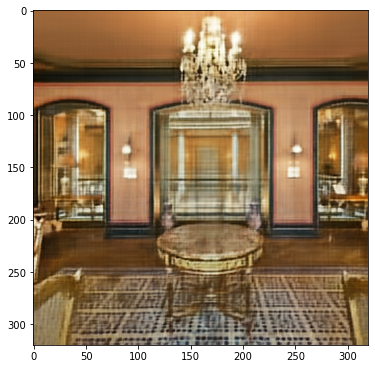

Iteracion 01651    Perdida 0.002804 

Iteracion 01652    Perdida 0.002851 

Iteracion 01653    Perdida 0.002802 

Iteracion 01654    Perdida 0.002775 

Iteracion 01655    Perdida 0.002828 

Iteracion 01656    Perdida 0.002718 

Iteracion 01657    Perdida 0.002649 

Iteracion 01658    Perdida 0.002644 

Iteracion 01659    Perdida 0.002710 

Iteracion 01660    Perdida 0.002713 

Iteracion 01661    Perdida 0.002655 

Iteracion 01662    Perdida 0.002588 

Iteracion 01663    Perdida 0.002583 

Iteracion 01664    Perdida 0.002637 

Iteracion 01665    Perdida 0.002738 

Iteracion 01666    Perdida 0.002898 

Iteracion 01667    Perdida 0.003015 

Iteracion 01668    Perdida 0.003448 

Iteracion 01669    Perdida 0.003453 

Iteracion 01670    Perdida 0.002890 

Iteracion 01671    Perdida 0.003070 

Iteracion 01672    Perdida 0.002829 

Iteracion 01673    Perdida 0.002925 

Iteracion 01674    Perdida 0.002815 

Iteracion 01675    Perdida 0.002734 

Iteracion 01676    Perdida 0.002729 

Iteracion 01

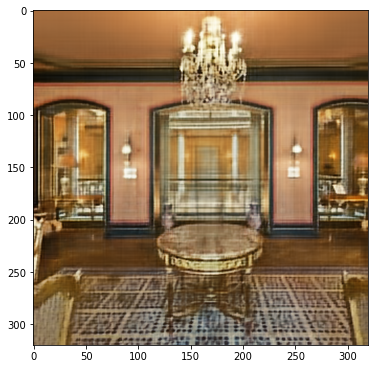

Iteracion 01701    Perdida 0.002367 

Iteracion 01702    Perdida 0.002286 

Iteracion 01703    Perdida 0.002382 

Iteracion 01704    Perdida 0.002464 

Iteracion 01705    Perdida 0.002425 

Iteracion 01706    Perdida 0.002323 

Iteracion 01707    Perdida 0.002320 

Iteracion 01708    Perdida 0.002393 

Iteracion 01709    Perdida 0.002282 

Iteracion 01710    Perdida 0.002272 

Iteracion 01711    Perdida 0.002299 

Iteracion 01712    Perdida 0.002305 

Iteracion 01713    Perdida 0.002364 

Iteracion 01714    Perdida 0.002310 

Iteracion 01715    Perdida 0.002253 

Iteracion 01716    Perdida 0.002274 

Iteracion 01717    Perdida 0.002382 

Iteracion 01718    Perdida 0.002336 

Iteracion 01719    Perdida 0.002297 

Iteracion 01720    Perdida 0.002308 

Iteracion 01721    Perdida 0.002269 

Iteracion 01722    Perdida 0.002286 

Iteracion 01723    Perdida 0.002265 

Iteracion 01724    Perdida 0.002248 

Iteracion 01725    Perdida 0.002230 

Iteracion 01726    Perdida 0.002165 

Iteracion 01

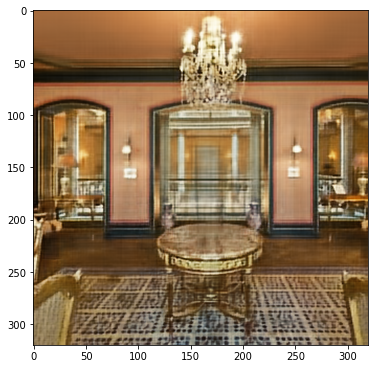

Iteracion 01751    Perdida 0.002193 

Iteracion 01752    Perdida 0.002234 

Iteracion 01753    Perdida 0.002164 

Iteracion 01754    Perdida 0.002060 

Iteracion 01755    Perdida 0.002076 

Iteracion 01756    Perdida 0.002177 

Iteracion 01757    Perdida 0.002090 

Iteracion 01758    Perdida 0.002065 

Iteracion 01759    Perdida 0.001987 

Iteracion 01760    Perdida 0.002066 

Iteracion 01761    Perdida 0.001976 

Iteracion 01762    Perdida 0.002062 

Iteracion 01763    Perdida 0.002036 

Iteracion 01764    Perdida 0.001992 

Iteracion 01765    Perdida 0.001963 

Iteracion 01766    Perdida 0.002012 

Iteracion 01767    Perdida 0.001966 

Iteracion 01768    Perdida 0.001922 

Iteracion 01769    Perdida 0.001935 

Iteracion 01770    Perdida 0.001908 

Iteracion 01771    Perdida 0.001908 

Iteracion 01772    Perdida 0.001916 

Iteracion 01773    Perdida 0.001865 

Iteracion 01774    Perdida 0.001874 

Iteracion 01775    Perdida 0.001836 

Iteracion 01776    Perdida 0.001806 

Iteracion 01

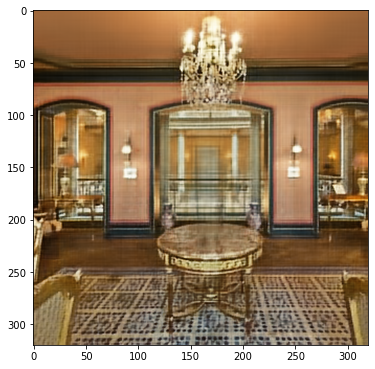

Iteracion 01801    Perdida 0.001705 

Iteracion 01802    Perdida 0.001684 

Iteracion 01803    Perdida 0.001686 

Iteracion 01804    Perdida 0.001690 

Iteracion 01805    Perdida 0.001720 

Iteracion 01806    Perdida 0.001782 

Iteracion 01807    Perdida 0.001829 

Iteracion 01808    Perdida 0.001766 

Iteracion 01809    Perdida 0.001742 

Iteracion 01810    Perdida 0.001692 

Iteracion 01811    Perdida 0.001685 

Iteracion 01812    Perdida 0.001739 

Iteracion 01813    Perdida 0.001790 

Iteracion 01814    Perdida 0.001838 

Iteracion 01815    Perdida 0.001852 

Iteracion 01816    Perdida 0.002001 

Iteracion 01817    Perdida 0.002040 

Iteracion 01818    Perdida 0.001989 

Iteracion 01819    Perdida 0.001951 

Iteracion 01820    Perdida 0.001902 

Iteracion 01821    Perdida 0.001776 

Iteracion 01822    Perdida 0.001811 

Iteracion 01823    Perdida 0.001794 

Iteracion 01824    Perdida 0.001761 

Iteracion 01825    Perdida 0.001659 

Iteracion 01826    Perdida 0.001710 

Iteracion 01

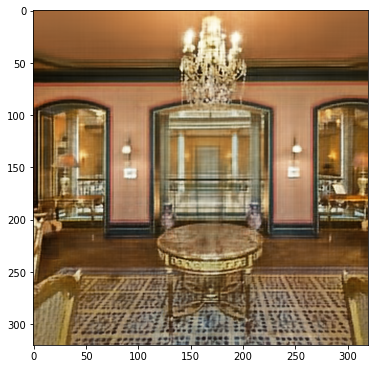

Iteracion 01851    Perdida 0.001684 

Iteracion 01852    Perdida 0.001661 

Iteracion 01853    Perdida 0.001611 

Iteracion 01854    Perdida 0.001647 

Iteracion 01855    Perdida 0.001672 

Iteracion 01856    Perdida 0.001621 

Iteracion 01857    Perdida 0.001564 

Iteracion 01858    Perdida 0.001547 

Iteracion 01859    Perdida 0.001542 

Iteracion 01860    Perdida 0.001519 

Iteracion 01861    Perdida 0.001489 

Iteracion 01862    Perdida 0.001491 

Iteracion 01863    Perdida 0.001502 

Iteracion 01864    Perdida 0.001492 

Iteracion 01865    Perdida 0.001532 

Iteracion 01866    Perdida 0.001603 

Iteracion 01867    Perdida 0.001587 

Iteracion 01868    Perdida 0.001611 

Iteracion 01869    Perdida 0.001585 

Iteracion 01870    Perdida 0.001511 

Iteracion 01871    Perdida 0.001488 

Iteracion 01872    Perdida 0.001479 

Iteracion 01873    Perdida 0.001451 

Iteracion 01874    Perdida 0.001424 

Iteracion 01875    Perdida 0.001452 

Iteracion 01876    Perdida 0.001476 

Iteracion 01

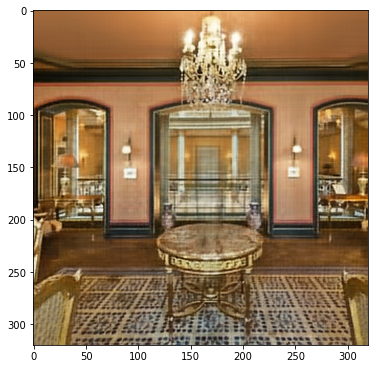

Iteracion 01901    Perdida 0.001414 

Iteracion 01902    Perdida 0.001428 

Iteracion 01903    Perdida 0.001450 

Iteracion 01904    Perdida 0.001447 

Iteracion 01905    Perdida 0.001477 

Iteracion 01906    Perdida 0.001444 

Iteracion 01907    Perdida 0.001423 

Iteracion 01908    Perdida 0.001438 

Iteracion 01909    Perdida 0.001416 

Iteracion 01910    Perdida 0.001412 

Iteracion 01911    Perdida 0.001357 

Iteracion 01912    Perdida 0.001359 

Iteracion 01913    Perdida 0.001379 

Iteracion 01914    Perdida 0.001406 

Iteracion 01915    Perdida 0.001410 

Iteracion 01916    Perdida 0.001432 

Iteracion 01917    Perdida 0.001454 

Iteracion 01918    Perdida 0.001499 

Iteracion 01919    Perdida 0.001510 

Iteracion 01920    Perdida 0.001453 

Iteracion 01921    Perdida 0.001465 

Iteracion 01922    Perdida 0.001506 

Iteracion 01923    Perdida 0.001414 

Iteracion 01924    Perdida 0.001419 

Iteracion 01925    Perdida 0.001406 

Iteracion 01926    Perdida 0.001360 

Iteracion 01

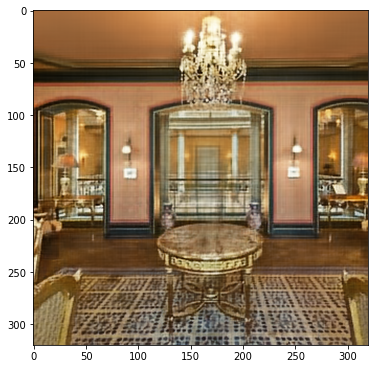

Iteracion 01951    Perdida 0.001351 

Iteracion 01952    Perdida 0.001410 

Iteracion 01953    Perdida 0.001463 

Iteracion 01954    Perdida 0.001443 

Iteracion 01955    Perdida 0.001349 

Iteracion 01956    Perdida 0.001464 

Iteracion 01957    Perdida 0.001396 

Iteracion 01958    Perdida 0.001323 

Iteracion 01959    Perdida 0.001435 

Iteracion 01960    Perdida 0.001319 

Iteracion 01961    Perdida 0.001317 

Iteracion 01962    Perdida 0.001330 

Iteracion 01963    Perdida 0.001279 

Iteracion 01964    Perdida 0.001274 

Iteracion 01965    Perdida 0.001246 

Iteracion 01966    Perdida 0.001231 

Iteracion 01967    Perdida 0.001254 

Iteracion 01968    Perdida 0.001202 

Iteracion 01969    Perdida 0.001187 

Iteracion 01970    Perdida 0.001176 

Iteracion 01971    Perdida 0.001179 

Iteracion 01972    Perdida 0.001185 

Iteracion 01973    Perdida 0.001167 

Iteracion 01974    Perdida 0.001208 

Iteracion 01975    Perdida 0.001234 

Iteracion 01976    Perdida 0.001262 

Iteracion 01

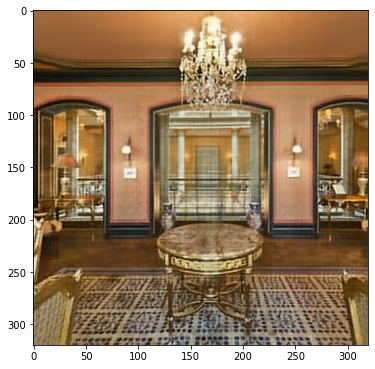

Iteracion 02001    Perdida 0.001278 

Iteracion 02002    Perdida 0.001250 

Iteracion 02003    Perdida 0.001224 

Iteracion 02004    Perdida 0.001207 

Iteracion 02005    Perdida 0.001202 

Iteracion 02006    Perdida 0.001177 

Iteracion 02007    Perdida 0.001157 

Iteracion 02008    Perdida 0.001133 

Iteracion 02009    Perdida 0.001131 

Iteracion 02010    Perdida 0.001125 

Iteracion 02011    Perdida 0.001112 

Iteracion 02012    Perdida 0.001098 

Iteracion 02013    Perdida 0.001099 

Iteracion 02014    Perdida 0.001116 

Iteracion 02015    Perdida 0.001128 

Iteracion 02016    Perdida 0.001143 

Iteracion 02017    Perdida 0.001167 

Iteracion 02018    Perdida 0.001187 

Iteracion 02019    Perdida 0.001220 

Iteracion 02020    Perdida 0.001250 

Iteracion 02021    Perdida 0.001261 

Iteracion 02022    Perdida 0.001187 

Iteracion 02023    Perdida 0.001163 

Iteracion 02024    Perdida 0.001193 

Iteracion 02025    Perdida 0.001183 

Iteracion 02026    Perdida 0.001155 

Iteracion 02

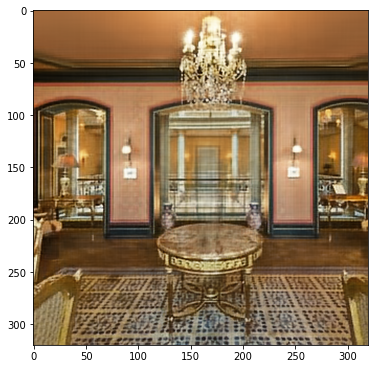

Iteracion 02051    Perdida 0.001066 

Iteracion 02052    Perdida 0.001080 

Iteracion 02053    Perdida 0.001101 

Iteracion 02054    Perdida 0.001126 

Iteracion 02055    Perdida 0.001163 

Iteracion 02056    Perdida 0.001189 

Iteracion 02057    Perdida 0.001159 

Iteracion 02058    Perdida 0.001249 

Iteracion 02059    Perdida 0.001283 

Iteracion 02060    Perdida 0.001217 

Iteracion 02061    Perdida 0.001202 

Iteracion 02062    Perdida 0.001250 

Iteracion 02063    Perdida 0.001307 

Iteracion 02064    Perdida 0.001230 

Iteracion 02065    Perdida 0.001159 

Iteracion 02066    Perdida 0.001164 

Iteracion 02067    Perdida 0.001149 

Iteracion 02068    Perdida 0.001060 

Iteracion 02069    Perdida 0.001093 

Iteracion 02070    Perdida 0.001104 

Iteracion 02071    Perdida 0.001036 

Iteracion 02072    Perdida 0.001058 

Iteracion 02073    Perdida 0.001047 

Iteracion 02074    Perdida 0.001023 

Iteracion 02075    Perdida 0.001028 

Iteracion 02076    Perdida 0.001025 

Iteracion 02

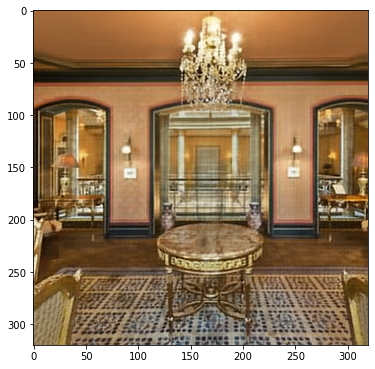

Iteracion 02101    Perdida 0.001053 

Iteracion 02102    Perdida 0.001080 

Iteracion 02103    Perdida 0.001014 

Iteracion 02104    Perdida 0.001036 

Iteracion 02105    Perdida 0.001001 

Iteracion 02106    Perdida 0.000989 

Iteracion 02107    Perdida 0.000983 

Iteracion 02108    Perdida 0.000974 

Iteracion 02109    Perdida 0.000961 

Iteracion 02110    Perdida 0.000957 

Iteracion 02111    Perdida 0.000951 

Iteracion 02112    Perdida 0.000936 

Iteracion 02113    Perdida 0.000947 

Iteracion 02114    Perdida 0.000938 

Iteracion 02115    Perdida 0.000929 

Iteracion 02116    Perdida 0.000920 

Iteracion 02117    Perdida 0.000909 

Iteracion 02118    Perdida 0.000927 

Iteracion 02119    Perdida 0.000909 

Iteracion 02120    Perdida 0.000916 

Iteracion 02121    Perdida 0.000919 

Iteracion 02122    Perdida 0.000955 

Iteracion 02123    Perdida 0.000972 

Iteracion 02124    Perdida 0.001022 

Iteracion 02125    Perdida 0.001036 

Iteracion 02126    Perdida 0.001039 

Iteracion 02

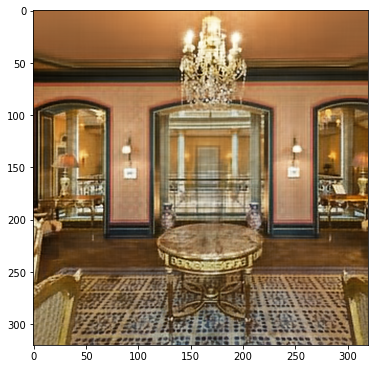

Iteracion 02151    Perdida 0.000923 

Iteracion 02152    Perdida 0.000941 

Iteracion 02153    Perdida 0.000956 

Iteracion 02154    Perdida 0.000951 

Iteracion 02155    Perdida 0.000950 

Iteracion 02156    Perdida 0.000951 

Iteracion 02157    Perdida 0.000917 

Iteracion 02158    Perdida 0.000950 

Iteracion 02159    Perdida 0.001013 

Iteracion 02160    Perdida 0.001060 

Iteracion 02161    Perdida 0.001098 

Iteracion 02162    Perdida 0.001039 

Iteracion 02163    Perdida 0.001012 

Iteracion 02164    Perdida 0.001049 

Iteracion 02165    Perdida 0.001020 

Iteracion 02166    Perdida 0.000991 

Iteracion 02167    Perdida 0.000978 

Iteracion 02168    Perdida 0.000976 

Iteracion 02169    Perdida 0.000967 

Iteracion 02170    Perdida 0.000963 

Iteracion 02171    Perdida 0.000934 

Iteracion 02172    Perdida 0.000916 

Iteracion 02173    Perdida 0.000929 

Iteracion 02174    Perdida 0.000957 

Iteracion 02175    Perdida 0.000983 

Iteracion 02176    Perdida 0.001014 

Iteracion 02

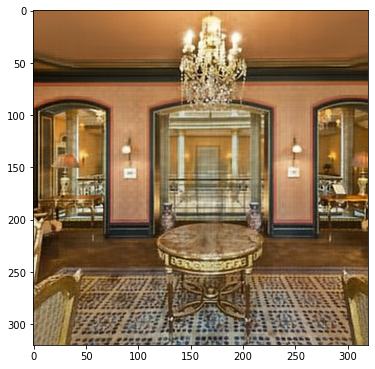

Iteracion 02201    Perdida 0.000930 

Iteracion 02202    Perdida 0.000875 

Iteracion 02203    Perdida 0.000887 

Iteracion 02204    Perdida 0.000893 

Iteracion 02205    Perdida 0.000892 

Iteracion 02206    Perdida 0.000874 

Iteracion 02207    Perdida 0.000894 

Iteracion 02208    Perdida 0.000916 

Iteracion 02209    Perdida 0.000881 

Iteracion 02210    Perdida 0.000912 

Iteracion 02211    Perdida 0.000929 

Iteracion 02212    Perdida 0.000915 

Iteracion 02213    Perdida 0.000880 

Iteracion 02214    Perdida 0.000869 

Iteracion 02215    Perdida 0.000879 

Iteracion 02216    Perdida 0.000863 

Iteracion 02217    Perdida 0.000878 

Iteracion 02218    Perdida 0.000896 

Iteracion 02219    Perdida 0.000896 

Iteracion 02220    Perdida 0.000921 

Iteracion 02221    Perdida 0.000911 

Iteracion 02222    Perdida 0.000900 

Iteracion 02223    Perdida 0.000925 

Iteracion 02224    Perdida 0.000959 

Iteracion 02225    Perdida 0.000963 

Iteracion 02226    Perdida 0.000972 

Iteracion 02

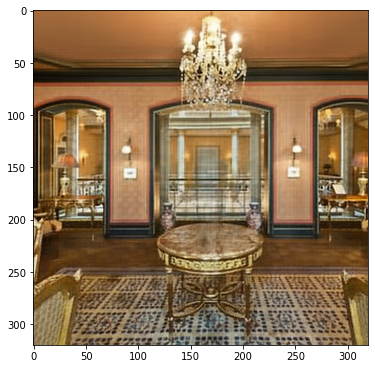

Iteracion 02251    Perdida 0.000853 

Iteracion 02252    Perdida 0.000853 

Iteracion 02253    Perdida 0.000879 

Iteracion 02254    Perdida 0.000873 

Iteracion 02255    Perdida 0.000831 

Iteracion 02256    Perdida 0.000905 

Iteracion 02257    Perdida 0.000916 

Iteracion 02258    Perdida 0.000862 

Iteracion 02259    Perdida 0.000882 

Iteracion 02260    Perdida 0.000881 

Iteracion 02261    Perdida 0.000844 

Iteracion 02262    Perdida 0.000829 

Iteracion 02263    Perdida 0.000829 

Iteracion 02264    Perdida 0.000830 

Iteracion 02265    Perdida 0.000843 

Iteracion 02266    Perdida 0.000827 

Iteracion 02267    Perdida 0.000829 

Iteracion 02268    Perdida 0.000847 

Iteracion 02269    Perdida 0.000817 

Iteracion 02270    Perdida 0.000804 

Iteracion 02271    Perdida 0.000788 

Iteracion 02272    Perdida 0.000777 

Iteracion 02273    Perdida 0.000764 

Iteracion 02274    Perdida 0.000769 

Iteracion 02275    Perdida 0.000764 

Iteracion 02276    Perdida 0.000776 

Iteracion 02

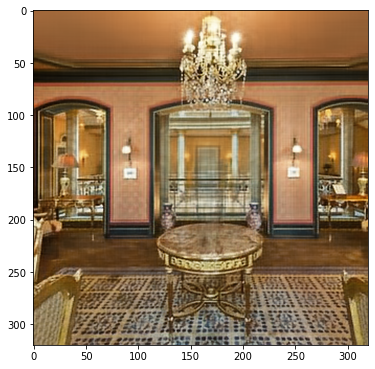

Iteracion 02301    Perdida 0.000763 

Iteracion 02302    Perdida 0.000765 

Iteracion 02303    Perdida 0.000779 

Iteracion 02304    Perdida 0.000814 

Iteracion 02305    Perdida 0.000894 

Iteracion 02306    Perdida 0.000916 

Iteracion 02307    Perdida 0.000926 

Iteracion 02308    Perdida 0.000888 

Iteracion 02309    Perdida 0.000824 

Iteracion 02310    Perdida 0.000808 

Iteracion 02311    Perdida 0.000796 

Iteracion 02312    Perdida 0.000789 

Iteracion 02313    Perdida 0.000782 

Iteracion 02314    Perdida 0.000787 

Iteracion 02315    Perdida 0.000778 

Iteracion 02316    Perdida 0.000769 

Iteracion 02317    Perdida 0.000783 

Iteracion 02318    Perdida 0.000800 

Iteracion 02319    Perdida 0.000809 

Iteracion 02320    Perdida 0.000796 

Iteracion 02321    Perdida 0.000817 

Iteracion 02322    Perdida 0.000802 

Iteracion 02323    Perdida 0.000780 

Iteracion 02324    Perdida 0.000789 

Iteracion 02325    Perdida 0.000786 

Iteracion 02326    Perdida 0.000773 

Iteracion 02

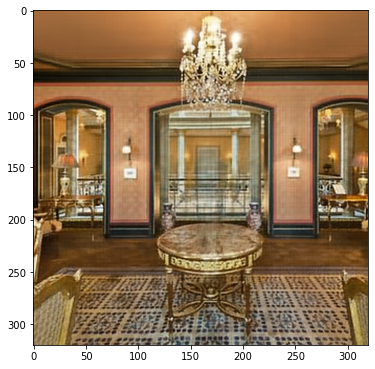

Iteracion 02351    Perdida 0.000954 

Iteracion 02352    Perdida 0.000938 

Iteracion 02353    Perdida 0.000860 

Iteracion 02354    Perdida 0.000798 

Iteracion 02355    Perdida 0.000828 

Iteracion 02356    Perdida 0.000802 

Iteracion 02357    Perdida 0.000796 

Iteracion 02358    Perdida 0.000777 

Iteracion 02359    Perdida 0.000755 

Iteracion 02360    Perdida 0.000765 

Iteracion 02361    Perdida 0.000753 

Iteracion 02362    Perdida 0.000774 

Iteracion 02363    Perdida 0.000786 

Iteracion 02364    Perdida 0.000775 

Iteracion 02365    Perdida 0.000801 

Iteracion 02366    Perdida 0.000801 

Iteracion 02367    Perdida 0.000802 

Iteracion 02368    Perdida 0.000783 

Iteracion 02369    Perdida 0.000806 

Iteracion 02370    Perdida 0.000795 

Iteracion 02371    Perdida 0.000785 

Iteracion 02372    Perdida 0.000760 

Iteracion 02373    Perdida 0.000726 

Iteracion 02374    Perdida 0.000708 

Iteracion 02375    Perdida 0.000687 

Iteracion 02376    Perdida 0.000707 

Iteracion 02

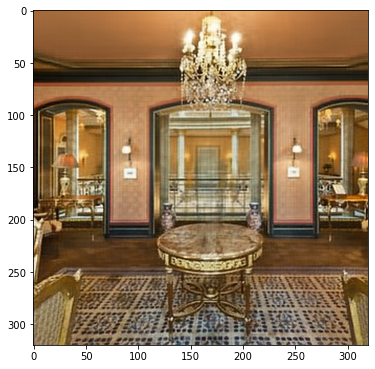

Iteracion 02401    Perdida 0.000774 

Iteracion 02402    Perdida 0.000792 

Iteracion 02403    Perdida 0.000756 

Iteracion 02404    Perdida 0.000729 

Iteracion 02405    Perdida 0.000760 

Iteracion 02406    Perdida 0.000753 

Iteracion 02407    Perdida 0.000723 

Iteracion 02408    Perdida 0.000694 

Iteracion 02409    Perdida 0.000697 

Iteracion 02410    Perdida 0.000677 

Iteracion 02411    Perdida 0.000661 

Iteracion 02412    Perdida 0.000655 

Iteracion 02413    Perdida 0.000655 

Iteracion 02414    Perdida 0.000640 

Iteracion 02415    Perdida 0.000651 

Iteracion 02416    Perdida 0.000660 

Iteracion 02417    Perdida 0.000664 

Iteracion 02418    Perdida 0.000707 

Iteracion 02419    Perdida 0.000750 

Iteracion 02420    Perdida 0.000777 

Iteracion 02421    Perdida 0.000787 

Iteracion 02422    Perdida 0.000754 

Iteracion 02423    Perdida 0.000712 

Iteracion 02424    Perdida 0.000698 

Iteracion 02425    Perdida 0.000736 

Iteracion 02426    Perdida 0.000754 

Iteracion 02

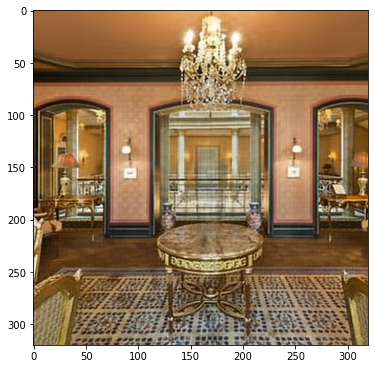

Iteracion 02451    Perdida 0.000683 

Iteracion 02452    Perdida 0.000681 

Iteracion 02453    Perdida 0.000717 

Iteracion 02454    Perdida 0.000740 

Iteracion 02455    Perdida 0.000704 

Iteracion 02456    Perdida 0.000715 

Iteracion 02457    Perdida 0.000667 

Iteracion 02458    Perdida 0.000669 

Iteracion 02459    Perdida 0.000679 

Iteracion 02460    Perdida 0.000669 

Iteracion 02461    Perdida 0.000651 

Iteracion 02462    Perdida 0.000639 

Iteracion 02463    Perdida 0.000641 

Iteracion 02464    Perdida 0.000644 

Iteracion 02465    Perdida 0.000652 

Iteracion 02466    Perdida 0.000657 

Iteracion 02467    Perdida 0.000633 

Iteracion 02468    Perdida 0.000630 

Iteracion 02469    Perdida 0.000656 

Iteracion 02470    Perdida 0.000630 

Iteracion 02471    Perdida 0.000632 

Iteracion 02472    Perdida 0.000669 

Iteracion 02473    Perdida 0.000668 

Iteracion 02474    Perdida 0.000679 

Iteracion 02475    Perdida 0.000720 

Iteracion 02476    Perdida 0.000738 

Iteracion 02

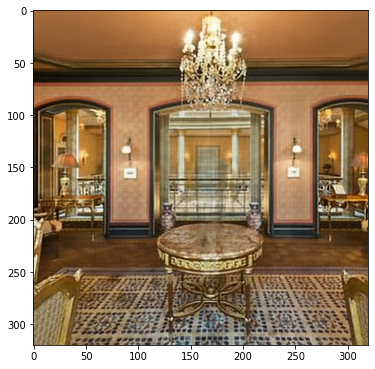

Iteracion 02501    Perdida 0.000589 

Iteracion 02502    Perdida 0.000591 

Iteracion 02503    Perdida 0.000596 

Iteracion 02504    Perdida 0.000603 

Iteracion 02505    Perdida 0.000607 

Iteracion 02506    Perdida 0.000607 

Iteracion 02507    Perdida 0.000598 

Iteracion 02508    Perdida 0.000602 

Iteracion 02509    Perdida 0.000603 

Iteracion 02510    Perdida 0.000601 

Iteracion 02511    Perdida 0.000620 

Iteracion 02512    Perdida 0.000637 

Iteracion 02513    Perdida 0.000637 

Iteracion 02514    Perdida 0.000634 

Iteracion 02515    Perdida 0.000641 

Iteracion 02516    Perdida 0.000643 

Iteracion 02517    Perdida 0.000665 

Iteracion 02518    Perdida 0.000691 

Iteracion 02519    Perdida 0.000704 

Iteracion 02520    Perdida 0.000682 

Iteracion 02521    Perdida 0.000728 

Iteracion 02522    Perdida 0.000845 

Iteracion 02523    Perdida 0.000918 

Iteracion 02524    Perdida 0.000867 

Iteracion 02525    Perdida 0.000870 

Iteracion 02526    Perdida 0.000977 

Iteracion 02

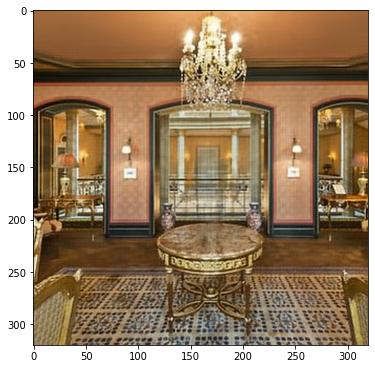

Iteracion 02551    Perdida 0.000537 

Iteracion 02552    Perdida 0.000537 

Iteracion 02553    Perdida 0.000521 

Iteracion 02554    Perdida 0.000534 

Iteracion 02555    Perdida 0.000522 

Iteracion 02556    Perdida 0.000522 

Iteracion 02557    Perdida 0.000515 

Iteracion 02558    Perdida 0.000515 

Iteracion 02559    Perdida 0.000517 

Iteracion 02560    Perdida 0.000532 

Iteracion 02561    Perdida 0.000540 

Iteracion 02562    Perdida 0.000559 

Iteracion 02563    Perdida 0.000589 

Iteracion 02564    Perdida 0.000626 

Iteracion 02565    Perdida 0.000689 

Iteracion 02566    Perdida 0.000786 

Iteracion 02567    Perdida 0.000809 

Iteracion 02568    Perdida 0.000769 

Iteracion 02569    Perdida 0.000688 

Iteracion 02570    Perdida 0.000779 

Iteracion 02571    Perdida 0.000754 

Iteracion 02572    Perdida 0.000651 

Iteracion 02573    Perdida 0.000743 

Iteracion 02574    Perdida 0.000779 

Iteracion 02575    Perdida 0.000653 

Iteracion 02576    Perdida 0.000714 

Iteracion 02

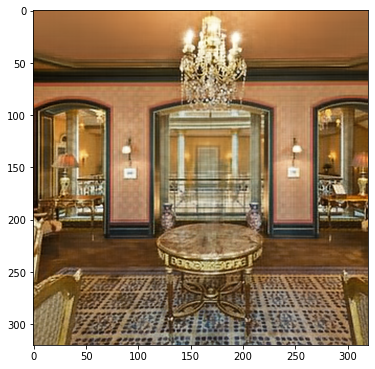

Iteracion 02601    Perdida 0.000668 

Iteracion 02602    Perdida 0.000647 

Iteracion 02603    Perdida 0.000629 

Iteracion 02604    Perdida 0.000614 

Iteracion 02605    Perdida 0.000580 

Iteracion 02606    Perdida 0.000565 

Iteracion 02607    Perdida 0.000551 

Iteracion 02608    Perdida 0.000542 

Iteracion 02609    Perdida 0.000540 

Iteracion 02610    Perdida 0.000525 

Iteracion 02611    Perdida 0.000535 

Iteracion 02612    Perdida 0.000534 

Iteracion 02613    Perdida 0.000527 

Iteracion 02614    Perdida 0.000528 

Iteracion 02615    Perdida 0.000556 

Iteracion 02616    Perdida 0.000553 

Iteracion 02617    Perdida 0.000550 

Iteracion 02618    Perdida 0.000549 

Iteracion 02619    Perdida 0.000555 

Iteracion 02620    Perdida 0.000551 

Iteracion 02621    Perdida 0.000574 

Iteracion 02622    Perdida 0.000603 

Iteracion 02623    Perdida 0.000625 

Iteracion 02624    Perdida 0.000682 

Iteracion 02625    Perdida 0.000707 

Iteracion 02626    Perdida 0.000673 

Iteracion 02

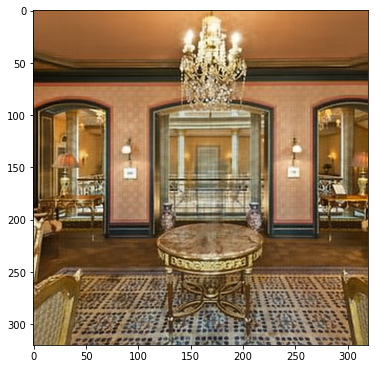

Iteracion 02651    Perdida 0.000568 

Iteracion 02652    Perdida 0.000571 

Iteracion 02653    Perdida 0.000568 

Iteracion 02654    Perdida 0.000546 

Iteracion 02655    Perdida 0.000550 

Iteracion 02656    Perdida 0.000546 

Iteracion 02657    Perdida 0.000534 

Iteracion 02658    Perdida 0.000539 

Iteracion 02659    Perdida 0.000521 

Iteracion 02660    Perdida 0.000519 

Iteracion 02661    Perdida 0.000516 

Iteracion 02662    Perdida 0.000506 

Iteracion 02663    Perdida 0.000507 

Iteracion 02664    Perdida 0.000489 

Iteracion 02665    Perdida 0.000483 

Iteracion 02666    Perdida 0.000488 

Iteracion 02667    Perdida 0.000489 

Iteracion 02668    Perdida 0.000491 

Iteracion 02669    Perdida 0.000492 

Iteracion 02670    Perdida 0.000508 

Iteracion 02671    Perdida 0.000537 

Iteracion 02672    Perdida 0.000600 

Iteracion 02673    Perdida 0.000658 

Iteracion 02674    Perdida 0.000681 

Iteracion 02675    Perdida 0.000604 

Iteracion 02676    Perdida 0.000539 

Iteracion 02

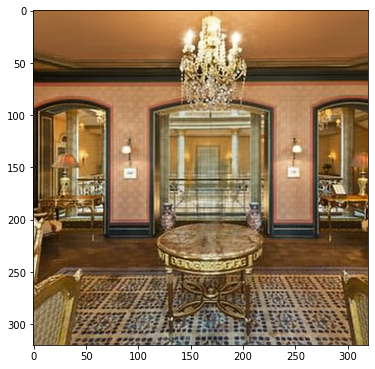

Iteracion 02701    Perdida 0.000604 

Iteracion 02702    Perdida 0.000657 

Iteracion 02703    Perdida 0.000651 

Iteracion 02704    Perdida 0.000627 

Iteracion 02705    Perdida 0.000570 

Iteracion 02706    Perdida 0.000556 

Iteracion 02707    Perdida 0.000552 

Iteracion 02708    Perdida 0.000514 

Iteracion 02709    Perdida 0.000530 

Iteracion 02710    Perdida 0.000526 

Iteracion 02711    Perdida 0.000511 

Iteracion 02712    Perdida 0.000515 

Iteracion 02713    Perdida 0.000527 

Iteracion 02714    Perdida 0.000517 

Iteracion 02715    Perdida 0.000522 

Iteracion 02716    Perdida 0.000525 

Iteracion 02717    Perdida 0.000519 

Iteracion 02718    Perdida 0.000512 

Iteracion 02719    Perdida 0.000528 

Iteracion 02720    Perdida 0.000514 

Iteracion 02721    Perdida 0.000506 

Iteracion 02722    Perdida 0.000516 

Iteracion 02723    Perdida 0.000519 

Iteracion 02724    Perdida 0.000527 

Iteracion 02725    Perdida 0.000555 

Iteracion 02726    Perdida 0.000578 

Iteracion 02

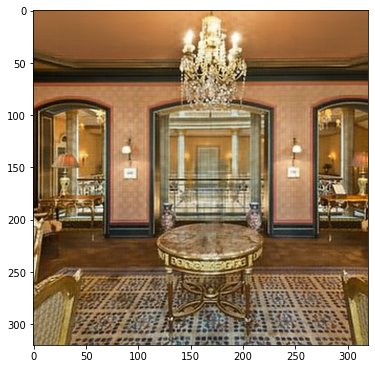

Iteracion 02751    Perdida 0.000504 

Iteracion 02752    Perdida 0.000500 

Iteracion 02753    Perdida 0.000507 

Iteracion 02754    Perdida 0.000483 

Iteracion 02755    Perdida 0.000496 

Iteracion 02756    Perdida 0.000505 

Iteracion 02757    Perdida 0.000527 

Iteracion 02758    Perdida 0.000548 

Iteracion 02759    Perdida 0.000572 

Iteracion 02760    Perdida 0.000557 

Iteracion 02761    Perdida 0.000554 

Iteracion 02762    Perdida 0.000541 

Iteracion 02763    Perdida 0.000517 

Iteracion 02764    Perdida 0.000492 

Iteracion 02765    Perdida 0.000511 

Iteracion 02766    Perdida 0.000550 

Iteracion 02767    Perdida 0.000543 

Iteracion 02768    Perdida 0.000547 

Iteracion 02769    Perdida 0.000525 

Iteracion 02770    Perdida 0.000511 

Iteracion 02771    Perdida 0.000543 

Iteracion 02772    Perdida 0.000567 

Iteracion 02773    Perdida 0.000567 

Iteracion 02774    Perdida 0.000562 

Iteracion 02775    Perdida 0.000560 

Iteracion 02776    Perdida 0.000559 

Iteracion 02

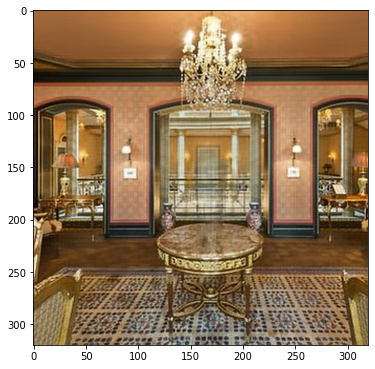

Iteracion 02801    Perdida 0.000444 

Iteracion 02802    Perdida 0.000457 

Iteracion 02803    Perdida 0.000451 

Iteracion 02804    Perdida 0.000444 

Iteracion 02805    Perdida 0.000438 

Iteracion 02806    Perdida 0.000443 

Iteracion 02807    Perdida 0.000464 

Iteracion 02808    Perdida 0.000499 

Iteracion 02809    Perdida 0.000552 

Iteracion 02810    Perdida 0.000578 

Iteracion 02811    Perdida 0.000590 

Iteracion 02812    Perdida 0.000587 

Iteracion 02813    Perdida 0.000601 

Iteracion 02814    Perdida 0.000618 

Iteracion 02815    Perdida 0.000596 

Iteracion 02816    Perdida 0.000568 

Iteracion 02817    Perdida 0.000578 

Iteracion 02818    Perdida 0.000540 

Iteracion 02819    Perdida 0.000523 

Iteracion 02820    Perdida 0.000530 

Iteracion 02821    Perdida 0.000519 

Iteracion 02822    Perdida 0.000537 

Iteracion 02823    Perdida 0.000556 

Iteracion 02824    Perdida 0.000551 

Iteracion 02825    Perdida 0.000522 

Iteracion 02826    Perdida 0.000506 

Iteracion 02

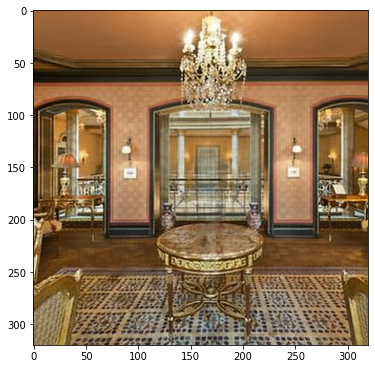

Iteracion 02851    Perdida 0.000643 

Iteracion 02852    Perdida 0.000601 

Iteracion 02853    Perdida 0.000603 

Iteracion 02854    Perdida 0.000567 

Iteracion 02855    Perdida 0.000540 

Iteracion 02856    Perdida 0.000540 

Iteracion 02857    Perdida 0.000519 

Iteracion 02858    Perdida 0.000513 

Iteracion 02859    Perdida 0.000511 

Iteracion 02860    Perdida 0.000498 

Iteracion 02861    Perdida 0.000481 

Iteracion 02862    Perdida 0.000480 

Iteracion 02863    Perdida 0.000465 

Iteracion 02864    Perdida 0.000453 

Iteracion 02865    Perdida 0.000449 

Iteracion 02866    Perdida 0.000438 

Iteracion 02867    Perdida 0.000421 

Iteracion 02868    Perdida 0.000427 

Iteracion 02869    Perdida 0.000426 

Iteracion 02870    Perdida 0.000416 

Iteracion 02871    Perdida 0.000421 

Iteracion 02872    Perdida 0.000413 

Iteracion 02873    Perdida 0.000406 

Iteracion 02874    Perdida 0.000405 

Iteracion 02875    Perdida 0.000411 

Iteracion 02876    Perdida 0.000423 

Iteracion 02

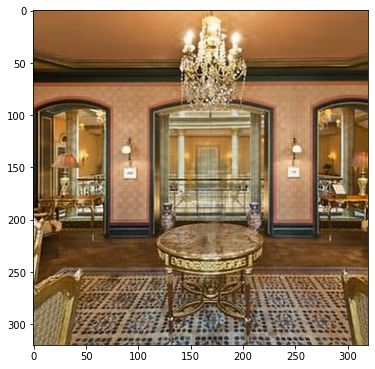

Iteracion 02901    Perdida 0.000517 

Iteracion 02902    Perdida 0.000452 

Iteracion 02903    Perdida 0.000480 

Iteracion 02904    Perdida 0.000485 

Iteracion 02905    Perdida 0.000444 

Iteracion 02906    Perdida 0.000457 

Iteracion 02907    Perdida 0.000445 

Iteracion 02908    Perdida 0.000427 

Iteracion 02909    Perdida 0.000437 

Iteracion 02910    Perdida 0.000423 

Iteracion 02911    Perdida 0.000428 

Iteracion 02912    Perdida 0.000431 

Iteracion 02913    Perdida 0.000415 

Iteracion 02914    Perdida 0.000426 

Iteracion 02915    Perdida 0.000450 

Iteracion 02916    Perdida 0.000449 

Iteracion 02917    Perdida 0.000472 

Iteracion 02918    Perdida 0.000482 

Iteracion 02919    Perdida 0.000495 

Iteracion 02920    Perdida 0.000491 

Iteracion 02921    Perdida 0.000494 

Iteracion 02922    Perdida 0.000461 

Iteracion 02923    Perdida 0.000447 

Iteracion 02924    Perdida 0.000467 

Iteracion 02925    Perdida 0.000466 

Iteracion 02926    Perdida 0.000454 

Iteracion 02

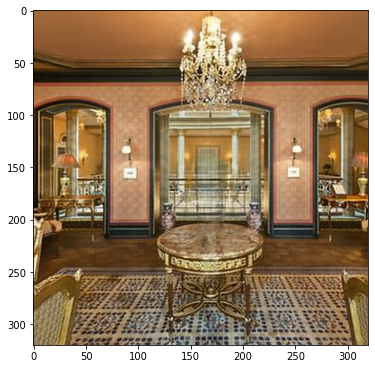

Iteracion 02951    Perdida 0.000399 

Iteracion 02952    Perdida 0.000413 

Iteracion 02953    Perdida 0.000434 

Iteracion 02954    Perdida 0.000481 

Iteracion 02955    Perdida 0.000526 

Iteracion 02956    Perdida 0.000578 

Iteracion 02957    Perdida 0.000612 

Iteracion 02958    Perdida 0.000634 

Iteracion 02959    Perdida 0.000612 

Iteracion 02960    Perdida 0.000560 

Iteracion 02961    Perdida 0.000528 

Iteracion 02962    Perdida 0.000538 

Iteracion 02963    Perdida 0.000541 

Iteracion 02964    Perdida 0.000495 

Iteracion 02965    Perdida 0.000493 

Iteracion 02966    Perdida 0.000537 

Iteracion 02967    Perdida 0.000532 

Iteracion 02968    Perdida 0.000619 

Iteracion 02969    Perdida 0.000654 

Iteracion 02970    Perdida 0.000678 

Iteracion 02971    Perdida 0.000684 

Iteracion 02972    Perdida 0.000705 

Iteracion 02973    Perdida 0.000644 

Iteracion 02974    Perdida 0.000620 

Iteracion 02975    Perdida 0.000578 

Iteracion 02976    Perdida 0.000495 

Iteracion 02

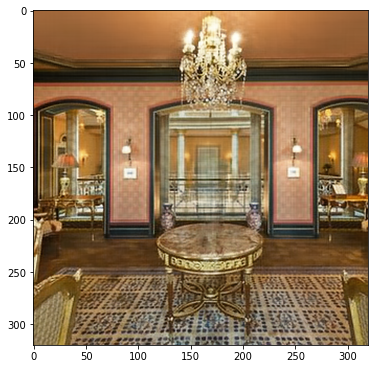

Iteracion 03001    Perdida 0.000377 

Iteracion 03002    Perdida 0.000373 

Iteracion 03003    Perdida 0.000387 

Iteracion 03004    Perdida 0.000411 

Iteracion 03005    Perdida 0.000444 

Iteracion 03006    Perdida 0.000476 

Iteracion 03007    Perdida 0.000498 

Iteracion 03008    Perdida 0.000471 

Iteracion 03009    Perdida 0.000446 

Iteracion 03010    Perdida 0.000445 

Iteracion 03011    Perdida 0.000453 

Iteracion 03012    Perdida 0.000447 

Iteracion 03013    Perdida 0.000426 

Iteracion 03014    Perdida 0.000421 

Iteracion 03015    Perdida 0.000413 

Iteracion 03016    Perdida 0.000410 

Iteracion 03017    Perdida 0.000400 

Iteracion 03018    Perdida 0.000392 

Iteracion 03019    Perdida 0.000396 

Iteracion 03020    Perdida 0.000404 

Iteracion 03021    Perdida 0.000397 

Iteracion 03022    Perdida 0.000405 

Iteracion 03023    Perdida 0.000445 

Iteracion 03024    Perdida 0.000500 

Iteracion 03025    Perdida 0.000569 

Iteracion 03026    Perdida 0.000663 

Iteracion 03

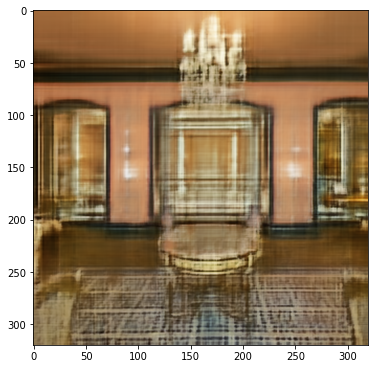

Iteracion 03051    Perdida 0.005618 

Iteracion 03052    Perdida 0.005363 

Iteracion 03053    Perdida 0.005132 

Iteracion 03054    Perdida 0.004941 

Iteracion 03055    Perdida 0.004718 

Iteracion 03056    Perdida 0.004531 

Iteracion 03057    Perdida 0.004372 

Iteracion 03058    Perdida 0.004228 

Iteracion 03059    Perdida 0.004066 

Iteracion 03060    Perdida 0.003943 

Iteracion 03061    Perdida 0.003792 

Iteracion 03062    Perdida 0.003669 

Iteracion 03063    Perdida 0.003542 

Iteracion 03064    Perdida 0.003444 

Iteracion 03065    Perdida 0.003330 

Iteracion 03066    Perdida 0.003233 

Iteracion 03067    Perdida 0.003155 

Iteracion 03068    Perdida 0.003076 

Iteracion 03069    Perdida 0.002958 

Iteracion 03070    Perdida 0.002869 

Iteracion 03071    Perdida 0.002783 

Iteracion 03072    Perdida 0.002723 

Iteracion 03073    Perdida 0.002672 

Iteracion 03074    Perdida 0.002586 

Iteracion 03075    Perdida 0.002499 

Iteracion 03076    Perdida 0.002460 

Iteracion 03

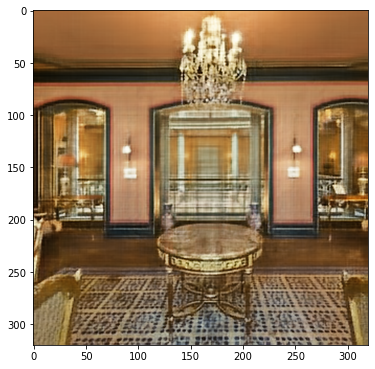

Iteracion 03101    Perdida 0.001668 

Iteracion 03102    Perdida 0.001635 

Iteracion 03103    Perdida 0.001581 

Iteracion 03104    Perdida 0.001580 

Iteracion 03105    Perdida 0.001596 

Iteracion 03106    Perdida 0.001603 

Iteracion 03107    Perdida 0.001573 

Iteracion 03108    Perdida 0.001523 

Iteracion 03109    Perdida 0.001435 

Iteracion 03110    Perdida 0.001434 

Iteracion 03111    Perdida 0.001446 

Iteracion 03112    Perdida 0.001388 

Iteracion 03113    Perdida 0.001362 

Iteracion 03114    Perdida 0.001344 

Iteracion 03115    Perdida 0.001318 

Iteracion 03116    Perdida 0.001290 

Iteracion 03117    Perdida 0.001294 

Iteracion 03118    Perdida 0.001317 

Iteracion 03119    Perdida 0.001300 

Iteracion 03120    Perdida 0.001259 

Iteracion 03121    Perdida 0.001253 

Iteracion 03122    Perdida 0.001250 

Iteracion 03123    Perdida 0.001208 

Iteracion 03124    Perdida 0.001181 

Iteracion 03125    Perdida 0.001168 

Iteracion 03126    Perdida 0.001172 

Iteracion 03

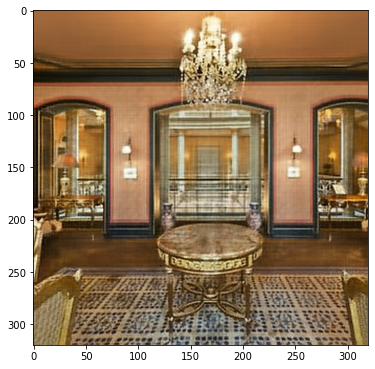

Iteracion 03151    Perdida 0.000991 

Iteracion 03152    Perdida 0.001000 

Iteracion 03153    Perdida 0.000973 

Iteracion 03154    Perdida 0.000974 

Iteracion 03155    Perdida 0.000975 

Iteracion 03156    Perdida 0.000968 

Iteracion 03157    Perdida 0.000960 

Iteracion 03158    Perdida 0.000932 

Iteracion 03159    Perdida 0.000948 

Iteracion 03160    Perdida 0.000970 

Iteracion 03161    Perdida 0.000929 

Iteracion 03162    Perdida 0.000913 

Iteracion 03163    Perdida 0.000934 

Iteracion 03164    Perdida 0.000928 

Iteracion 03165    Perdida 0.000898 

Iteracion 03166    Perdida 0.000885 

Iteracion 03167    Perdida 0.000885 

Iteracion 03168    Perdida 0.000869 

Iteracion 03169    Perdida 0.000889 

Iteracion 03170    Perdida 0.000926 

Iteracion 03171    Perdida 0.000918 

Iteracion 03172    Perdida 0.000910 

Iteracion 03173    Perdida 0.000935 

Iteracion 03174    Perdida 0.000925 

Iteracion 03175    Perdida 0.000882 

Iteracion 03176    Perdida 0.000873 

Iteracion 03

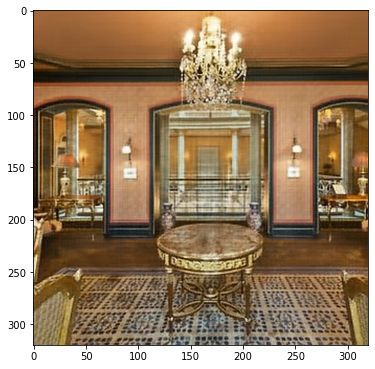

Iteracion 03201    Perdida 0.000800 

Iteracion 03202    Perdida 0.000817 

Iteracion 03203    Perdida 0.000812 

Iteracion 03204    Perdida 0.000771 

Iteracion 03205    Perdida 0.000782 

Iteracion 03206    Perdida 0.000777 

Iteracion 03207    Perdida 0.000754 

Iteracion 03208    Perdida 0.000763 

Iteracion 03209    Perdida 0.000753 

Iteracion 03210    Perdida 0.000740 

Iteracion 03211    Perdida 0.000744 

Iteracion 03212    Perdida 0.000748 

Iteracion 03213    Perdida 0.000733 

Iteracion 03214    Perdida 0.000717 

Iteracion 03215    Perdida 0.000723 

Iteracion 03216    Perdida 0.000709 

Iteracion 03217    Perdida 0.000693 

Iteracion 03218    Perdida 0.000687 

Iteracion 03219    Perdida 0.000691 

Iteracion 03220    Perdida 0.000684 

Iteracion 03221    Perdida 0.000676 

Iteracion 03222    Perdida 0.000675 

Iteracion 03223    Perdida 0.000677 

Iteracion 03224    Perdida 0.000682 

Iteracion 03225    Perdida 0.000699 

Iteracion 03226    Perdida 0.000712 

Iteracion 03

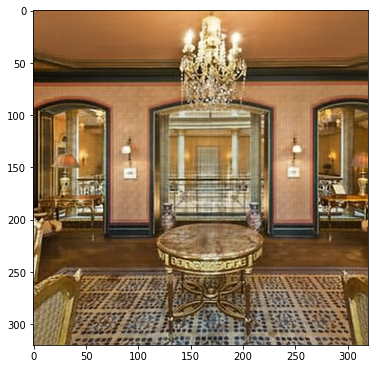

Iteracion 03251    Perdida 0.000649 

Iteracion 03252    Perdida 0.000638 

Iteracion 03253    Perdida 0.000626 

Iteracion 03254    Perdida 0.000627 

Iteracion 03255    Perdida 0.000630 

Iteracion 03256    Perdida 0.000644 

Iteracion 03257    Perdida 0.000640 

Iteracion 03258    Perdida 0.000642 

Iteracion 03259    Perdida 0.000647 

Iteracion 03260    Perdida 0.000645 

Iteracion 03261    Perdida 0.000635 

Iteracion 03262    Perdida 0.000644 

Iteracion 03263    Perdida 0.000625 

Iteracion 03264    Perdida 0.000608 

Iteracion 03265    Perdida 0.000615 

Iteracion 03266    Perdida 0.000600 

Iteracion 03267    Perdida 0.000594 

Iteracion 03268    Perdida 0.000598 

Iteracion 03269    Perdida 0.000615 

Iteracion 03270    Perdida 0.000621 

Iteracion 03271    Perdida 0.000637 

Iteracion 03272    Perdida 0.000649 

Iteracion 03273    Perdida 0.000680 

Iteracion 03274    Perdida 0.000715 

Iteracion 03275    Perdida 0.000771 

Iteracion 03276    Perdida 0.000745 

Iteracion 03

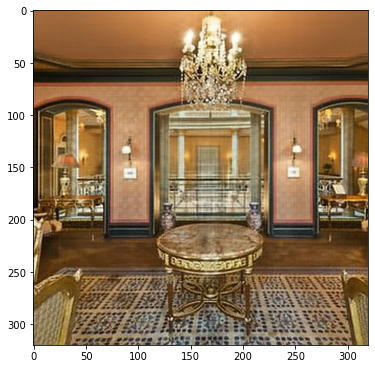

Iteracion 03301    Perdida 0.000553 

Iteracion 03302    Perdida 0.000546 

Iteracion 03303    Perdida 0.000556 

Iteracion 03304    Perdida 0.000556 

Iteracion 03305    Perdida 0.000560 

Iteracion 03306    Perdida 0.000562 

Iteracion 03307    Perdida 0.000564 

Iteracion 03308    Perdida 0.000574 

Iteracion 03309    Perdida 0.000584 

Iteracion 03310    Perdida 0.000588 

Iteracion 03311    Perdida 0.000599 

Iteracion 03312    Perdida 0.000596 

Iteracion 03313    Perdida 0.000586 

Iteracion 03314    Perdida 0.000574 

Iteracion 03315    Perdida 0.000568 

Iteracion 03316    Perdida 0.000565 

Iteracion 03317    Perdida 0.000555 

Iteracion 03318    Perdida 0.000563 

Iteracion 03319    Perdida 0.000570 

Iteracion 03320    Perdida 0.000551 

Iteracion 03321    Perdida 0.000555 

Iteracion 03322    Perdida 0.000557 

Iteracion 03323    Perdida 0.000559 

Iteracion 03324    Perdida 0.000551 

Iteracion 03325    Perdida 0.000550 

Iteracion 03326    Perdida 0.000565 

Iteracion 03

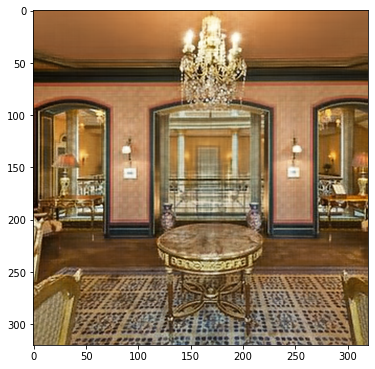

Iteracion 03351    Perdida 0.000611 

Iteracion 03352    Perdida 0.000644 

Iteracion 03353    Perdida 0.000630 

Iteracion 03354    Perdida 0.000614 

Iteracion 03355    Perdida 0.000574 

Iteracion 03356    Perdida 0.000579 

Iteracion 03357    Perdida 0.000575 

Iteracion 03358    Perdida 0.000567 

Iteracion 03359    Perdida 0.000550 

Iteracion 03360    Perdida 0.000531 

Iteracion 03361    Perdida 0.000540 

Iteracion 03362    Perdida 0.000547 

Iteracion 03363    Perdida 0.000538 

Iteracion 03364    Perdida 0.000515 

Iteracion 03365    Perdida 0.000513 

Iteracion 03366    Perdida 0.000497 

Iteracion 03367    Perdida 0.000493 

Iteracion 03368    Perdida 0.000484 

Iteracion 03369    Perdida 0.000483 

Iteracion 03370    Perdida 0.000491 

Iteracion 03371    Perdida 0.000482 

Iteracion 03372    Perdida 0.000470 

Iteracion 03373    Perdida 0.000477 

Iteracion 03374    Perdida 0.000473 

Iteracion 03375    Perdida 0.000481 

Iteracion 03376    Perdida 0.000514 

Iteracion 03

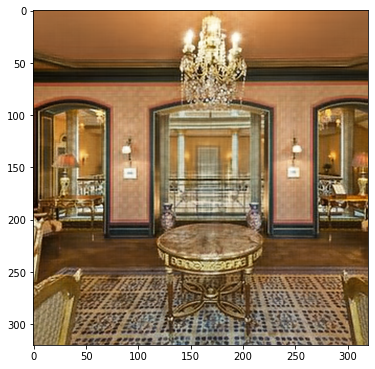

Iteracion 03401    Perdida 0.000453 

Iteracion 03402    Perdida 0.000450 

Iteracion 03403    Perdida 0.000455 

Iteracion 03404    Perdida 0.000443 

Iteracion 03405    Perdida 0.000445 

Iteracion 03406    Perdida 0.000443 

Iteracion 03407    Perdida 0.000448 

Iteracion 03408    Perdida 0.000454 

Iteracion 03409    Perdida 0.000464 

Iteracion 03410    Perdida 0.000503 

Iteracion 03411    Perdida 0.000575 

Iteracion 03412    Perdida 0.000672 

Iteracion 03413    Perdida 0.000771 

Iteracion 03414    Perdida 0.000790 

Iteracion 03415    Perdida 0.000643 

Iteracion 03416    Perdida 0.000493 

Iteracion 03417    Perdida 0.000539 

Iteracion 03418    Perdida 0.000610 

Iteracion 03419    Perdida 0.000586 

Iteracion 03420    Perdida 0.000511 

Iteracion 03421    Perdida 0.000488 

Iteracion 03422    Perdida 0.000534 

Iteracion 03423    Perdida 0.000510 

Iteracion 03424    Perdida 0.000451 

Iteracion 03425    Perdida 0.000465 

Iteracion 03426    Perdida 0.000478 

Iteracion 03

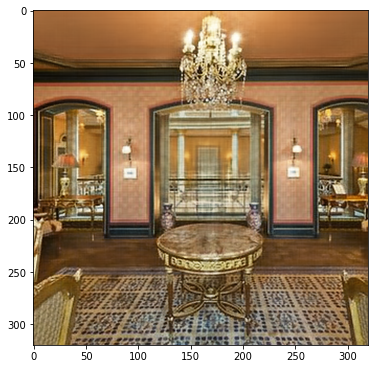

Iteracion 03451    Perdida 0.000499 

Iteracion 03452    Perdida 0.000486 

Iteracion 03453    Perdida 0.000503 

Iteracion 03454    Perdida 0.000517 

Iteracion 03455    Perdida 0.000502 

Iteracion 03456    Perdida 0.000452 

Iteracion 03457    Perdida 0.000460 

Iteracion 03458    Perdida 0.000472 

Iteracion 03459    Perdida 0.000442 

Iteracion 03460    Perdida 0.000418 

Iteracion 03461    Perdida 0.000444 

Iteracion 03462    Perdida 0.000448 

Iteracion 03463    Perdida 0.000421 

Iteracion 03464    Perdida 0.000420 

Iteracion 03465    Perdida 0.000424 

Iteracion 03466    Perdida 0.000410 

Iteracion 03467    Perdida 0.000411 

Iteracion 03468    Perdida 0.000419 

Iteracion 03469    Perdida 0.000418 

Iteracion 03470    Perdida 0.000416 

Iteracion 03471    Perdida 0.000415 

Iteracion 03472    Perdida 0.000422 

Iteracion 03473    Perdida 0.000431 

Iteracion 03474    Perdida 0.000446 

Iteracion 03475    Perdida 0.000445 

Iteracion 03476    Perdida 0.000445 

Iteracion 03

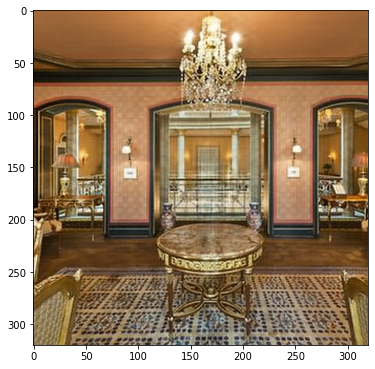

Iteracion 03501    Perdida 0.000399 

Iteracion 03502    Perdida 0.000399 

Iteracion 03503    Perdida 0.000396 

Iteracion 03504    Perdida 0.000403 

Iteracion 03505    Perdida 0.000405 

Iteracion 03506    Perdida 0.000412 

Iteracion 03507    Perdida 0.000430 

Iteracion 03508    Perdida 0.000426 

Iteracion 03509    Perdida 0.000416 

Iteracion 03510    Perdida 0.000407 

Iteracion 03511    Perdida 0.000405 

Iteracion 03512    Perdida 0.000401 

Iteracion 03513    Perdida 0.000387 

Iteracion 03514    Perdida 0.000387 

Iteracion 03515    Perdida 0.000391 

Iteracion 03516    Perdida 0.000398 

Iteracion 03517    Perdida 0.000394 

Iteracion 03518    Perdida 0.000392 

Iteracion 03519    Perdida 0.000388 

Iteracion 03520    Perdida 0.000393 

Iteracion 03521    Perdida 0.000387 

Iteracion 03522    Perdida 0.000382 

Iteracion 03523    Perdida 0.000390 

Iteracion 03524    Perdida 0.000411 

Iteracion 03525    Perdida 0.000421 

Iteracion 03526    Perdida 0.000422 

Iteracion 03

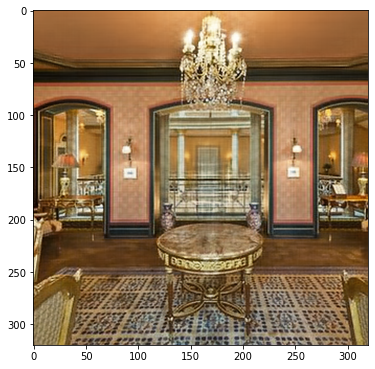

Iteracion 03551    Perdida 0.000400 

Iteracion 03552    Perdida 0.000405 

Iteracion 03553    Perdida 0.000402 

Iteracion 03554    Perdida 0.000378 

Iteracion 03555    Perdida 0.000378 

Iteracion 03556    Perdida 0.000371 

Iteracion 03557    Perdida 0.000373 

Iteracion 03558    Perdida 0.000380 

Iteracion 03559    Perdida 0.000398 

Iteracion 03560    Perdida 0.000411 

Iteracion 03561    Perdida 0.000412 

Iteracion 03562    Perdida 0.000433 

Iteracion 03563    Perdida 0.000427 

Iteracion 03564    Perdida 0.000403 

Iteracion 03565    Perdida 0.000390 

Iteracion 03566    Perdida 0.000381 

Iteracion 03567    Perdida 0.000369 

Iteracion 03568    Perdida 0.000369 

Iteracion 03569    Perdida 0.000372 

Iteracion 03570    Perdida 0.000360 

Iteracion 03571    Perdida 0.000355 

Iteracion 03572    Perdida 0.000353 

Iteracion 03573    Perdida 0.000359 

Iteracion 03574    Perdida 0.000365 

Iteracion 03575    Perdida 0.000362 

Iteracion 03576    Perdida 0.000353 

Iteracion 03

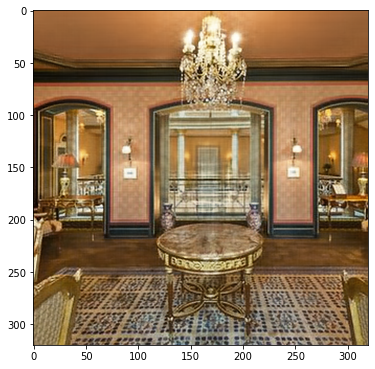

Iteracion 03601    Perdida 0.000374 

Iteracion 03602    Perdida 0.000366 

Iteracion 03603    Perdida 0.000369 

Iteracion 03604    Perdida 0.000365 

Iteracion 03605    Perdida 0.000367 

Iteracion 03606    Perdida 0.000397 

Iteracion 03607    Perdida 0.000443 

Iteracion 03608    Perdida 0.000498 

Iteracion 03609    Perdida 0.000546 

Iteracion 03610    Perdida 0.000543 

Iteracion 03611    Perdida 0.000490 

Iteracion 03612    Perdida 0.000415 

Iteracion 03613    Perdida 0.000378 

Iteracion 03614    Perdida 0.000410 

Iteracion 03615    Perdida 0.000417 

Iteracion 03616    Perdida 0.000384 

Iteracion 03617    Perdida 0.000363 

Iteracion 03618    Perdida 0.000388 

Iteracion 03619    Perdida 0.000387 

Iteracion 03620    Perdida 0.000364 

Iteracion 03621    Perdida 0.000359 

Iteracion 03622    Perdida 0.000370 

Iteracion 03623    Perdida 0.000352 

Iteracion 03624    Perdida 0.000343 

Iteracion 03625    Perdida 0.000344 

Iteracion 03626    Perdida 0.000341 

Iteracion 03

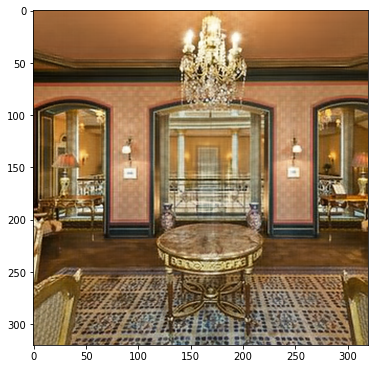

Iteracion 03651    Perdida 0.000368 

Iteracion 03652    Perdida 0.000338 

Iteracion 03653    Perdida 0.000343 

Iteracion 03654    Perdida 0.000368 

Iteracion 03655    Perdida 0.000355 

Iteracion 03656    Perdida 0.000320 

Iteracion 03657    Perdida 0.000331 

Iteracion 03658    Perdida 0.000345 

Iteracion 03659    Perdida 0.000341 

Iteracion 03660    Perdida 0.000331 

Iteracion 03661    Perdida 0.000324 

Iteracion 03662    Perdida 0.000323 

Iteracion 03663    Perdida 0.000323 

Iteracion 03664    Perdida 0.000326 

Iteracion 03665    Perdida 0.000327 

Iteracion 03666    Perdida 0.000328 

Iteracion 03667    Perdida 0.000330 

Iteracion 03668    Perdida 0.000333 

Iteracion 03669    Perdida 0.000343 

Iteracion 03670    Perdida 0.000370 

Iteracion 03671    Perdida 0.000409 

Iteracion 03672    Perdida 0.000470 

Iteracion 03673    Perdida 0.000529 

Iteracion 03674    Perdida 0.000597 

Iteracion 03675    Perdida 0.000588 

Iteracion 03676    Perdida 0.000503 

Iteracion 03

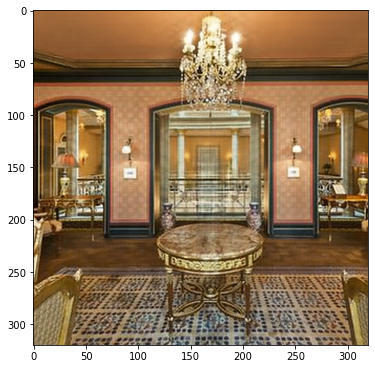

Iteracion 03701    Perdida 0.000307 

Iteracion 03702    Perdida 0.000306 

Iteracion 03703    Perdida 0.000310 

Iteracion 03704    Perdida 0.000305 

Iteracion 03705    Perdida 0.000307 

Iteracion 03706    Perdida 0.000305 

Iteracion 03707    Perdida 0.000308 

Iteracion 03708    Perdida 0.000305 

Iteracion 03709    Perdida 0.000303 

Iteracion 03710    Perdida 0.000301 

Iteracion 03711    Perdida 0.000303 

Iteracion 03712    Perdida 0.000311 

Iteracion 03713    Perdida 0.000309 

Iteracion 03714    Perdida 0.000313 

Iteracion 03715    Perdida 0.000322 

Iteracion 03716    Perdida 0.000331 

Iteracion 03717    Perdida 0.000344 

Iteracion 03718    Perdida 0.000354 

Iteracion 03719    Perdida 0.000353 

Iteracion 03720    Perdida 0.000342 

Iteracion 03721    Perdida 0.000315 

Iteracion 03722    Perdida 0.000307 

Iteracion 03723    Perdida 0.000327 

Iteracion 03724    Perdida 0.000356 

Iteracion 03725    Perdida 0.000382 

Iteracion 03726    Perdida 0.000405 

Iteracion 03

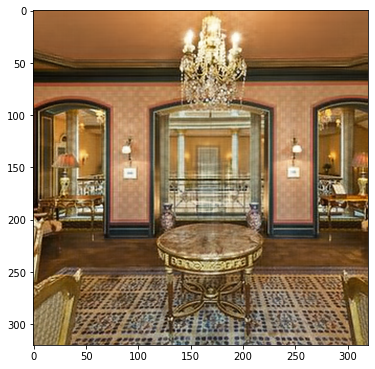

Iteracion 03751    Perdida 0.000327 

Iteracion 03752    Perdida 0.000338 

Iteracion 03753    Perdida 0.000343 

Iteracion 03754    Perdida 0.000350 

Iteracion 03755    Perdida 0.000342 

Iteracion 03756    Perdida 0.000350 

Iteracion 03757    Perdida 0.000355 

Iteracion 03758    Perdida 0.000359 

Iteracion 03759    Perdida 0.000345 

Iteracion 03760    Perdida 0.000308 

Iteracion 03761    Perdida 0.000299 

Iteracion 03762    Perdida 0.000314 

Iteracion 03763    Perdida 0.000328 

Iteracion 03764    Perdida 0.000330 

Iteracion 03765    Perdida 0.000315 

Iteracion 03766    Perdida 0.000295 

Iteracion 03767    Perdida 0.000302 

Iteracion 03768    Perdida 0.000313 

Iteracion 03769    Perdida 0.000300 

Iteracion 03770    Perdida 0.000309 

Iteracion 03771    Perdida 0.000331 

Iteracion 03772    Perdida 0.000350 

Iteracion 03773    Perdida 0.000385 

Iteracion 03774    Perdida 0.000418 

Iteracion 03775    Perdida 0.000429 

Iteracion 03776    Perdida 0.000411 

Iteracion 03

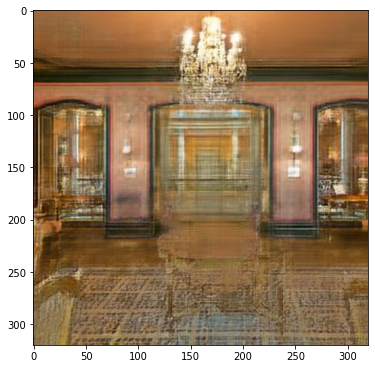

Iteracion 03801    Perdida 0.008115 

Iteracion 03802    Perdida 0.007571 

Iteracion 03803    Perdida 0.006812 

Iteracion 03804    Perdida 0.007027 

Iteracion 03805    Perdida 0.006157 

Iteracion 03806    Perdida 0.005969 

Iteracion 03807    Perdida 0.005661 

Iteracion 03808    Perdida 0.005158 

Iteracion 03809    Perdida 0.004883 

Iteracion 03810    Perdida 0.004597 

Iteracion 03811    Perdida 0.004277 

Iteracion 03812    Perdida 0.004092 

Iteracion 03813    Perdida 0.003851 

Iteracion 03814    Perdida 0.003628 

Iteracion 03815    Perdida 0.003422 

Iteracion 03816    Perdida 0.003270 

Iteracion 03817    Perdida 0.003103 

Iteracion 03818    Perdida 0.002957 

Iteracion 03819    Perdida 0.002821 

Iteracion 03820    Perdida 0.002674 

Iteracion 03821    Perdida 0.002572 

Iteracion 03822    Perdida 0.002483 

Iteracion 03823    Perdida 0.002361 

Iteracion 03824    Perdida 0.002266 

Iteracion 03825    Perdida 0.002167 

Iteracion 03826    Perdida 0.002091 

Iteracion 03

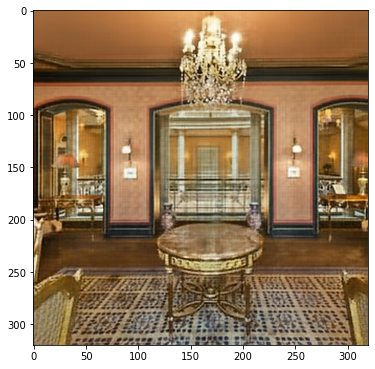

Iteracion 03851    Perdida 0.001005 

Iteracion 03852    Perdida 0.000983 

Iteracion 03853    Perdida 0.000964 

Iteracion 03854    Perdida 0.000949 

Iteracion 03855    Perdida 0.000929 

Iteracion 03856    Perdida 0.000913 

Iteracion 03857    Perdida 0.000895 

Iteracion 03858    Perdida 0.000885 

Iteracion 03859    Perdida 0.000866 

Iteracion 03860    Perdida 0.000850 

Iteracion 03861    Perdida 0.000836 

Iteracion 03862    Perdida 0.000821 

Iteracion 03863    Perdida 0.000806 

Iteracion 03864    Perdida 0.000795 

Iteracion 03865    Perdida 0.000782 

Iteracion 03866    Perdida 0.000772 

Iteracion 03867    Perdida 0.000758 

Iteracion 03868    Perdida 0.000748 

Iteracion 03869    Perdida 0.000735 

Iteracion 03870    Perdida 0.000728 

Iteracion 03871    Perdida 0.000716 

Iteracion 03872    Perdida 0.000708 

Iteracion 03873    Perdida 0.000696 

Iteracion 03874    Perdida 0.000687 

Iteracion 03875    Perdida 0.000678 

Iteracion 03876    Perdida 0.000672 

Iteracion 03

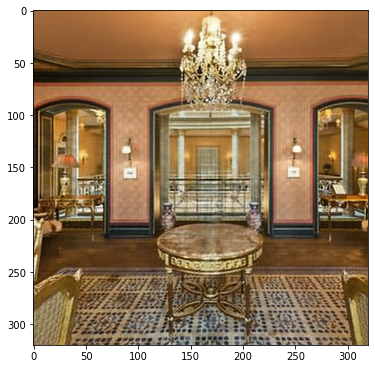

Iteracion 03901    Perdida 0.000539 

Iteracion 03902    Perdida 0.000545 

Iteracion 03903    Perdida 0.000541 

Iteracion 03904    Perdida 0.000553 

Iteracion 03905    Perdida 0.000584 

Iteracion 03906    Perdida 0.000615 

Iteracion 03907    Perdida 0.000655 

Iteracion 03908    Perdida 0.000670 

Iteracion 03909    Perdida 0.000632 

Iteracion 03910    Perdida 0.000553 

Iteracion 03911    Perdida 0.000518 

Iteracion 03912    Perdida 0.000543 

Iteracion 03913    Perdida 0.000569 

Iteracion 03914    Perdida 0.000539 

Iteracion 03915    Perdida 0.000508 

Iteracion 03916    Perdida 0.000516 

Iteracion 03917    Perdida 0.000521 

Iteracion 03918    Perdida 0.000506 

Iteracion 03919    Perdida 0.000497 

Iteracion 03920    Perdida 0.000489 

Iteracion 03921    Perdida 0.000498 

Iteracion 03922    Perdida 0.000498 

Iteracion 03923    Perdida 0.000492 

Iteracion 03924    Perdida 0.000480 

Iteracion 03925    Perdida 0.000471 

Iteracion 03926    Perdida 0.000476 

Iteracion 03

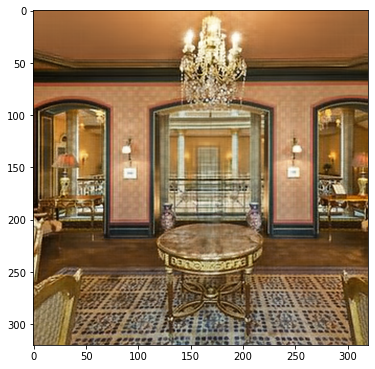

Iteracion 03951    Perdida 0.000475 

Iteracion 03952    Perdida 0.000515 

Iteracion 03953    Perdida 0.000534 

Iteracion 03954    Perdida 0.000550 

Iteracion 03955    Perdida 0.000482 

Iteracion 03956    Perdida 0.000431 

Iteracion 03957    Perdida 0.000423 

Iteracion 03958    Perdida 0.000449 

Iteracion 03959    Perdida 0.000466 

Iteracion 03960    Perdida 0.000452 

Iteracion 03961    Perdida 0.000440 

Iteracion 03962    Perdida 0.000440 

Iteracion 03963    Perdida 0.000446 

Iteracion 03964    Perdida 0.000435 

Iteracion 03965    Perdida 0.000418 

Iteracion 03966    Perdida 0.000416 

Iteracion 03967    Perdida 0.000415 

Iteracion 03968    Perdida 0.000418 

Iteracion 03969    Perdida 0.000422 

Iteracion 03970    Perdida 0.000399 

Iteracion 03971    Perdida 0.000405 

Iteracion 03972    Perdida 0.000400 

Iteracion 03973    Perdida 0.000399 

Iteracion 03974    Perdida 0.000393 

Iteracion 03975    Perdida 0.000386 

Iteracion 03976    Perdida 0.000383 

Iteracion 03

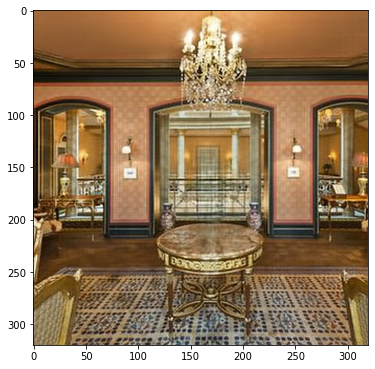

Iteracion 04001    Perdida 0.000396 

Iteracion 04002    Perdida 0.000402 

Iteracion 04003    Perdida 0.000405 

Iteracion 04004    Perdida 0.000408 

Iteracion 04005    Perdida 0.000410 

Iteracion 04006    Perdida 0.000404 

Iteracion 04007    Perdida 0.000396 

Iteracion 04008    Perdida 0.000383 

Iteracion 04009    Perdida 0.000358 

Iteracion 04010    Perdida 0.000353 

Iteracion 04011    Perdida 0.000357 

Iteracion 04012    Perdida 0.000354 

Iteracion 04013    Perdida 0.000364 

Iteracion 04014    Perdida 0.000363 

Iteracion 04015    Perdida 0.000351 

Iteracion 04016    Perdida 0.000349 

Iteracion 04017    Perdida 0.000344 

Iteracion 04018    Perdida 0.000336 

Iteracion 04019    Perdida 0.000344 

Iteracion 04020    Perdida 0.000348 

Iteracion 04021    Perdida 0.000350 

Iteracion 04022    Perdida 0.000348 

Iteracion 04023    Perdida 0.000347 

Iteracion 04024    Perdida 0.000341 

Iteracion 04025    Perdida 0.000341 

Iteracion 04026    Perdida 0.000336 

Iteracion 04

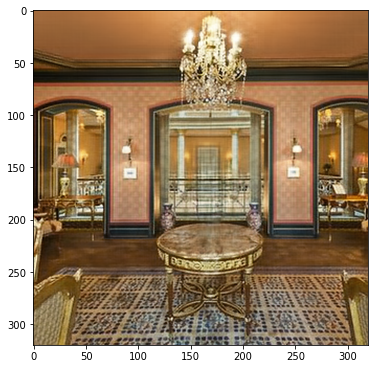

Iteracion 04051    Perdida 0.000327 

Iteracion 04052    Perdida 0.000332 

Iteracion 04053    Perdida 0.000334 

Iteracion 04054    Perdida 0.000336 

Iteracion 04055    Perdida 0.000335 

Iteracion 04056    Perdida 0.000338 

Iteracion 04057    Perdida 0.000356 

Iteracion 04058    Perdida 0.000372 

Iteracion 04059    Perdida 0.000390 

Iteracion 04060    Perdida 0.000390 

Iteracion 04061    Perdida 0.000387 

Iteracion 04062    Perdida 0.000378 

Iteracion 04063    Perdida 0.000357 

Iteracion 04064    Perdida 0.000338 

Iteracion 04065    Perdida 0.000335 

Iteracion 04066    Perdida 0.000340 

Iteracion 04067    Perdida 0.000330 

Iteracion 04068    Perdida 0.000322 

Iteracion 04069    Perdida 0.000327 

Iteracion 04070    Perdida 0.000332 

Iteracion 04071    Perdida 0.000324 

Iteracion 04072    Perdida 0.000314 

Iteracion 04073    Perdida 0.000307 

Iteracion 04074    Perdida 0.000311 

Iteracion 04075    Perdida 0.000313 

Iteracion 04076    Perdida 0.000319 

Iteracion 04

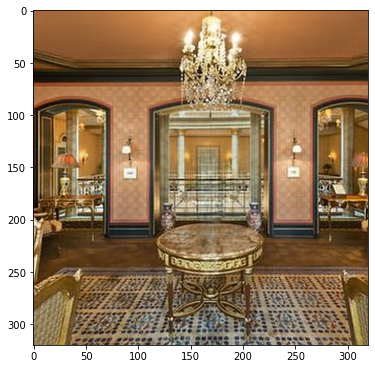

Iteracion 04101    Perdida 0.000293 

Iteracion 04102    Perdida 0.000297 

Iteracion 04103    Perdida 0.000303 

Iteracion 04104    Perdida 0.000312 

Iteracion 04105    Perdida 0.000327 

Iteracion 04106    Perdida 0.000338 

Iteracion 04107    Perdida 0.000367 

Iteracion 04108    Perdida 0.000382 

Iteracion 04109    Perdida 0.000369 

Iteracion 04110    Perdida 0.000347 

Iteracion 04111    Perdida 0.000337 

Iteracion 04112    Perdida 0.000350 

Iteracion 04113    Perdida 0.000375 

Iteracion 04114    Perdida 0.000360 

Iteracion 04115    Perdida 0.000339 

Iteracion 04116    Perdida 0.000336 

Iteracion 04117    Perdida 0.000339 

Iteracion 04118    Perdida 0.000342 

Iteracion 04119    Perdida 0.000343 

Iteracion 04120    Perdida 0.000356 

Iteracion 04121    Perdida 0.000368 

Iteracion 04122    Perdida 0.000356 

Iteracion 04123    Perdida 0.000334 

Iteracion 04124    Perdida 0.000332 

Iteracion 04125    Perdida 0.000325 

Iteracion 04126    Perdida 0.000303 

Iteracion 04

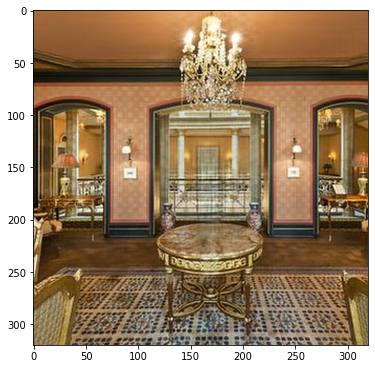

Iteracion 04151    Perdida 0.000288 

Iteracion 04152    Perdida 0.000287 

Iteracion 04153    Perdida 0.000296 

Iteracion 04154    Perdida 0.000306 

Iteracion 04155    Perdida 0.000300 

Iteracion 04156    Perdida 0.000308 

Iteracion 04157    Perdida 0.000302 

Iteracion 04158    Perdida 0.000297 

Iteracion 04159    Perdida 0.000295 

Iteracion 04160    Perdida 0.000299 

Iteracion 04161    Perdida 0.000300 

Iteracion 04162    Perdida 0.000298 

Iteracion 04163    Perdida 0.000293 

Iteracion 04164    Perdida 0.000295 

Iteracion 04165    Perdida 0.000296 

Iteracion 04166    Perdida 0.000301 

Iteracion 04167    Perdida 0.000305 

Iteracion 04168    Perdida 0.000303 

Iteracion 04169    Perdida 0.000315 

Iteracion 04170    Perdida 0.000316 

Iteracion 04171    Perdida 0.000327 

Iteracion 04172    Perdida 0.000337 

Iteracion 04173    Perdida 0.000329 

Iteracion 04174    Perdida 0.000341 

Iteracion 04175    Perdida 0.000343 

Iteracion 04176    Perdida 0.000359 

Iteracion 04

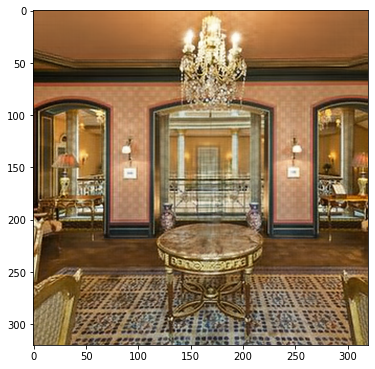

Iteracion 04201    Perdida 0.000267 

Iteracion 04202    Perdida 0.000268 

Iteracion 04203    Perdida 0.000280 

Iteracion 04204    Perdida 0.000288 

Iteracion 04205    Perdida 0.000294 

Iteracion 04206    Perdida 0.000308 

Iteracion 04207    Perdida 0.000309 

Iteracion 04208    Perdida 0.000304 

Iteracion 04209    Perdida 0.000293 

Iteracion 04210    Perdida 0.000287 

Iteracion 04211    Perdida 0.000290 

Iteracion 04212    Perdida 0.000310 

Iteracion 04213    Perdida 0.000333 

Iteracion 04214    Perdida 0.000334 

Iteracion 04215    Perdida 0.000319 

Iteracion 04216    Perdida 0.000300 

Iteracion 04217    Perdida 0.000298 

Iteracion 04218    Perdida 0.000301 

Iteracion 04219    Perdida 0.000296 

Iteracion 04220    Perdida 0.000283 

Iteracion 04221    Perdida 0.000266 

Iteracion 04222    Perdida 0.000267 

Iteracion 04223    Perdida 0.000273 

Iteracion 04224    Perdida 0.000269 

Iteracion 04225    Perdida 0.000258 

Iteracion 04226    Perdida 0.000250 

Iteracion 04

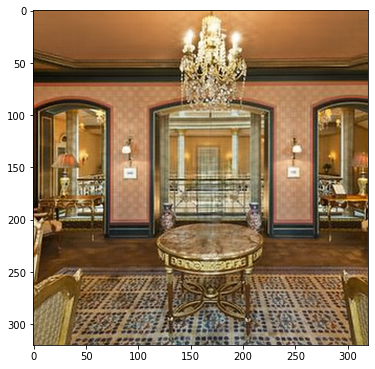

Iteracion 04251    Perdida 0.000276 

Iteracion 04252    Perdida 0.000267 

Iteracion 04253    Perdida 0.000266 

Iteracion 04254    Perdida 0.000276 

Iteracion 04255    Perdida 0.000283 

Iteracion 04256    Perdida 0.000298 

Iteracion 04257    Perdida 0.000313 

Iteracion 04258    Perdida 0.000346 

Iteracion 04259    Perdida 0.000367 

Iteracion 04260    Perdida 0.000371 

Iteracion 04261    Perdida 0.000346 

Iteracion 04262    Perdida 0.000312 

Iteracion 04263    Perdida 0.000275 

Iteracion 04264    Perdida 0.000263 

Iteracion 04265    Perdida 0.000279 

Iteracion 04266    Perdida 0.000280 

Iteracion 04267    Perdida 0.000270 

Iteracion 04268    Perdida 0.000260 

Iteracion 04269    Perdida 0.000255 

Iteracion 04270    Perdida 0.000258 

Iteracion 04271    Perdida 0.000247 

Iteracion 04272    Perdida 0.000241 

Iteracion 04273    Perdida 0.000243 

Iteracion 04274    Perdida 0.000238 

Iteracion 04275    Perdida 0.000232 

Iteracion 04276    Perdida 0.000239 

Iteracion 04

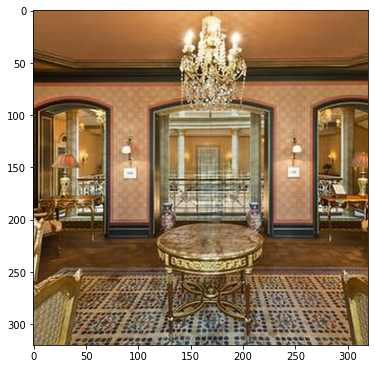

Iteracion 04301    Perdida 0.000257 

Iteracion 04302    Perdida 0.000257 

Iteracion 04303    Perdida 0.000256 

Iteracion 04304    Perdida 0.000240 

Iteracion 04305    Perdida 0.000232 

Iteracion 04306    Perdida 0.000244 

Iteracion 04307    Perdida 0.000263 

Iteracion 04308    Perdida 0.000280 

Iteracion 04309    Perdida 0.000285 

Iteracion 04310    Perdida 0.000298 

Iteracion 04311    Perdida 0.000297 

Iteracion 04312    Perdida 0.000298 

Iteracion 04313    Perdida 0.000291 

Iteracion 04314    Perdida 0.000295 

Iteracion 04315    Perdida 0.000283 

Iteracion 04316    Perdida 0.000275 

Iteracion 04317    Perdida 0.000272 

Iteracion 04318    Perdida 0.000280 

Iteracion 04319    Perdida 0.000302 

Iteracion 04320    Perdida 0.000281 

Iteracion 04321    Perdida 0.000256 

Iteracion 04322    Perdida 0.000249 

Iteracion 04323    Perdida 0.000266 

Iteracion 04324    Perdida 0.000252 

Iteracion 04325    Perdida 0.000236 

Iteracion 04326    Perdida 0.000240 

Iteracion 04

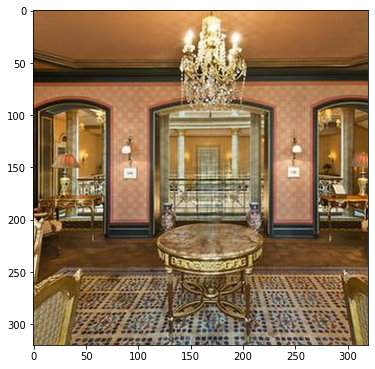

Iteracion 04351    Perdida 0.000248 

Iteracion 04352    Perdida 0.000253 

Iteracion 04353    Perdida 0.000248 

Iteracion 04354    Perdida 0.000248 

Iteracion 04355    Perdida 0.000256 

Iteracion 04356    Perdida 0.000253 

Iteracion 04357    Perdida 0.000259 

Iteracion 04358    Perdida 0.000257 

Iteracion 04359    Perdida 0.000249 

Iteracion 04360    Perdida 0.000248 

Iteracion 04361    Perdida 0.000248 

Iteracion 04362    Perdida 0.000240 

Iteracion 04363    Perdida 0.000243 

Iteracion 04364    Perdida 0.000237 

Iteracion 04365    Perdida 0.000236 

Iteracion 04366    Perdida 0.000235 

Iteracion 04367    Perdida 0.000228 

Iteracion 04368    Perdida 0.000234 

Iteracion 04369    Perdida 0.000236 

Iteracion 04370    Perdida 0.000246 

Iteracion 04371    Perdida 0.000258 

Iteracion 04372    Perdida 0.000276 

Iteracion 04373    Perdida 0.000289 

Iteracion 04374    Perdida 0.000286 

Iteracion 04375    Perdida 0.000287 

Iteracion 04376    Perdida 0.000276 

Iteracion 04

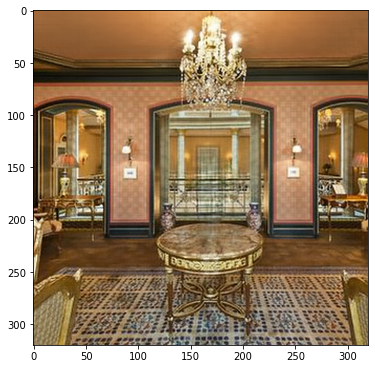

Iteracion 04401    Perdida 0.000352 

Iteracion 04402    Perdida 0.000339 

Iteracion 04403    Perdida 0.000319 

Iteracion 04404    Perdida 0.000303 

Iteracion 04405    Perdida 0.000296 

Iteracion 04406    Perdida 0.000294 

Iteracion 04407    Perdida 0.000289 

Iteracion 04408    Perdida 0.000282 

Iteracion 04409    Perdida 0.000269 

Iteracion 04410    Perdida 0.000255 

Iteracion 04411    Perdida 0.000247 

Iteracion 04412    Perdida 0.000242 

Iteracion 04413    Perdida 0.000240 

Iteracion 04414    Perdida 0.000242 

Iteracion 04415    Perdida 0.000231 

Iteracion 04416    Perdida 0.000218 

Iteracion 04417    Perdida 0.000225 

Iteracion 04418    Perdida 0.000226 

Iteracion 04419    Perdida 0.000214 

Iteracion 04420    Perdida 0.000212 

Iteracion 04421    Perdida 0.000215 

Iteracion 04422    Perdida 0.000211 

Iteracion 04423    Perdida 0.000207 

Iteracion 04424    Perdida 0.000206 

Iteracion 04425    Perdida 0.000210 

Iteracion 04426    Perdida 0.000206 

Iteracion 04

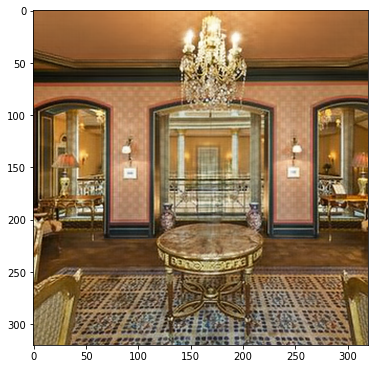

Iteracion 04451    Perdida 0.000243 

Iteracion 04452    Perdida 0.000239 

Iteracion 04453    Perdida 0.000230 

Iteracion 04454    Perdida 0.000225 

Iteracion 04455    Perdida 0.000227 

Iteracion 04456    Perdida 0.000228 

Iteracion 04457    Perdida 0.000220 

Iteracion 04458    Perdida 0.000214 

Iteracion 04459    Perdida 0.000216 

Iteracion 04460    Perdida 0.000222 

Iteracion 04461    Perdida 0.000224 

Iteracion 04462    Perdida 0.000223 

Iteracion 04463    Perdida 0.000221 

Iteracion 04464    Perdida 0.000235 

Iteracion 04465    Perdida 0.000240 

Iteracion 04466    Perdida 0.000241 

Iteracion 04467    Perdida 0.000232 

Iteracion 04468    Perdida 0.000226 

Iteracion 04469    Perdida 0.000221 

Iteracion 04470    Perdida 0.000221 

Iteracion 04471    Perdida 0.000212 

Iteracion 04472    Perdida 0.000205 

Iteracion 04473    Perdida 0.000199 

Iteracion 04474    Perdida 0.000200 

Iteracion 04475    Perdida 0.000202 

Iteracion 04476    Perdida 0.000200 

Iteracion 04

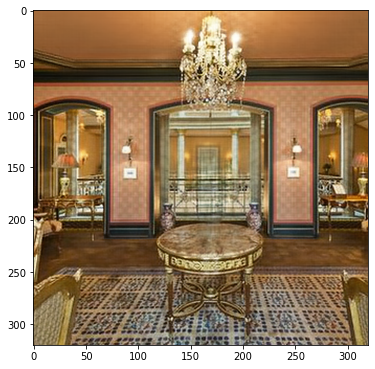

Iteracion 04501    Perdida 0.000276 

Iteracion 04502    Perdida 0.000316 

Iteracion 04503    Perdida 0.000320 

Iteracion 04504    Perdida 0.000263 

Iteracion 04505    Perdida 0.000245 

Iteracion 04506    Perdida 0.000261 

Iteracion 04507    Perdida 0.000259 

Iteracion 04508    Perdida 0.000227 

Iteracion 04509    Perdida 0.000216 

Iteracion 04510    Perdida 0.000241 

Iteracion 04511    Perdida 0.000237 

Iteracion 04512    Perdida 0.000210 

Iteracion 04513    Perdida 0.000222 

Iteracion 04514    Perdida 0.000235 

Iteracion 04515    Perdida 0.000208 

Iteracion 04516    Perdida 0.000212 

Iteracion 04517    Perdida 0.000219 

Iteracion 04518    Perdida 0.000209 

Iteracion 04519    Perdida 0.000201 

Iteracion 04520    Perdida 0.000203 

Iteracion 04521    Perdida 0.000208 

Iteracion 04522    Perdida 0.000200 

Iteracion 04523    Perdida 0.000197 

Iteracion 04524    Perdida 0.000197 

Iteracion 04525    Perdida 0.000199 

Iteracion 04526    Perdida 0.000188 

Iteracion 04

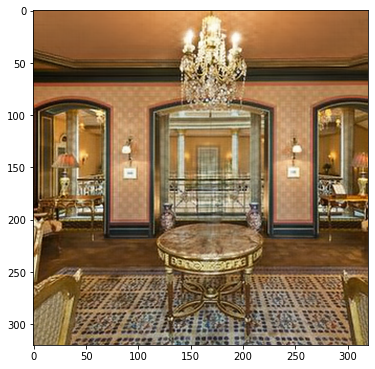

Iteracion 04551    Perdida 0.000266 

Iteracion 04552    Perdida 0.000267 

Iteracion 04553    Perdida 0.000252 

Iteracion 04554    Perdida 0.000246 

Iteracion 04555    Perdida 0.000254 

Iteracion 04556    Perdida 0.000247 

Iteracion 04557    Perdida 0.000251 

Iteracion 04558    Perdida 0.000244 

Iteracion 04559    Perdida 0.000225 

Iteracion 04560    Perdida 0.000208 

Iteracion 04561    Perdida 0.000199 

Iteracion 04562    Perdida 0.000202 

Iteracion 04563    Perdida 0.000201 

Iteracion 04564    Perdida 0.000191 

Iteracion 04565    Perdida 0.000188 

Iteracion 04566    Perdida 0.000198 

Iteracion 04567    Perdida 0.000191 

Iteracion 04568    Perdida 0.000187 

Iteracion 04569    Perdida 0.000189 

Iteracion 04570    Perdida 0.000188 

Iteracion 04571    Perdida 0.000182 

Iteracion 04572    Perdida 0.000185 

Iteracion 04573    Perdida 0.000184 

Iteracion 04574    Perdida 0.000179 

Iteracion 04575    Perdida 0.000180 

Iteracion 04576    Perdida 0.000186 

Iteracion 04

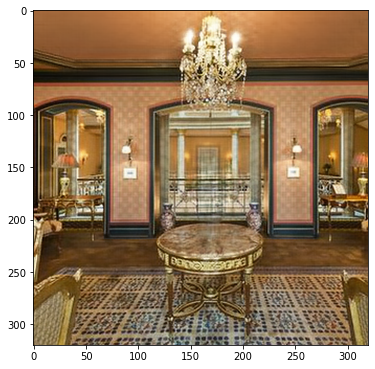

Iteracion 04601    Perdida 0.000196 

Iteracion 04602    Perdida 0.000188 

Iteracion 04603    Perdida 0.000193 

Iteracion 04604    Perdida 0.000198 

Iteracion 04605    Perdida 0.000193 

Iteracion 04606    Perdida 0.000194 

Iteracion 04607    Perdida 0.000197 

Iteracion 04608    Perdida 0.000195 

Iteracion 04609    Perdida 0.000193 

Iteracion 04610    Perdida 0.000193 

Iteracion 04611    Perdida 0.000187 

Iteracion 04612    Perdida 0.000182 

Iteracion 04613    Perdida 0.000180 

Iteracion 04614    Perdida 0.000176 

Iteracion 04615    Perdida 0.000175 

Iteracion 04616    Perdida 0.000181 

Iteracion 04617    Perdida 0.000180 

Iteracion 04618    Perdida 0.000178 

Iteracion 04619    Perdida 0.000179 

Iteracion 04620    Perdida 0.000182 

Iteracion 04621    Perdida 0.000186 

Iteracion 04622    Perdida 0.000199 

Iteracion 04623    Perdida 0.000219 

Iteracion 04624    Perdida 0.000244 

Iteracion 04625    Perdida 0.000252 

Iteracion 04626    Perdida 0.000257 

Iteracion 04

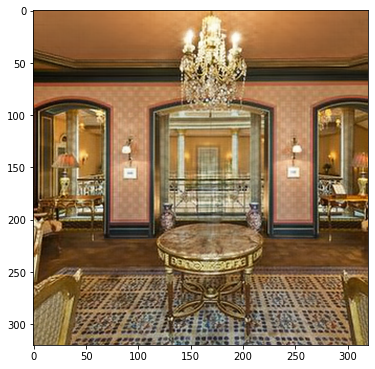

Iteracion 04651    Perdida 0.000183 

Iteracion 04652    Perdida 0.000180 

Iteracion 04653    Perdida 0.000178 

Iteracion 04654    Perdida 0.000181 

Iteracion 04655    Perdida 0.000175 

Iteracion 04656    Perdida 0.000171 

Iteracion 04657    Perdida 0.000172 

Iteracion 04658    Perdida 0.000169 

Iteracion 04659    Perdida 0.000169 

Iteracion 04660    Perdida 0.000169 

Iteracion 04661    Perdida 0.000171 

Iteracion 04662    Perdida 0.000176 

Iteracion 04663    Perdida 0.000182 

Iteracion 04664    Perdida 0.000190 

Iteracion 04665    Perdida 0.000200 

Iteracion 04666    Perdida 0.000219 

Iteracion 04667    Perdida 0.000235 

Iteracion 04668    Perdida 0.000237 

Iteracion 04669    Perdida 0.000231 

Iteracion 04670    Perdida 0.000224 

Iteracion 04671    Perdida 0.000234 

Iteracion 04672    Perdida 0.000243 

Iteracion 04673    Perdida 0.000247 

Iteracion 04674    Perdida 0.000213 

Iteracion 04675    Perdida 0.000190 

Iteracion 04676    Perdida 0.000189 

Iteracion 04

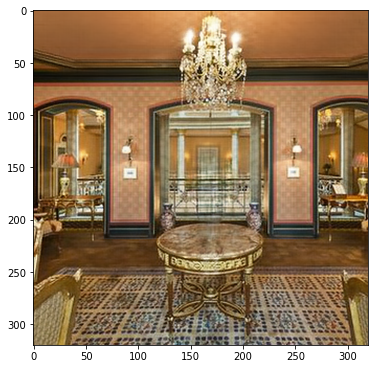

Iteracion 04701    Perdida 0.000225 

Iteracion 04702    Perdida 0.000203 

Iteracion 04703    Perdida 0.000203 

Iteracion 04704    Perdida 0.000211 

Iteracion 04705    Perdida 0.000194 

Iteracion 04706    Perdida 0.000197 

Iteracion 04707    Perdida 0.000206 

Iteracion 04708    Perdida 0.000185 

Iteracion 04709    Perdida 0.000184 

Iteracion 04710    Perdida 0.000184 

Iteracion 04711    Perdida 0.000174 

Iteracion 04712    Perdida 0.000175 

Iteracion 04713    Perdida 0.000171 

Iteracion 04714    Perdida 0.000170 

Iteracion 04715    Perdida 0.000167 

Iteracion 04716    Perdida 0.000169 

Iteracion 04717    Perdida 0.000164 

Iteracion 04718    Perdida 0.000164 

Iteracion 04719    Perdida 0.000164 

Iteracion 04720    Perdida 0.000162 

Iteracion 04721    Perdida 0.000166 

Iteracion 04722    Perdida 0.000164 

Iteracion 04723    Perdida 0.000167 

Iteracion 04724    Perdida 0.000170 

Iteracion 04725    Perdida 0.000178 

Iteracion 04726    Perdida 0.000189 

Iteracion 04

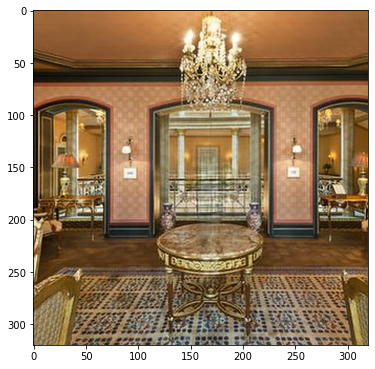

Iteracion 04751    Perdida 0.000172 

Iteracion 04752    Perdida 0.000177 

Iteracion 04753    Perdida 0.000187 

Iteracion 04754    Perdida 0.000199 

Iteracion 04755    Perdida 0.000219 

Iteracion 04756    Perdida 0.000242 

Iteracion 04757    Perdida 0.000262 

Iteracion 04758    Perdida 0.000264 

Iteracion 04759    Perdida 0.000236 

Iteracion 04760    Perdida 0.000214 

Iteracion 04761    Perdida 0.000200 

Iteracion 04762    Perdida 0.000203 

Iteracion 04763    Perdida 0.000217 

Iteracion 04764    Perdida 0.000219 

Iteracion 04765    Perdida 0.000212 

Iteracion 04766    Perdida 0.000189 

Iteracion 04767    Perdida 0.000190 

Iteracion 04768    Perdida 0.000200 

Iteracion 04769    Perdida 0.000194 

Iteracion 04770    Perdida 0.000180 

Iteracion 04771    Perdida 0.000177 

Iteracion 04772    Perdida 0.000184 

Iteracion 04773    Perdida 0.000180 

Iteracion 04774    Perdida 0.000178 

Iteracion 04775    Perdida 0.000175 

Iteracion 04776    Perdida 0.000176 

Iteracion 04

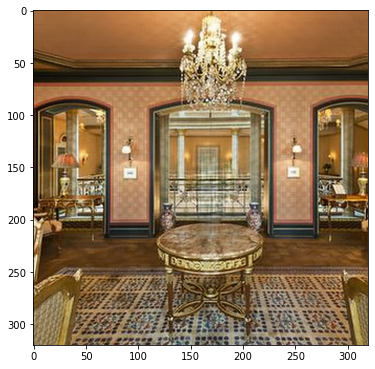

Iteracion 04801    Perdida 0.000190 

Iteracion 04802    Perdida 0.000205 

Iteracion 04803    Perdida 0.000226 

Iteracion 04804    Perdida 0.000250 

Iteracion 04805    Perdida 0.000257 

Iteracion 04806    Perdida 0.000251 

Iteracion 04807    Perdida 0.000233 

Iteracion 04808    Perdida 0.000219 

Iteracion 04809    Perdida 0.000229 

Iteracion 04810    Perdida 0.000242 

Iteracion 04811    Perdida 0.000231 

Iteracion 04812    Perdida 0.000203 

Iteracion 04813    Perdida 0.000196 

Iteracion 04814    Perdida 0.000210 

Iteracion 04815    Perdida 0.000211 

Iteracion 04816    Perdida 0.000212 

Iteracion 04817    Perdida 0.000221 

Iteracion 04818    Perdida 0.000234 

Iteracion 04819    Perdida 0.000250 

Iteracion 04820    Perdida 0.000259 

Iteracion 04821    Perdida 0.000274 

Iteracion 04822    Perdida 0.000296 

Iteracion 04823    Perdida 0.000301 

Iteracion 04824    Perdida 0.000265 

Iteracion 04825    Perdida 0.000257 

Iteracion 04826    Perdida 0.000237 

Iteracion 04

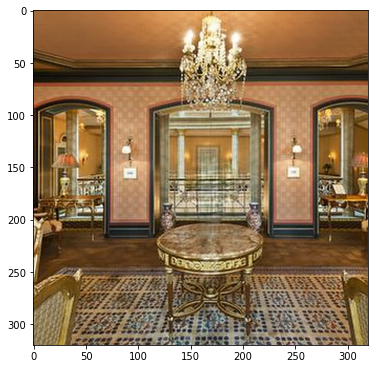

Iteracion 04851    Perdida 0.000149 

Iteracion 04852    Perdida 0.000148 

Iteracion 04853    Perdida 0.000146 

Iteracion 04854    Perdida 0.000145 

Iteracion 04855    Perdida 0.000148 

Iteracion 04856    Perdida 0.000150 

Iteracion 04857    Perdida 0.000157 

Iteracion 04858    Perdida 0.000163 

Iteracion 04859    Perdida 0.000180 

Iteracion 04860    Perdida 0.000208 

Iteracion 04861    Perdida 0.000240 

Iteracion 04862    Perdida 0.000285 

Iteracion 04863    Perdida 0.000315 

Iteracion 04864    Perdida 0.000317 

Iteracion 04865    Perdida 0.000268 

Iteracion 04866    Perdida 0.000230 

Iteracion 04867    Perdida 0.000229 

Iteracion 04868    Perdida 0.000254 

Iteracion 04869    Perdida 0.000261 

Iteracion 04870    Perdida 0.000262 

Iteracion 04871    Perdida 0.000255 

Iteracion 04872    Perdida 0.000237 

Iteracion 04873    Perdida 0.000226 

Iteracion 04874    Perdida 0.000220 

Iteracion 04875    Perdida 0.000202 

Iteracion 04876    Perdida 0.000191 

Iteracion 04

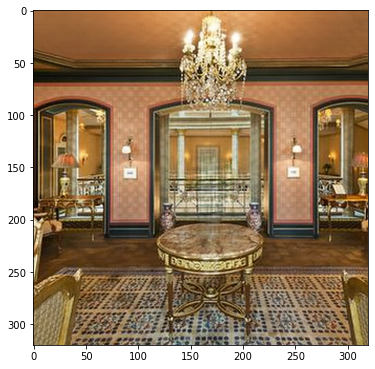

Iteracion 04901    Perdida 0.000177 

Iteracion 04902    Perdida 0.000192 

Iteracion 04903    Perdida 0.000208 

Iteracion 04904    Perdida 0.000224 

Iteracion 04905    Perdida 0.000240 

Iteracion 04906    Perdida 0.000264 

Iteracion 04907    Perdida 0.000286 

Iteracion 04908    Perdida 0.000341 

Iteracion 04909    Perdida 0.000323 

Iteracion 04910    Perdida 0.000276 

Iteracion 04911    Perdida 0.000227 

Iteracion 04912    Perdida 0.000227 

Iteracion 04913    Perdida 0.000247 

Iteracion 04914    Perdida 0.000216 

Iteracion 04915    Perdida 0.000195 

Iteracion 04916    Perdida 0.000197 

Iteracion 04917    Perdida 0.000210 

Iteracion 04918    Perdida 0.000201 

Iteracion 04919    Perdida 0.000184 

Iteracion 04920    Perdida 0.000185 

Iteracion 04921    Perdida 0.000191 

Iteracion 04922    Perdida 0.000179 

Iteracion 04923    Perdida 0.000179 

Iteracion 04924    Perdida 0.000180 

Iteracion 04925    Perdida 0.000169 

Iteracion 04926    Perdida 0.000166 

Iteracion 04

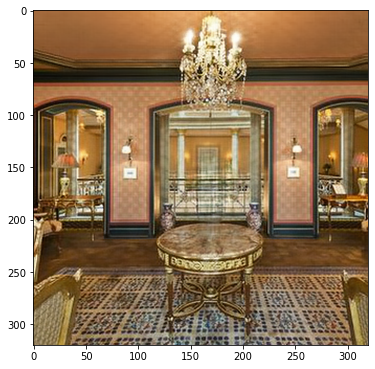

Iteracion 04951    Perdida 0.000164 

Iteracion 04952    Perdida 0.000173 

Iteracion 04953    Perdida 0.000177 

Iteracion 04954    Perdida 0.000187 

Iteracion 04955    Perdida 0.000196 

Iteracion 04956    Perdida 0.000212 

Iteracion 04957    Perdida 0.000217 

Iteracion 04958    Perdida 0.000203 

Iteracion 04959    Perdida 0.000179 

Iteracion 04960    Perdida 0.000160 

Iteracion 04961    Perdida 0.000158 

Iteracion 04962    Perdida 0.000167 

Iteracion 04963    Perdida 0.000172 

Iteracion 04964    Perdida 0.000168 

Iteracion 04965    Perdida 0.000162 

Iteracion 04966    Perdida 0.000154 

Iteracion 04967    Perdida 0.000155 

Iteracion 04968    Perdida 0.000157 

Iteracion 04969    Perdida 0.000152 

Iteracion 04970    Perdida 0.000147 

Iteracion 04971    Perdida 0.000144 

Iteracion 04972    Perdida 0.000145 

Iteracion 04973    Perdida 0.000146 

Iteracion 04974    Perdida 0.000147 

Iteracion 04975    Perdida 0.000143 

Iteracion 04976    Perdida 0.000142 

Iteracion 04

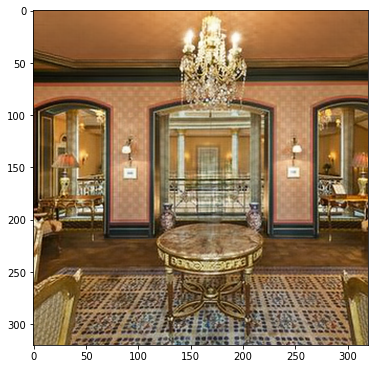

CPU times: user 4min 24s, sys: 1min 5s, total: 5min 29s
Wall time: 5min 34s


In [96]:
%%time
p = get_params(OPT_OVER, net, net_input)
total_loss_final, total_loss_item_final, psrn_final, psrn_masked_final  = optimize(OPTIMIZER, 
                                                                                   p, 
                                                                                   closureInpainting, 
                                                                                   LR, 
                                                                                   num_iter)

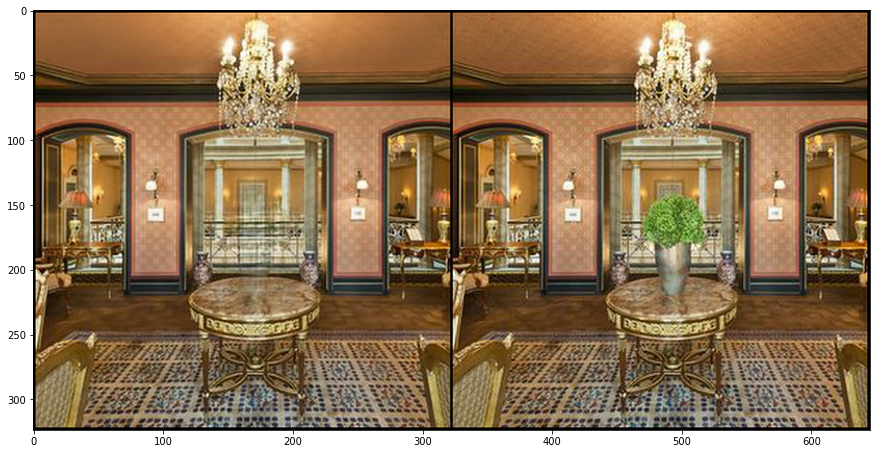

In [98]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), image_np], factor=13);

total_loss_item_final:  0.000174
Relación pico señal / ruido (PSNR):  29.039619
Relación pico señal / ruido (PSNR) [masked]:  37.583667
Error cuadrático medio (MSE):  0.000174 



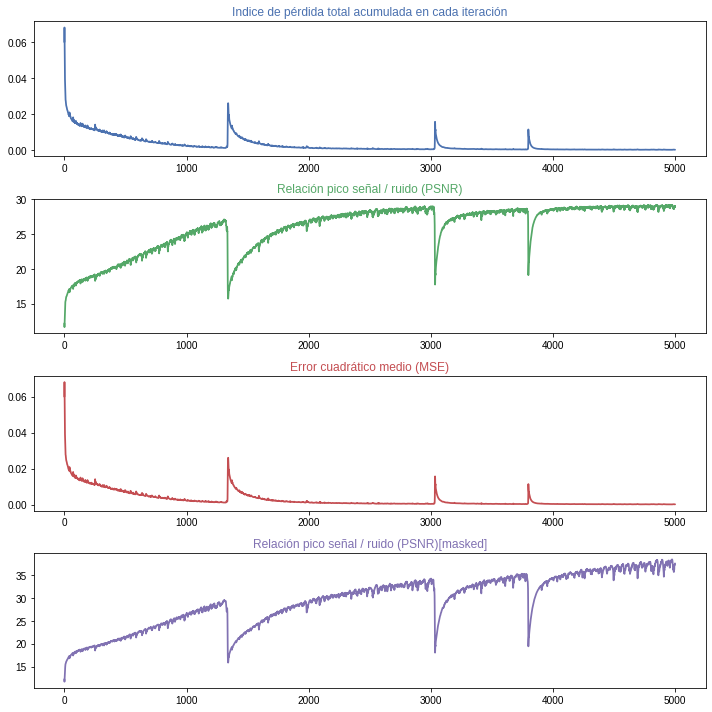

In [99]:
#total_loss_item_final, psrn_final, total_loss_final, psrn_masked_final
print("total_loss_item_final: ", "{0:.6f}".format(total_loss_item_final[len(total_loss_item_final)-1]))
print("Relación pico señal / ruido (PSNR): ", "{0:.6f}".format(psrn_final[len(psrn_final)-1]))
print("Relación pico señal / ruido (PSNR) [masked]: ", "{0:.6f}".format(psrn_masked_final[len(psrn_masked_final)-1]))
print("Error cuadrático medio (MSE): ", "{0:.6f}".format(total_loss_final[len(total_loss_final)-1]), "\n")

fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=4, figsize=(10,10))
mpl.style.use('seaborn')

ax1.set_title('Indice de pérdida total acumulada en cada iteración'.format('seaborn'), color='C0')
ax1.plot(total_loss_item_final, color='C0')

ax2.set_title('Relación pico señal / ruido (PSNR)'.format('seaborn'), color='C1')
ax2.plot(psrn_final, color='C1')

ax3.plot(total_loss_final, color='C2')
ax3.set_title('Error cuadrático medio (MSE)'.format('seaborn'), color='C2')

ax4.set_title('Relación pico señal / ruido (PSNR)[masked]'.format('seaborn'), color='C3')
ax4.plot(psrn_masked_final, color='C3')

plt.tight_layout()
plt.show()
plt.close()

mpl.rcParams.update(inline_rc)